# ECE 228 Unet (CVLab EPFL dataset)

# Python imports

In [1]:
import numpy as np
import os
import sys
from matplotlib import pyplot as plt
%matplotlib inline  

import torch
from torch import nn
from torch.autograd import Variable
from torchvision import transforms, utils
from skimage import io, transform
from skimage.color import rgb2gray

from models import * 
from train import *
from data_loader import * 

from scipy import ndimage

from matplotlib.colors import ListedColormap

# Load data

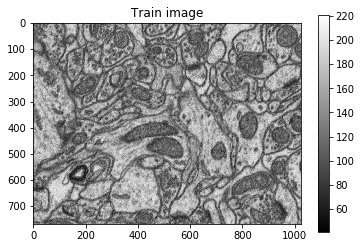

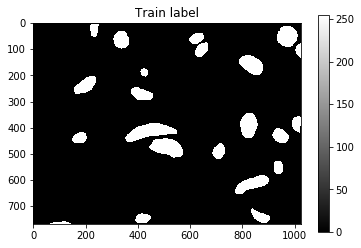

train_imgs shape =  (165, 1, 768, 1024)
train_labels shape =  (165, 1, 768, 1024)


In [2]:
from PIL import Image

data_tif = Image.open('datasets/epfl/training_epfl.tif')
train_imgs = []
i = 0
resize_size = 512

while True:
    try:
        data_tif.seek(i)
        train_imgs.append(np.array(data_tif))
        #train_imgs.append(transform.resize(np.array(data_tif),(resize_size,resize_size)))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_imgs = np.array(train_imgs)
train_imgs = np.expand_dims(train_imgs, axis=1)


label_tif = Image.open('datasets/epfl/training_epfl_lbl.tif')
train_labels = []
i = 0
while True:
    try:
        label_tif.seek(i)
        train_labels.append(np.array(label_tif))
        #train_labels.append(transform.resize(np.array(label_tif),(resize_size,resize_size)))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_labels = np.array(train_labels)
train_labels = np.expand_dims(train_labels, axis=1)

plt.imshow(np.squeeze(train_imgs[0]),cmap="gray")
plt.title("Train image")
plt.colorbar()
plt.show()

plt.imshow(np.squeeze(train_labels[0]), cmap="gray")
plt.title("Train label")
plt.colorbar()
plt.show()


#train_imgs = (train_imgs/127)-1
train_labels = (train_labels != 0).astype(np.uint8)


print("train_imgs shape = ",train_imgs.shape)
print("train_labels shape = ",train_labels.shape)




# Run Training

GPU is enabled 
80/20 training/validation split
total number of images =  165
training set size =  17
val_size =  148
y train shape =  (17, 768, 1024)
y train shape =  (148, 768, 1024)
training image from batch 0


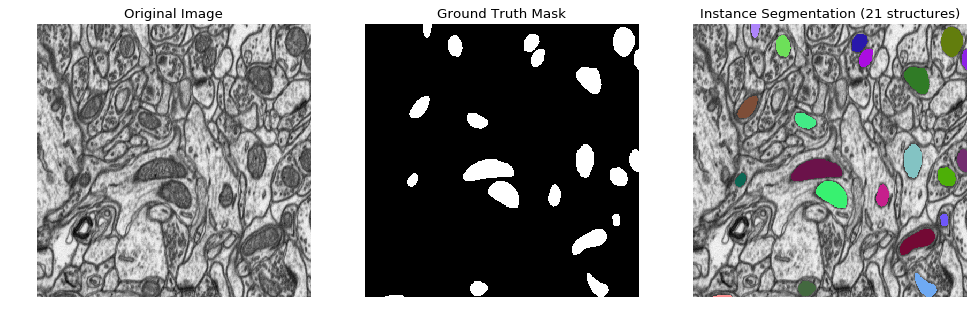

training image from batch 1


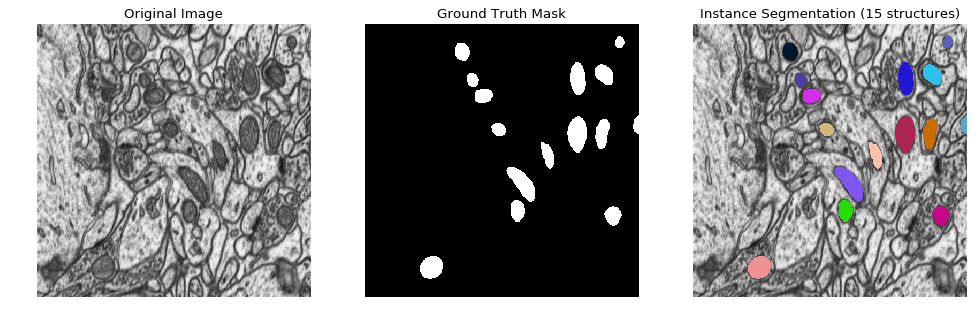

training image from batch 2


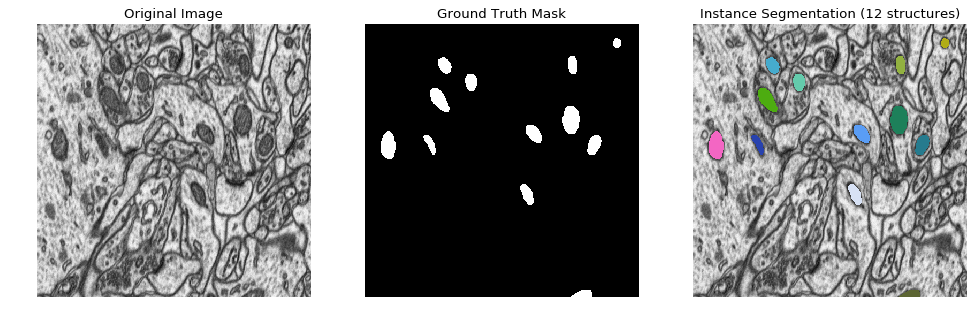

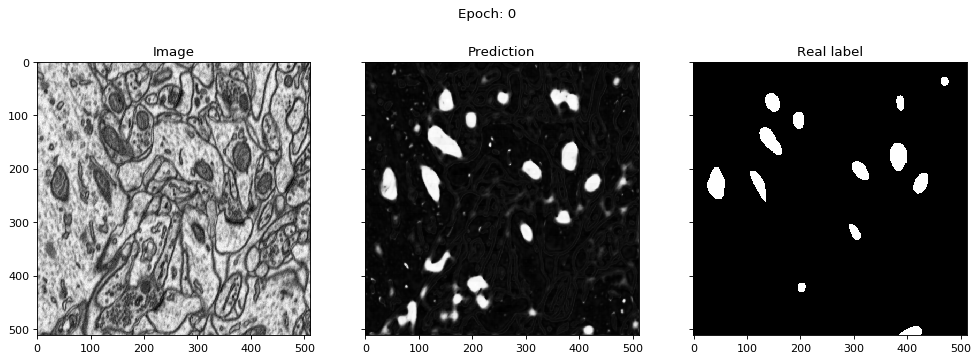

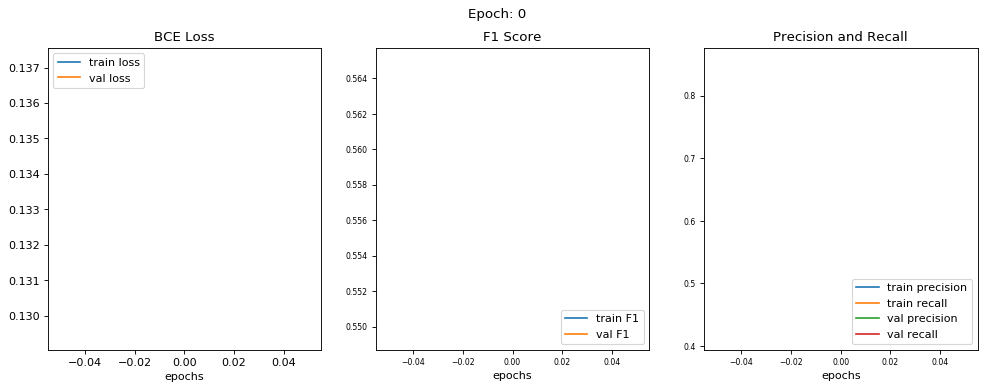

epoch [0/200] 
train loss = 0.1294, train f1 score = 0.5495 
train precision = 0.4160, train recall = 0.8546 

val loss = 0.1372, val f1 score = 0.5649 
val precision = 0.4366, val recall = 0.8382 




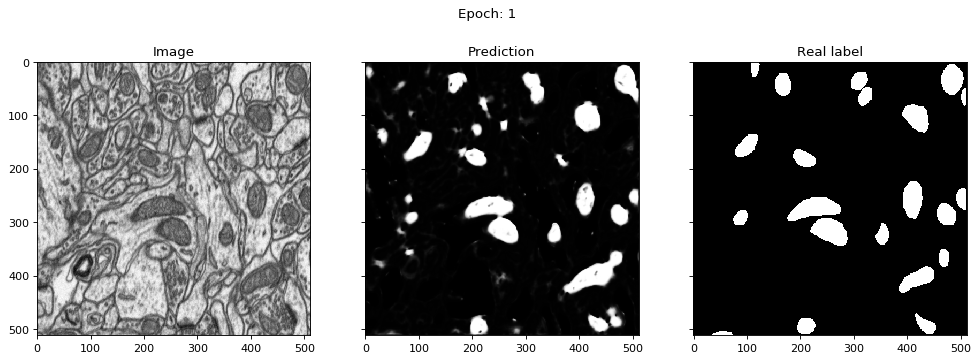

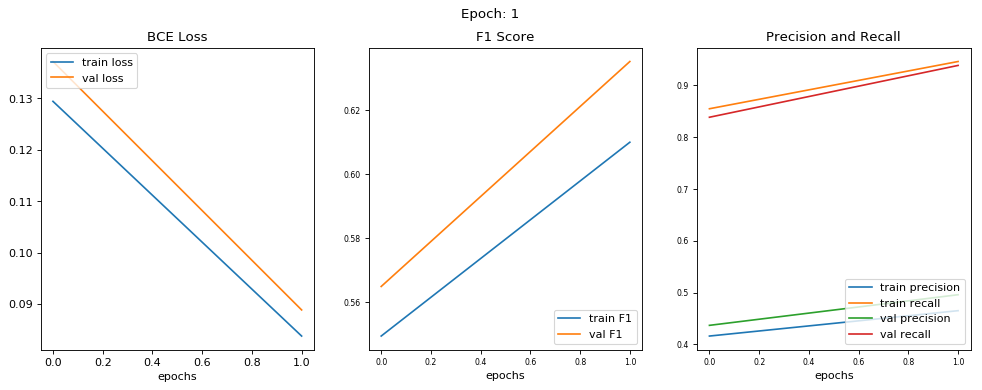

epoch [1/200] 
train loss = 0.0838, train f1 score = 0.6100 
train precision = 0.4649, train recall = 0.9458 

val loss = 0.0889, val f1 score = 0.6352 
val precision = 0.4957, val recall = 0.9382 




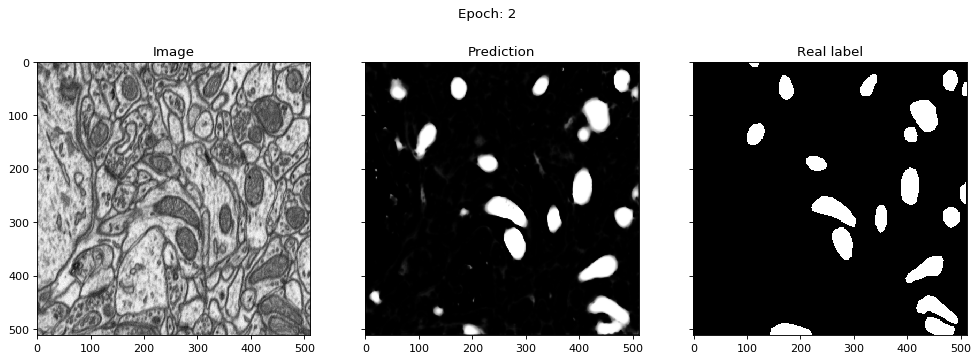

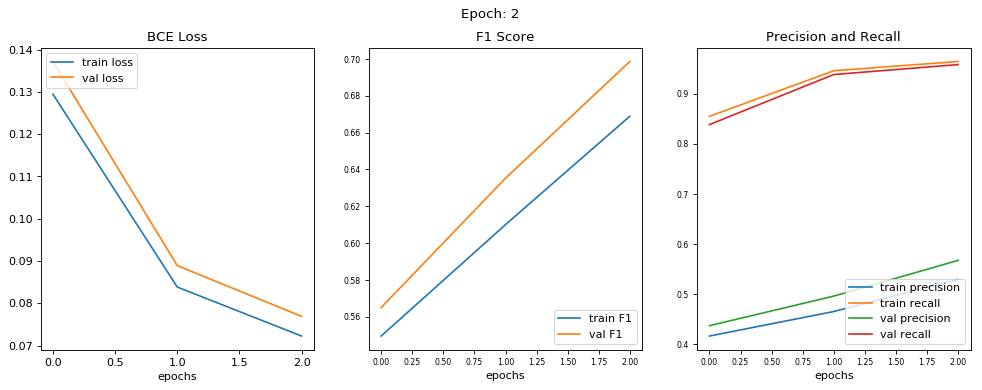

epoch [2/200] 
train loss = 0.0722, train f1 score = 0.6689 
train precision = 0.5291, train recall = 0.9642 

val loss = 0.0769, val f1 score = 0.6986 
val precision = 0.5671, val recall = 0.9580 




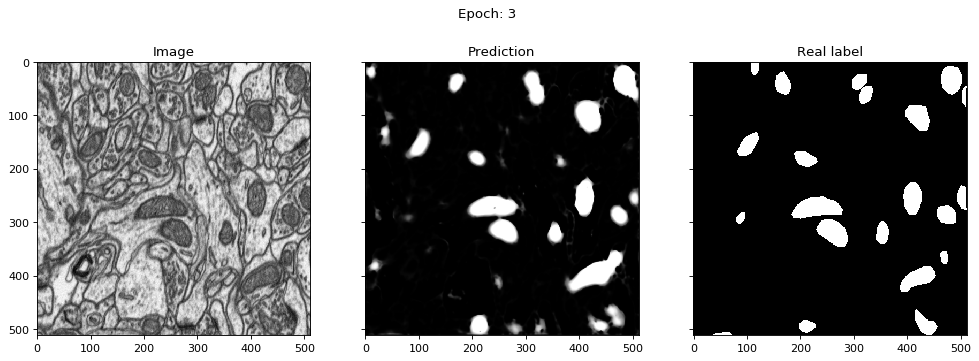

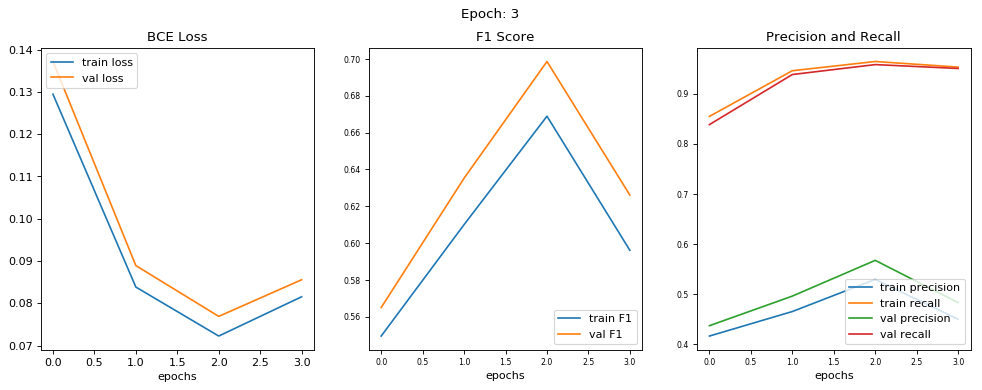

epoch [3/200] 
train loss = 0.0815, train f1 score = 0.5960 
train precision = 0.4495, train recall = 0.9531 

val loss = 0.0856, val f1 score = 0.6260 
val precision = 0.4829, val recall = 0.9503 




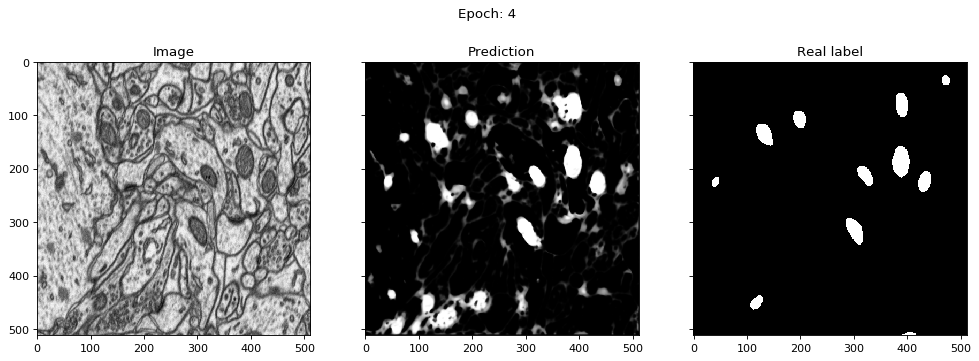

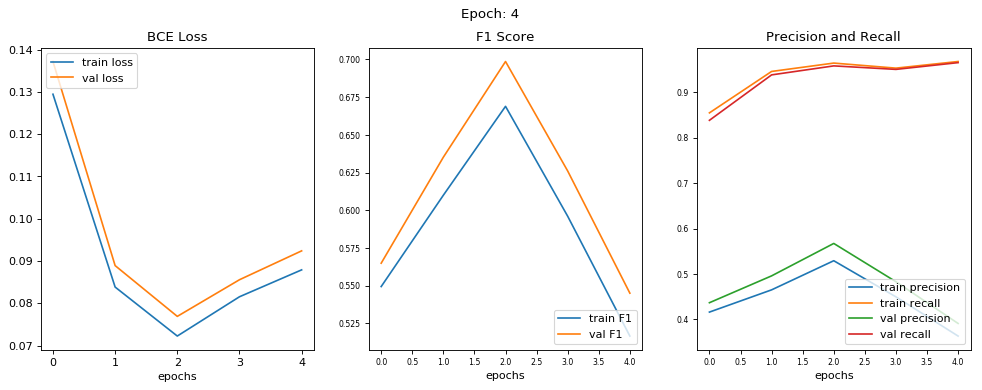

epoch [4/200] 
train loss = 0.0879, train f1 score = 0.5167 
train precision = 0.3632, train recall = 0.9677 

val loss = 0.0924, val f1 score = 0.5451 
val precision = 0.3910, val recall = 0.9652 




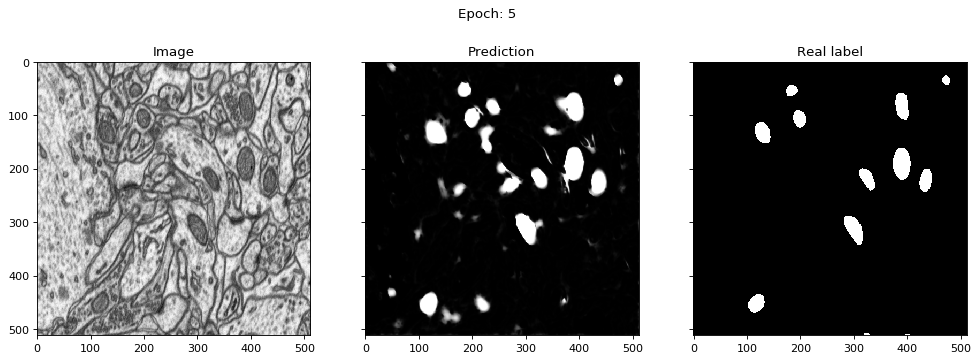

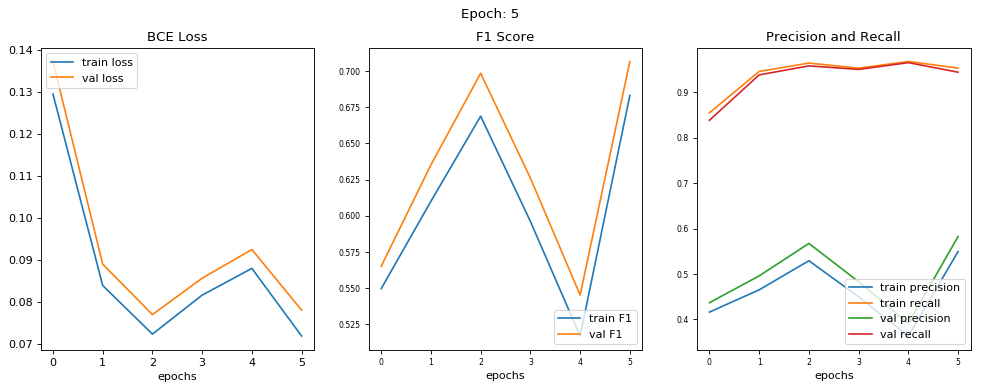

epoch [5/200] 
train loss = 0.0718, train f1 score = 0.6832 
train precision = 0.5492, train recall = 0.9532 

val loss = 0.0779, val f1 score = 0.7067 
val precision = 0.5824, val recall = 0.9441 




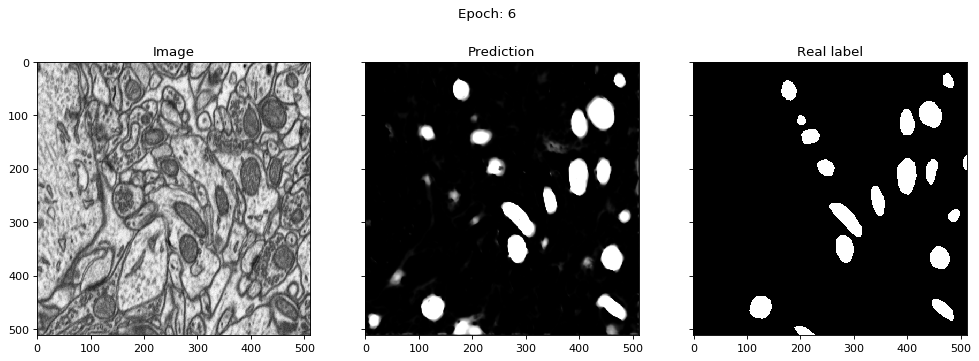

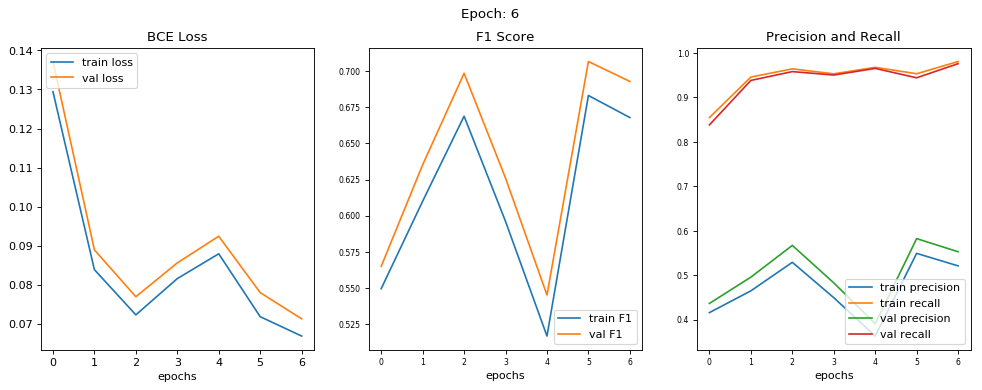

epoch [6/200] 
train loss = 0.0668, train f1 score = 0.6679 
train precision = 0.5211, train recall = 0.9808 

val loss = 0.0712, val f1 score = 0.6929 
val precision = 0.5528, val recall = 0.9759 




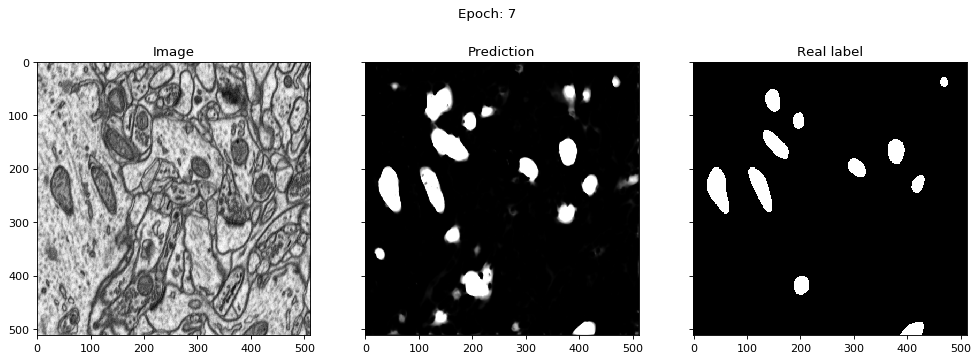

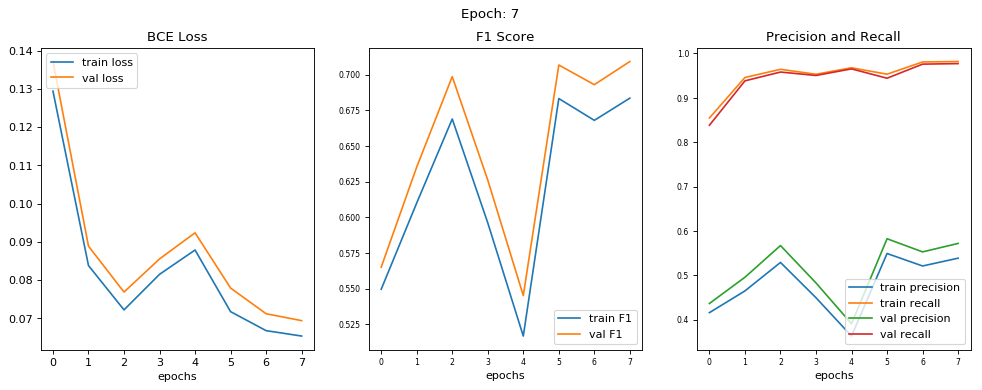

epoch [7/200] 
train loss = 0.0654, train f1 score = 0.6835 
train precision = 0.5387, train recall = 0.9818 

val loss = 0.0694, val f1 score = 0.7092 
val precision = 0.5719, val recall = 0.9771 




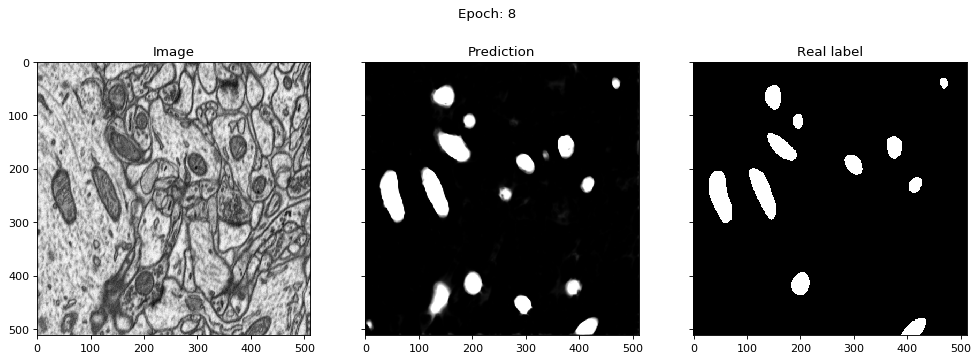

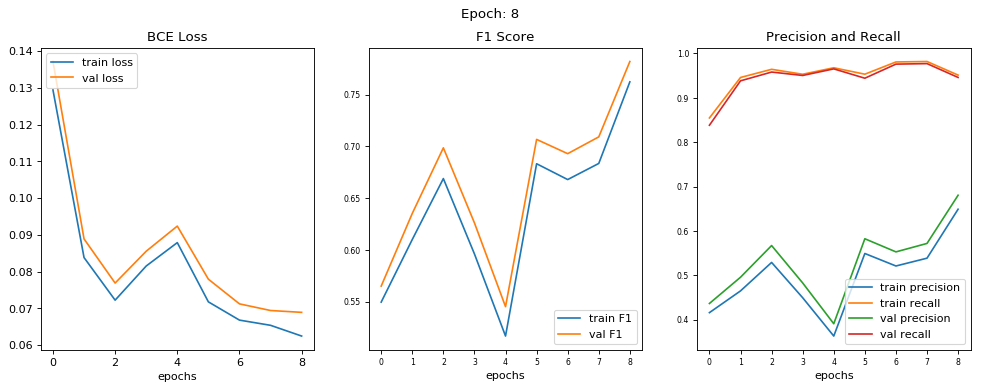

epoch [8/200] 
train loss = 0.0625, train f1 score = 0.7624 
train precision = 0.6490, train recall = 0.9512 

val loss = 0.0689, val f1 score = 0.7820 
val precision = 0.6805, val recall = 0.9459 




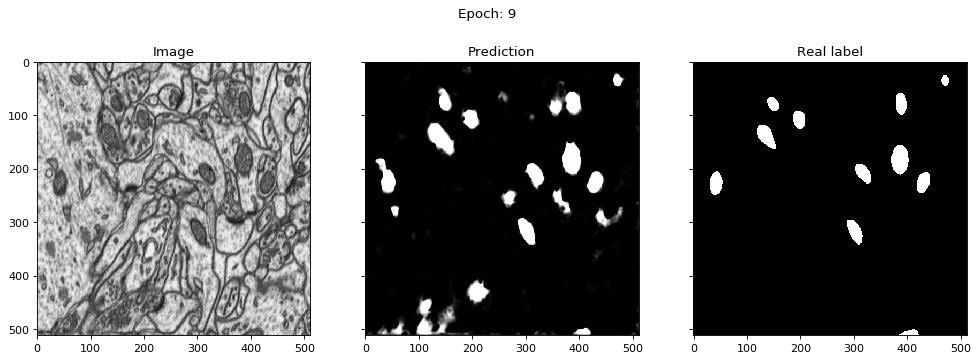

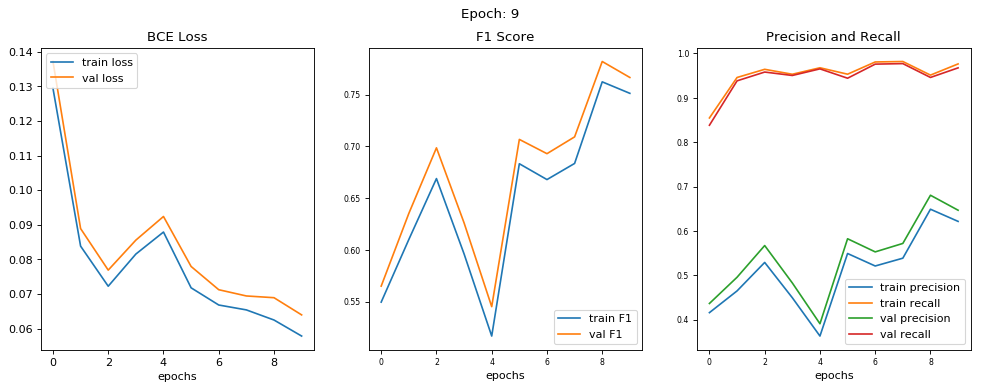

epoch [9/200] 
train loss = 0.0578, train f1 score = 0.7513 
train precision = 0.6216, train recall = 0.9764 

val loss = 0.0640, val f1 score = 0.7666 
val precision = 0.6467, val recall = 0.9675 




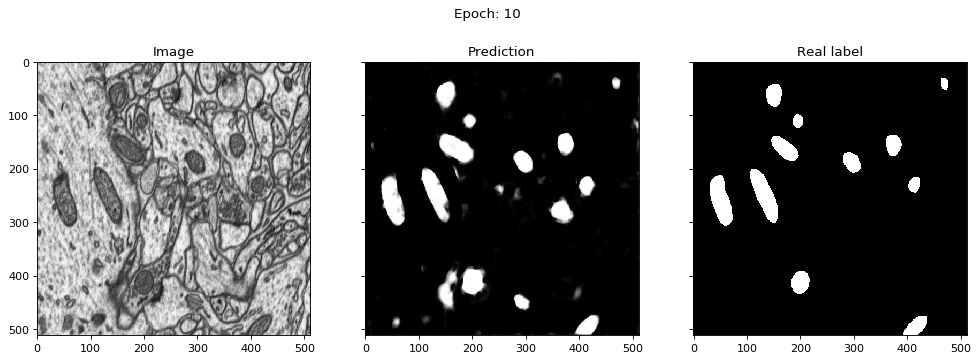

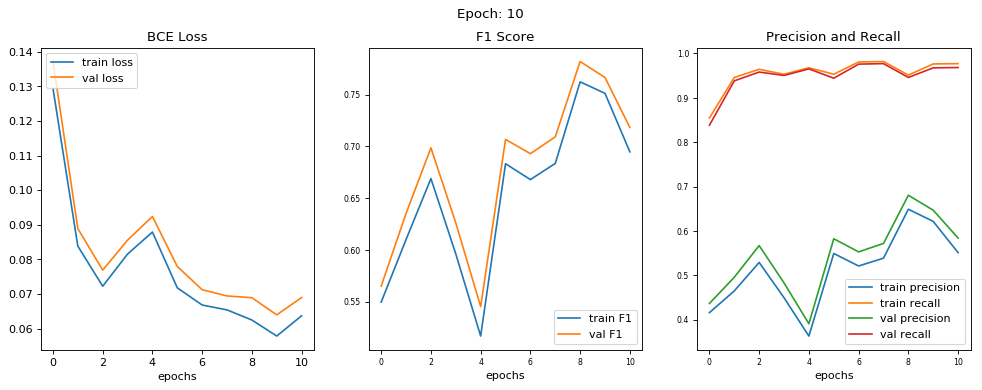

epoch [10/200] 
train loss = 0.0637, train f1 score = 0.6947 
train precision = 0.5511, train recall = 0.9769 

val loss = 0.0690, val f1 score = 0.7183 
val precision = 0.5840, val recall = 0.9682 




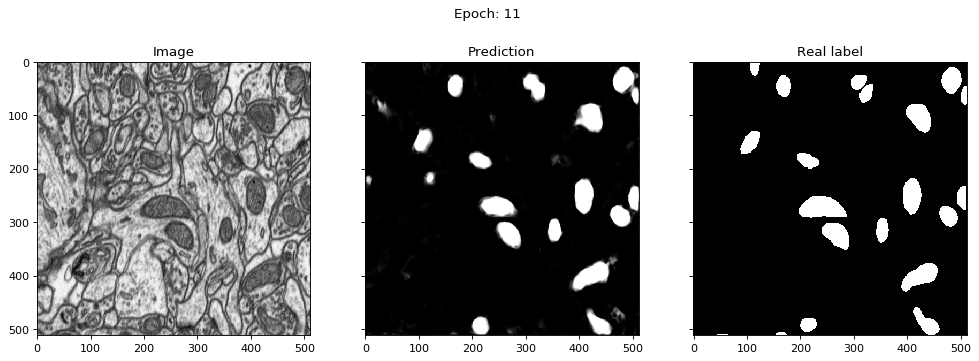

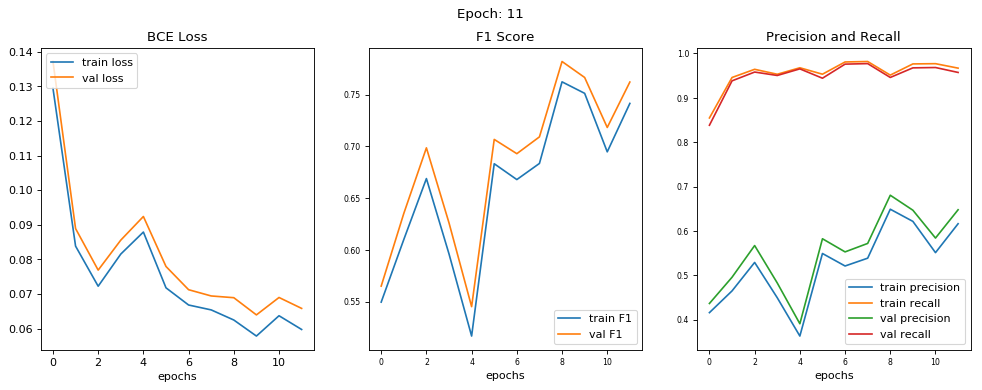

epoch [11/200] 
train loss = 0.0597, train f1 score = 0.7415 
train precision = 0.6163, train recall = 0.9668 

val loss = 0.0658, val f1 score = 0.7622 
val precision = 0.6478, val recall = 0.9571 




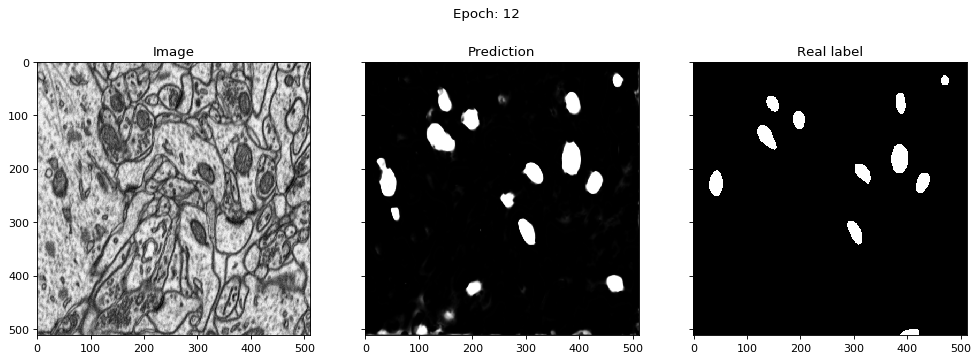

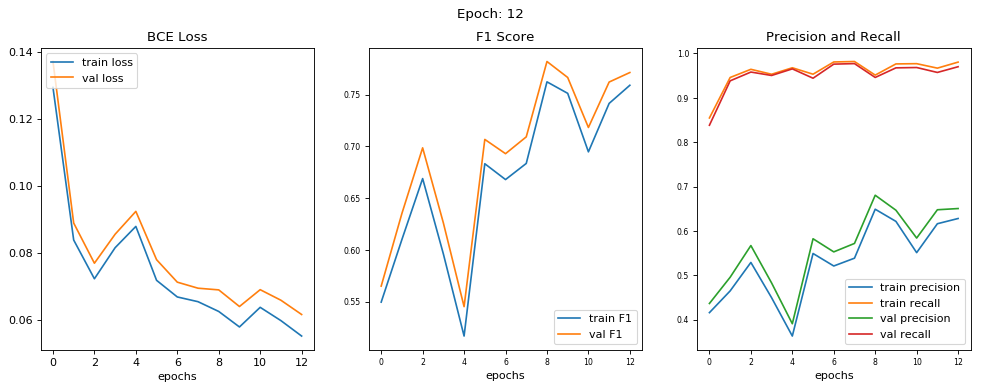

epoch [12/200] 
train loss = 0.0551, train f1 score = 0.7591 
train precision = 0.6281, train recall = 0.9804 

val loss = 0.0616, val f1 score = 0.7714 
val precision = 0.6505, val recall = 0.9700 




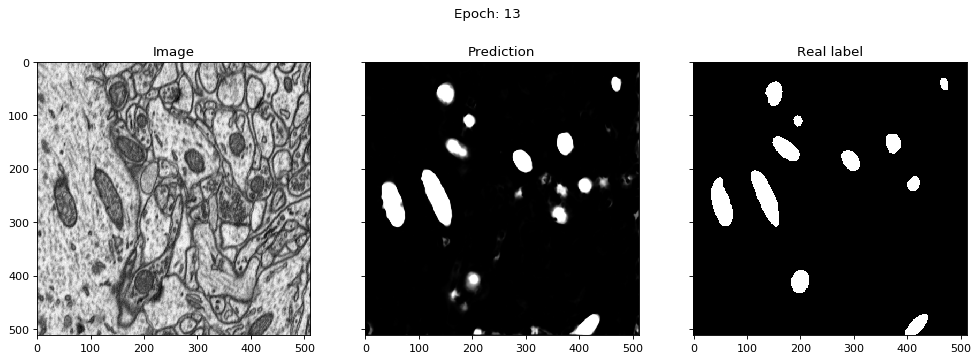

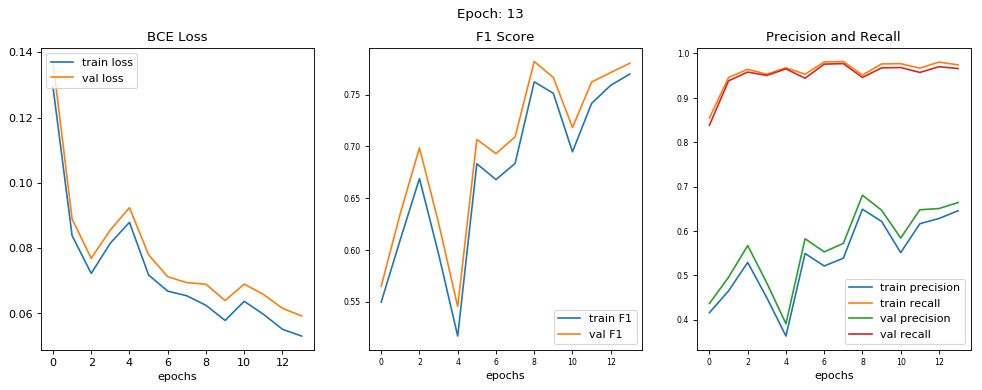

epoch [13/200] 
train loss = 0.0531, train f1 score = 0.7699 
train precision = 0.6455, train recall = 0.9742 

val loss = 0.0592, val f1 score = 0.7804 
val precision = 0.6641, val recall = 0.9659 




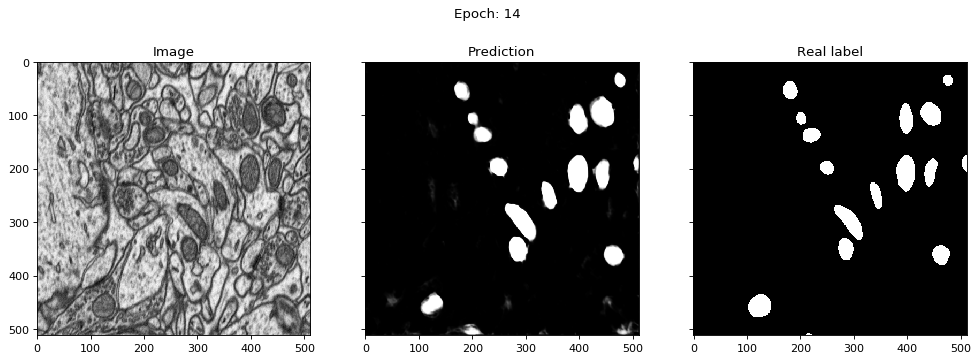

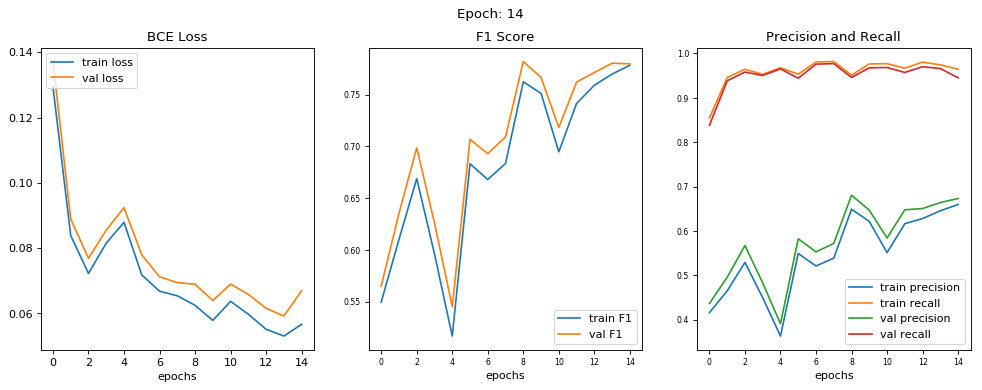

epoch [14/200] 
train loss = 0.0567, train f1 score = 0.7784 
train precision = 0.6597, train recall = 0.9644 

val loss = 0.0670, val f1 score = 0.7798 
val precision = 0.6731, val recall = 0.9452 




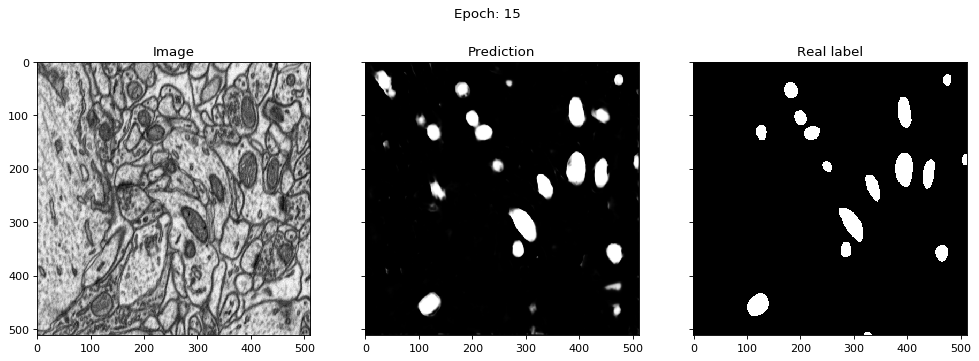

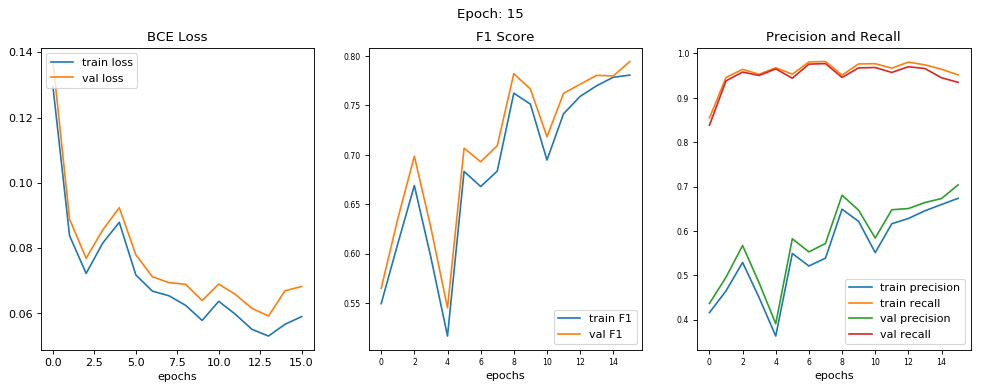

epoch [15/200] 
train loss = 0.0590, train f1 score = 0.7806 
train precision = 0.6735, train recall = 0.9517 

val loss = 0.0682, val f1 score = 0.7944 
val precision = 0.7038, val recall = 0.9348 




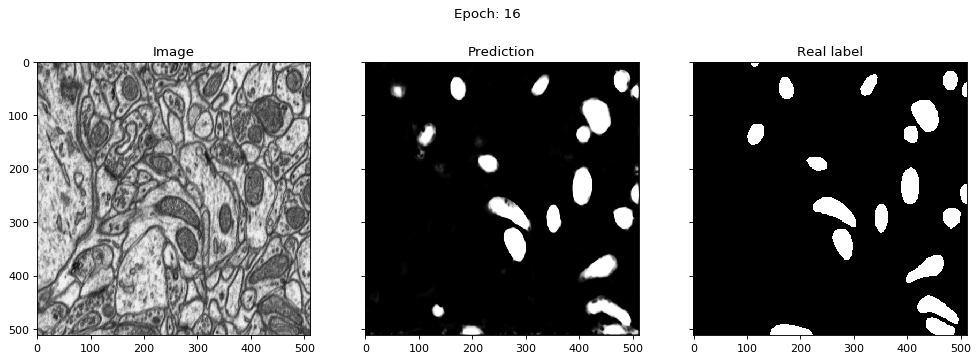

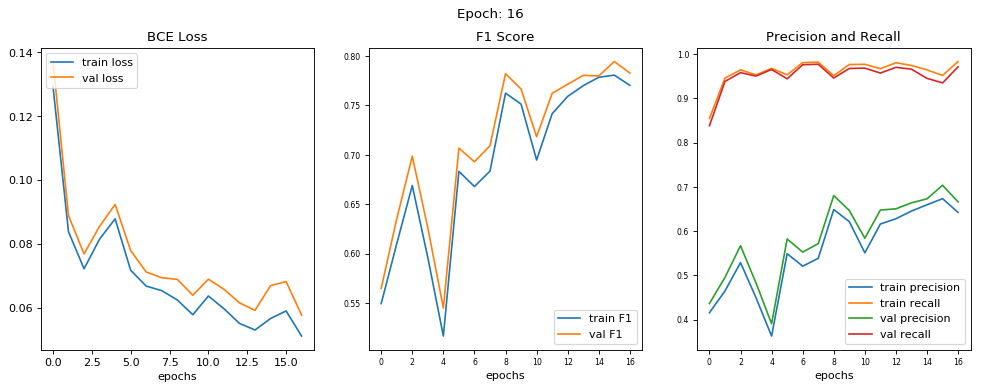

epoch [16/200] 
train loss = 0.0512, train f1 score = 0.7702 
train precision = 0.6424, train recall = 0.9832 

val loss = 0.0577, val f1 score = 0.7827 
val precision = 0.6662, val recall = 0.9712 




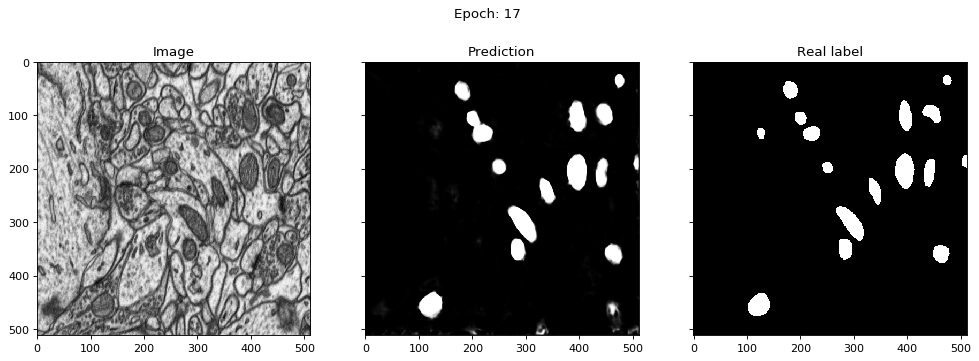

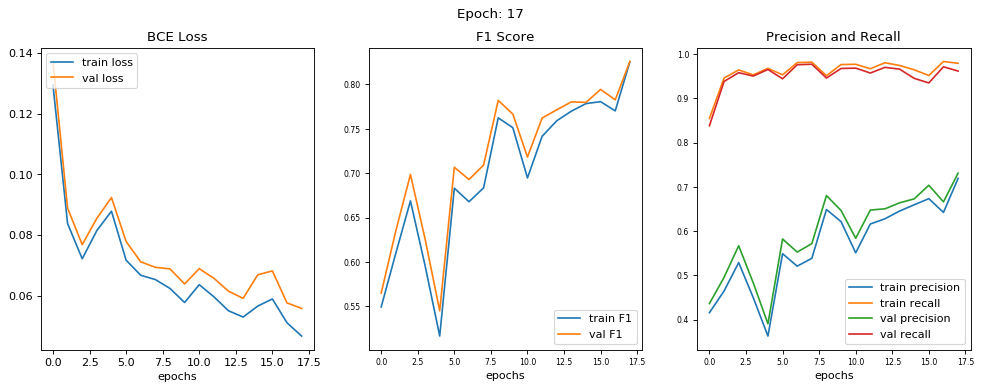

epoch [17/200] 
train loss = 0.0468, train f1 score = 0.8255 
train precision = 0.7193, train recall = 0.9792 

val loss = 0.0559, val f1 score = 0.8258 
val precision = 0.7312, val recall = 0.9616 




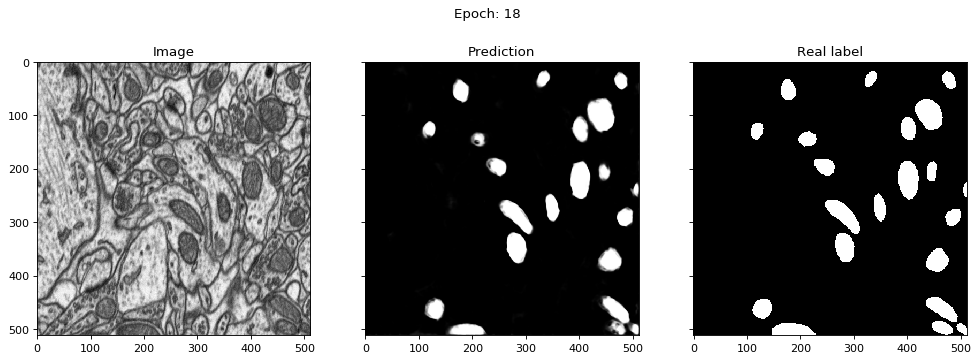

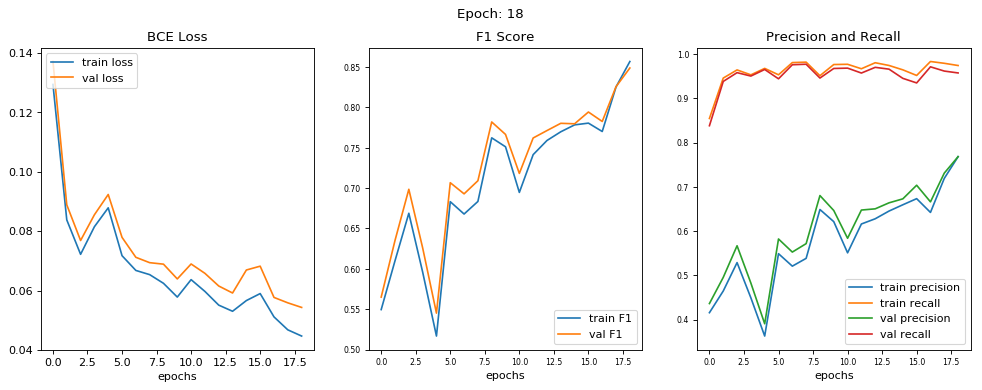

epoch [18/200] 
train loss = 0.0447, train f1 score = 0.8570 
train precision = 0.7683, train recall = 0.9741 

val loss = 0.0544, val f1 score = 0.8489 
val precision = 0.7683, val recall = 0.9574 




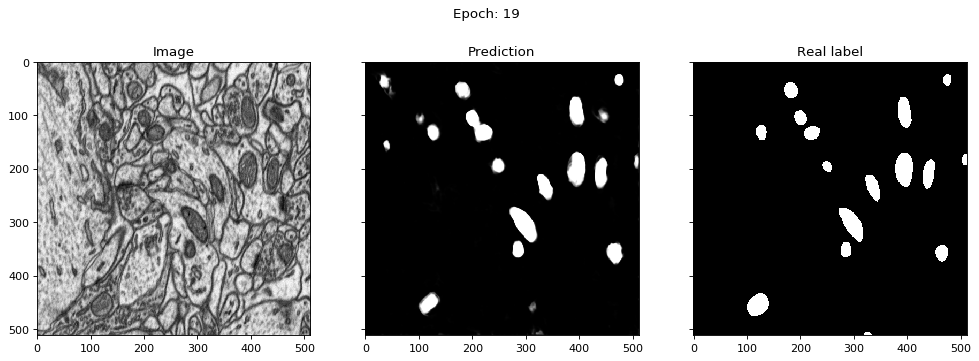

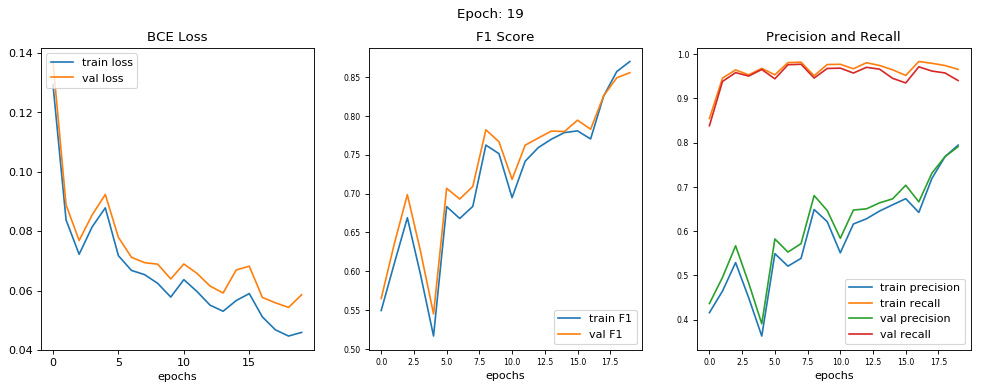

epoch [19/200] 
train loss = 0.0459, train f1 score = 0.8699 
train precision = 0.7944, train recall = 0.9654 

val loss = 0.0586, val f1 score = 0.8555 
val precision = 0.7907, val recall = 0.9403 




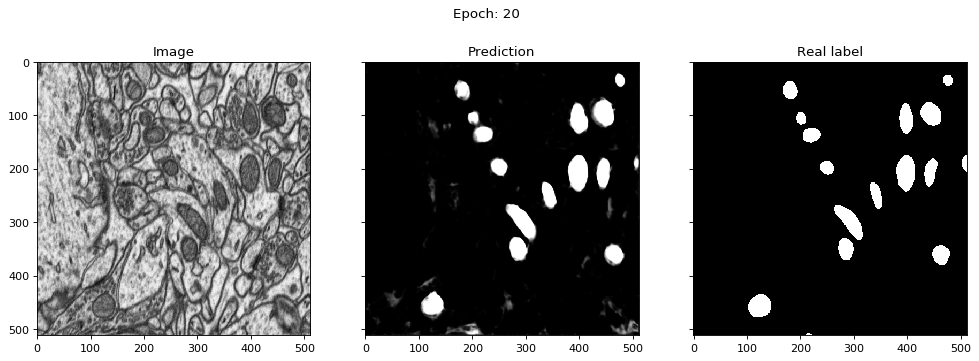

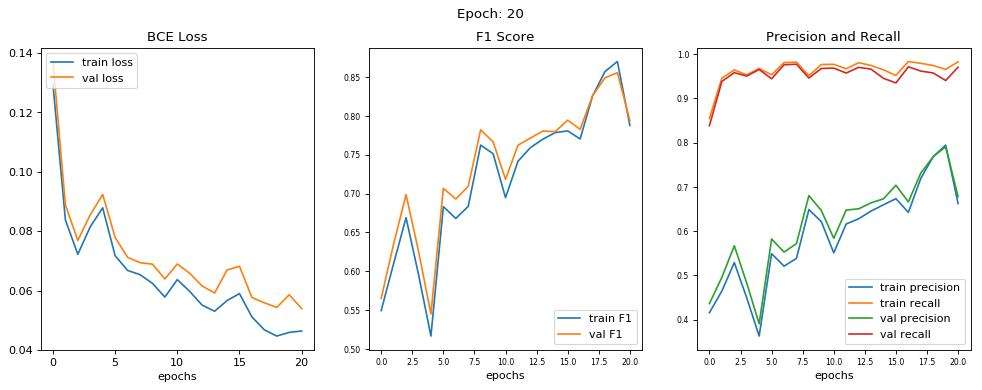

epoch [20/200] 
train loss = 0.0464, train f1 score = 0.7877 
train precision = 0.6623, train recall = 0.9825 

val loss = 0.0540, val f1 score = 0.7938 
val precision = 0.6782, val recall = 0.9704 




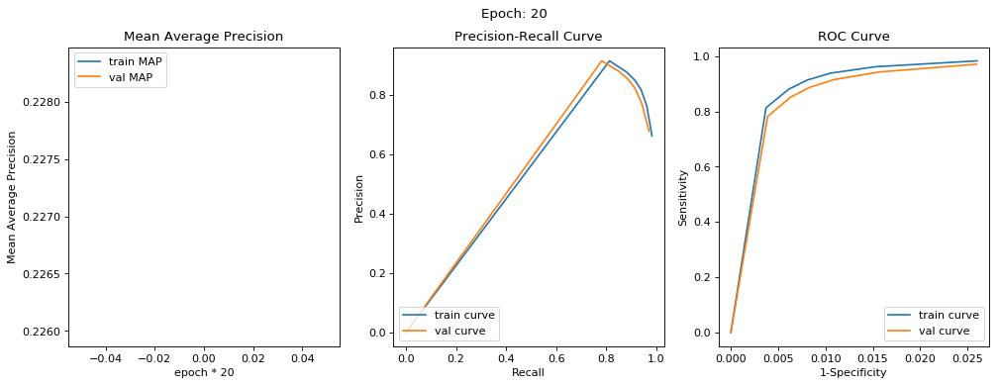

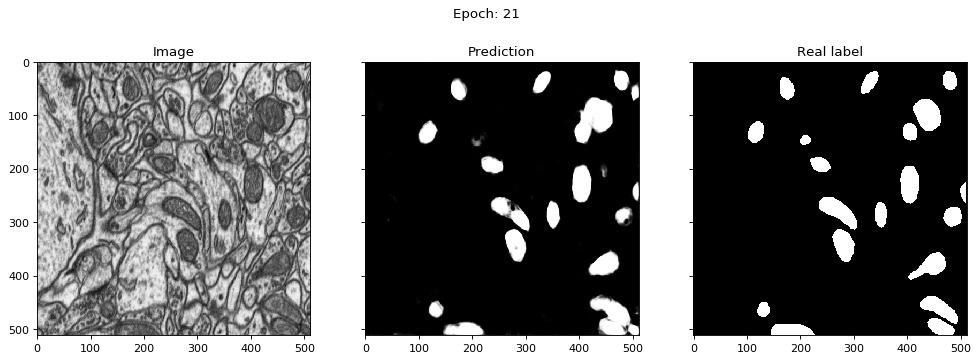

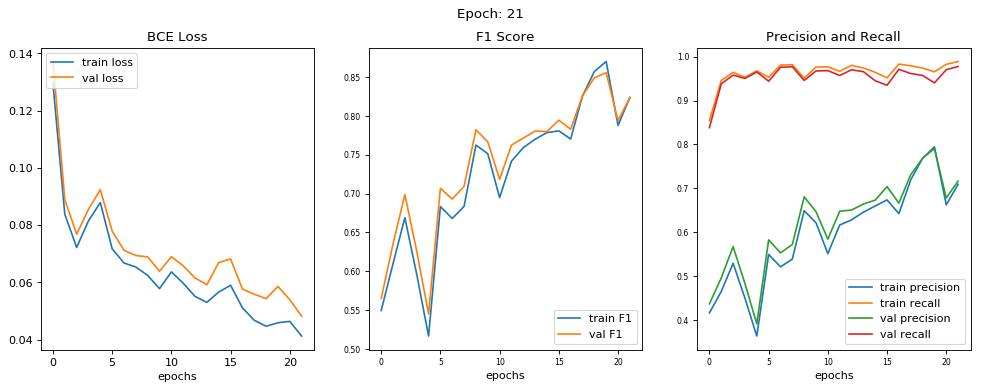

epoch [21/200] 
train loss = 0.0413, train f1 score = 0.8235 
train precision = 0.7091, train recall = 0.9890 

val loss = 0.0482, val f1 score = 0.8234 
val precision = 0.7166, val recall = 0.9776 




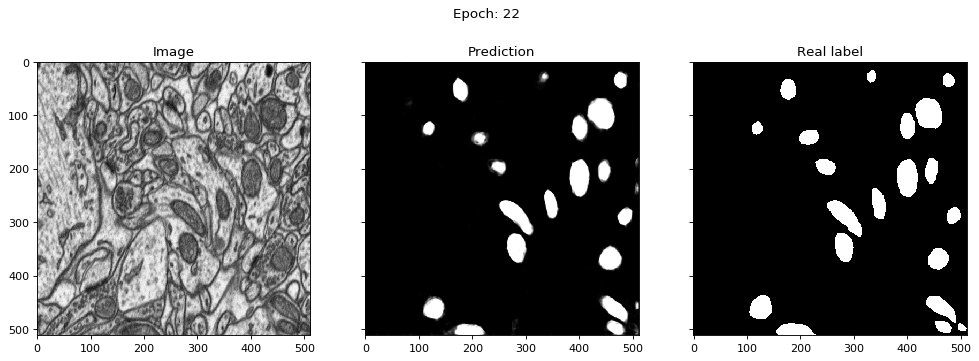

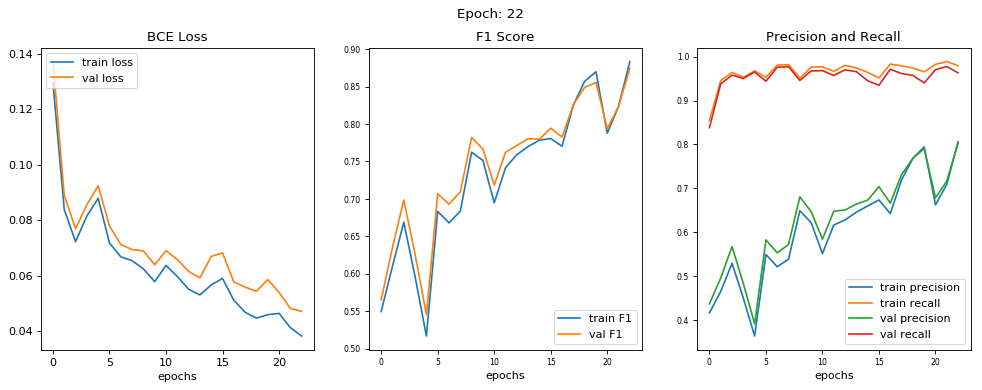

epoch [22/200] 
train loss = 0.0382, train f1 score = 0.8835 
train precision = 0.8062, train recall = 0.9795 

val loss = 0.0471, val f1 score = 0.8742 
val precision = 0.8031, val recall = 0.9632 




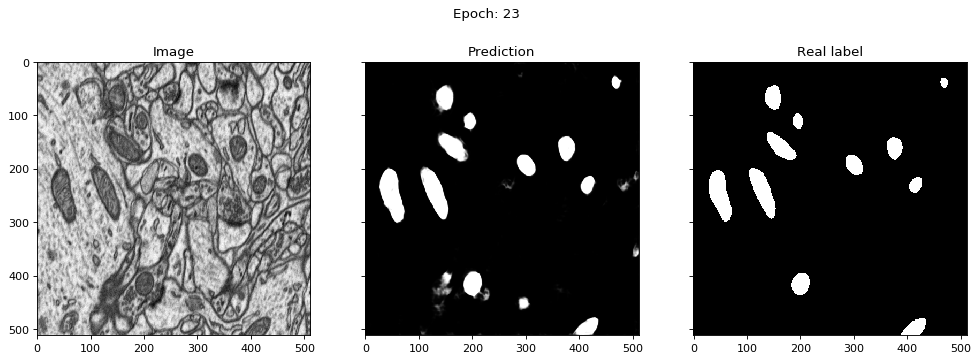

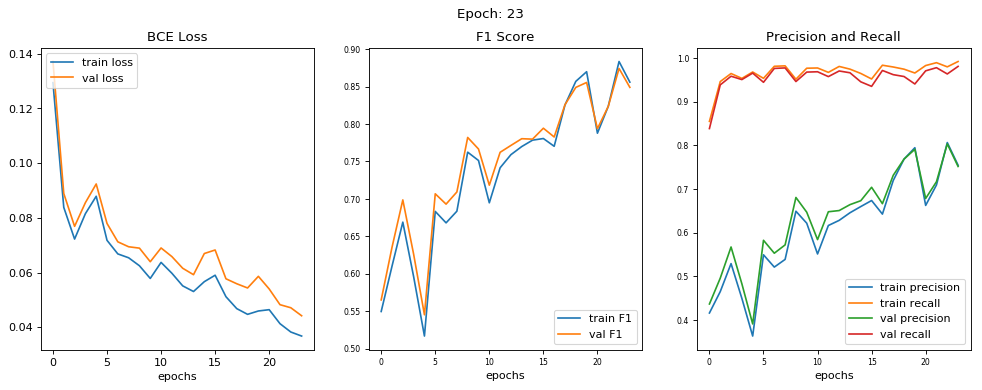

epoch [23/200] 
train loss = 0.0368, train f1 score = 0.8559 
train precision = 0.7543, train recall = 0.9917 

val loss = 0.0442, val f1 score = 0.8490 
val precision = 0.7514, val recall = 0.9805 




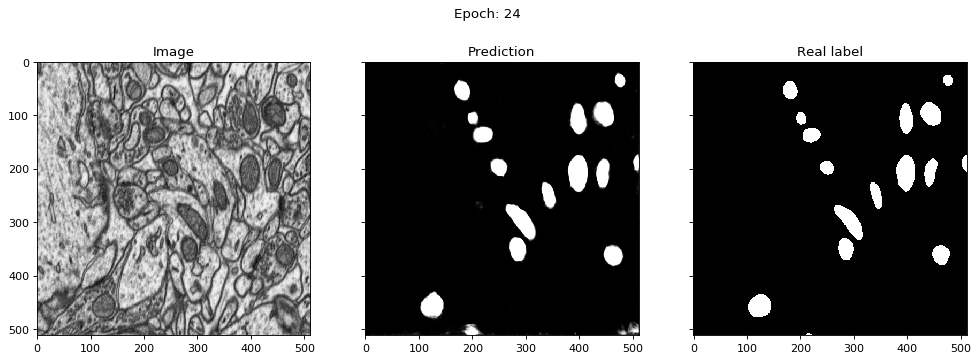

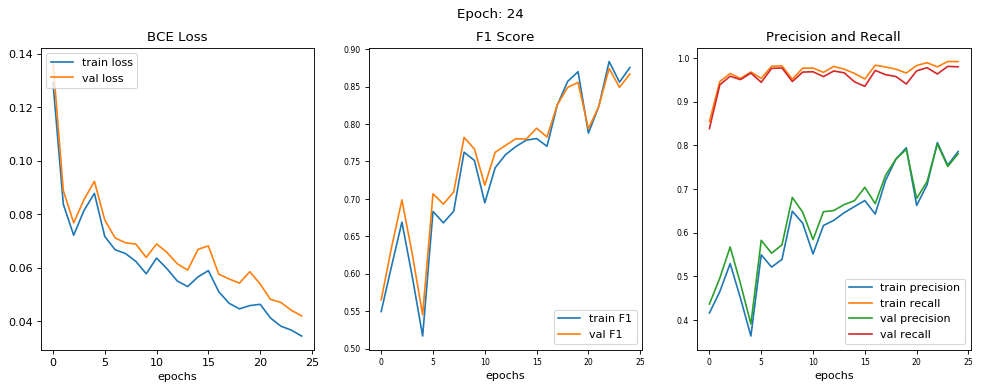

epoch [24/200] 
train loss = 0.0346, train f1 score = 0.8754 
train precision = 0.7855, train recall = 0.9916 

val loss = 0.0421, val f1 score = 0.8668 
val precision = 0.7803, val recall = 0.9796 




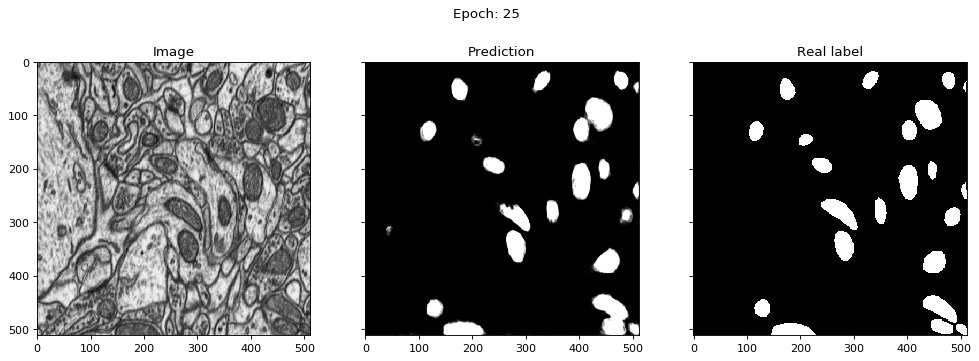

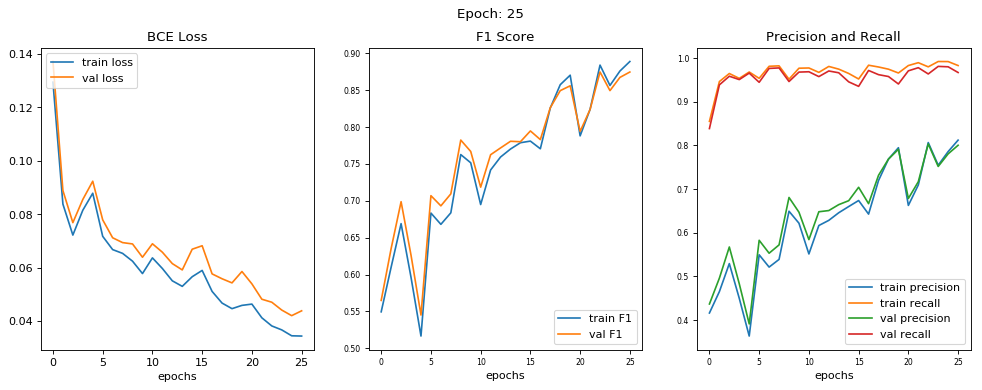

epoch [25/200] 
train loss = 0.0345, train f1 score = 0.8884 
train precision = 0.8117, train recall = 0.9825 

val loss = 0.0439, val f1 score = 0.8741 
val precision = 0.8000, val recall = 0.9665 




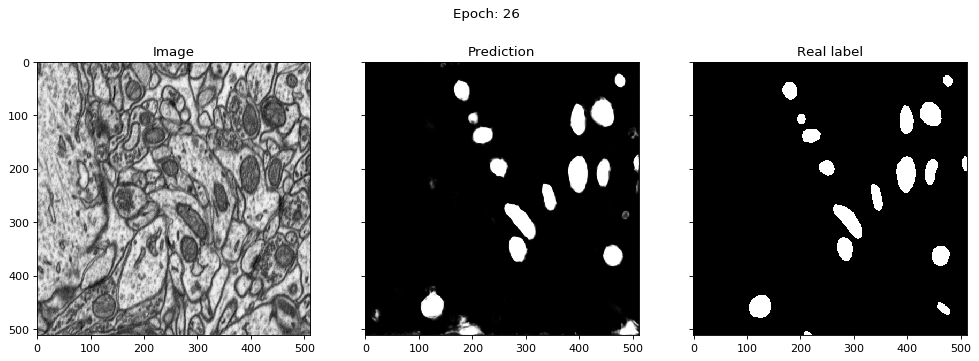

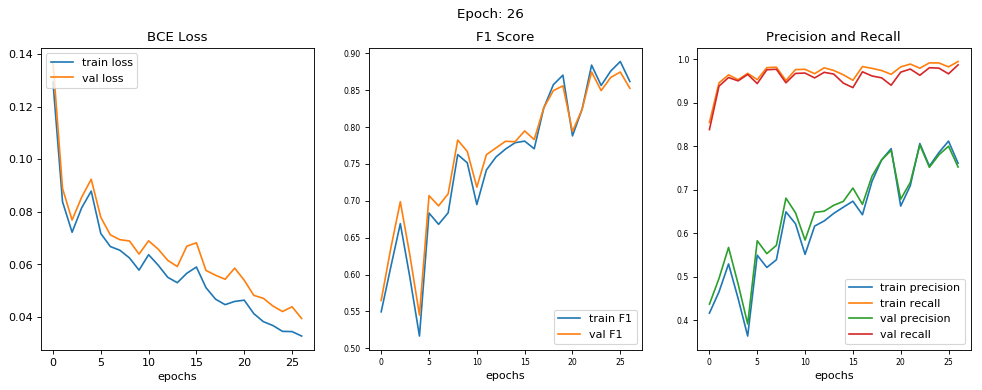

epoch [26/200] 
train loss = 0.0328, train f1 score = 0.8612 
train precision = 0.7607, train recall = 0.9949 

val loss = 0.0395, val f1 score = 0.8521 
val precision = 0.7521, val recall = 0.9872 




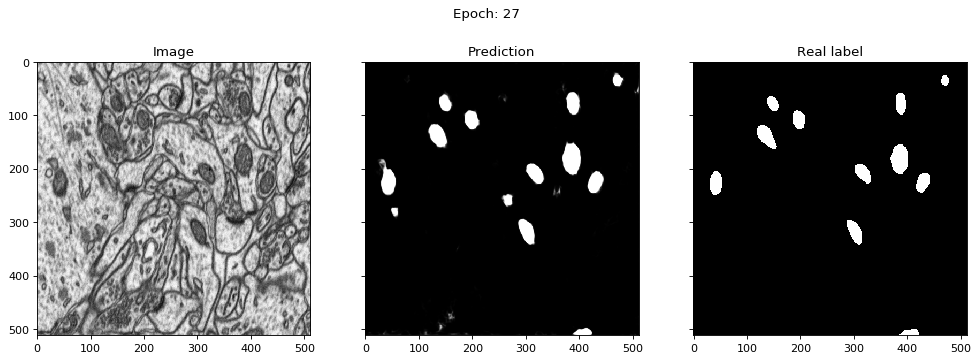

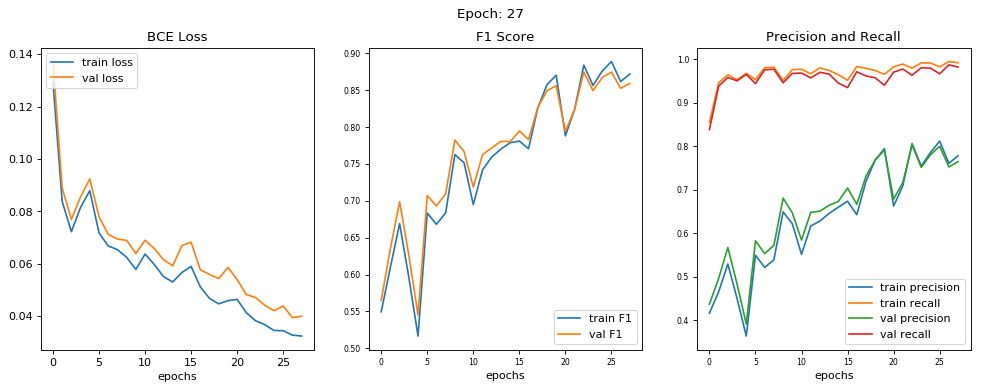

epoch [27/200] 
train loss = 0.0324, train f1 score = 0.8715 
train precision = 0.7781, train recall = 0.9920 

val loss = 0.0400, val f1 score = 0.8587 
val precision = 0.7646, val recall = 0.9822 




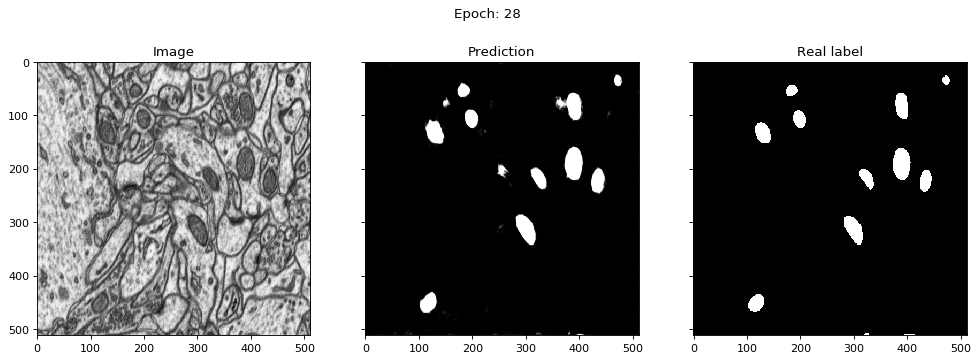

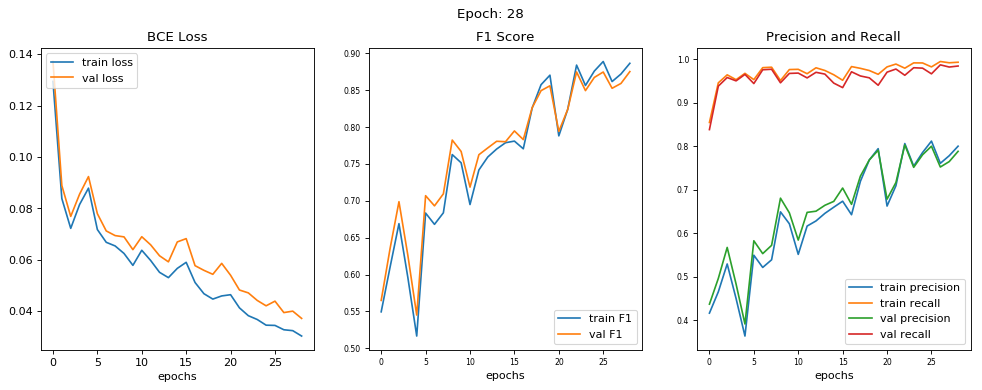

epoch [28/200] 
train loss = 0.0303, train f1 score = 0.8859 
train precision = 0.8001, train recall = 0.9932 

val loss = 0.0372, val f1 score = 0.8747 
val precision = 0.7882, val recall = 0.9845 




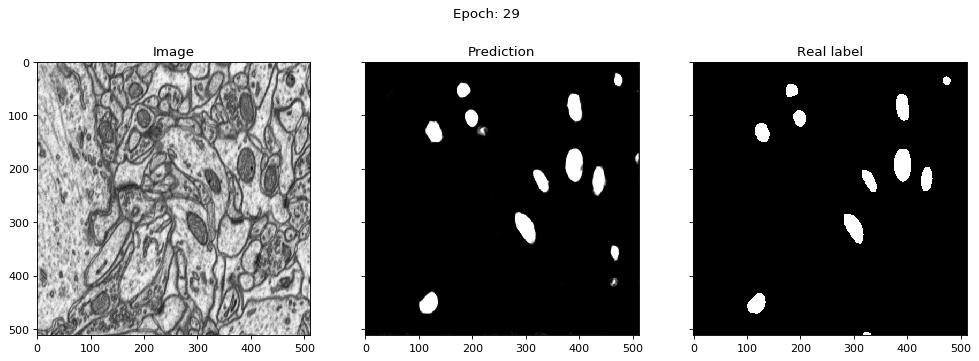

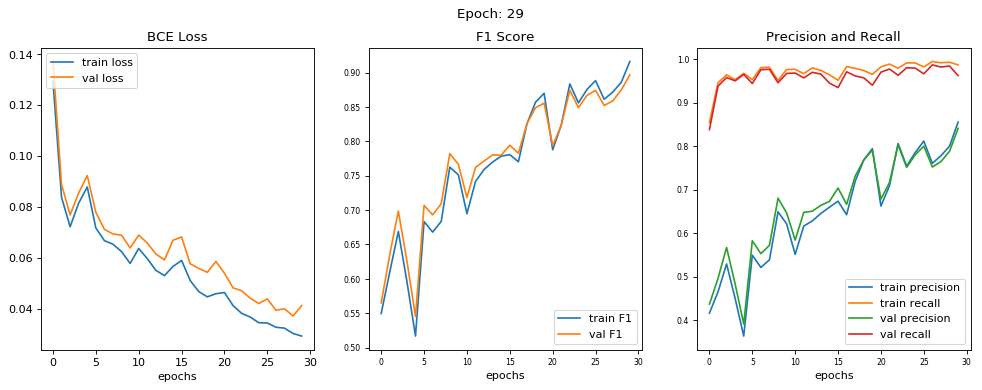

epoch [29/200] 
train loss = 0.0293, train f1 score = 0.9161 
train precision = 0.8555, train recall = 0.9871 

val loss = 0.0413, val f1 score = 0.8967 
val precision = 0.8411, val recall = 0.9626 




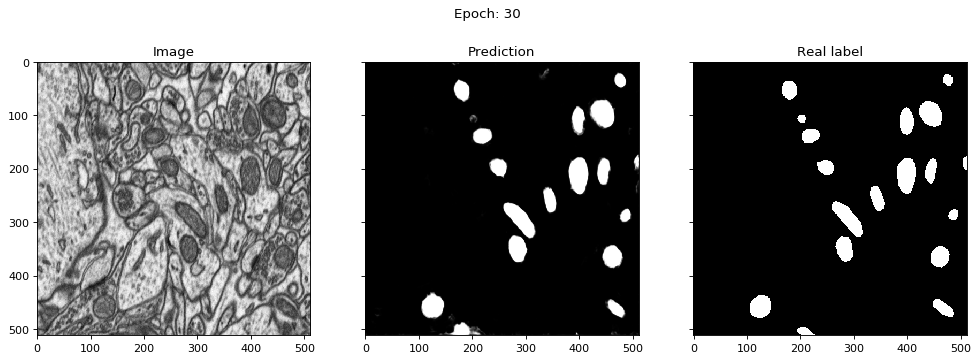

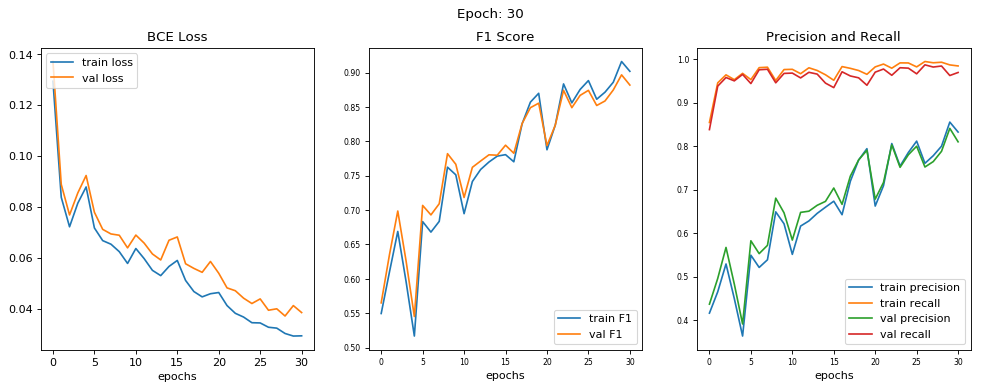

epoch [30/200] 
train loss = 0.0294, train f1 score = 0.9018 
train precision = 0.8325, train recall = 0.9847 

val loss = 0.0385, val f1 score = 0.8819 
val precision = 0.8101, val recall = 0.9696 




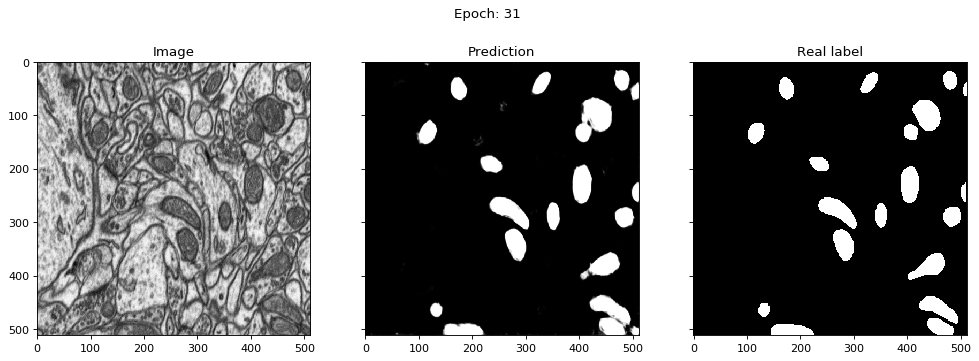

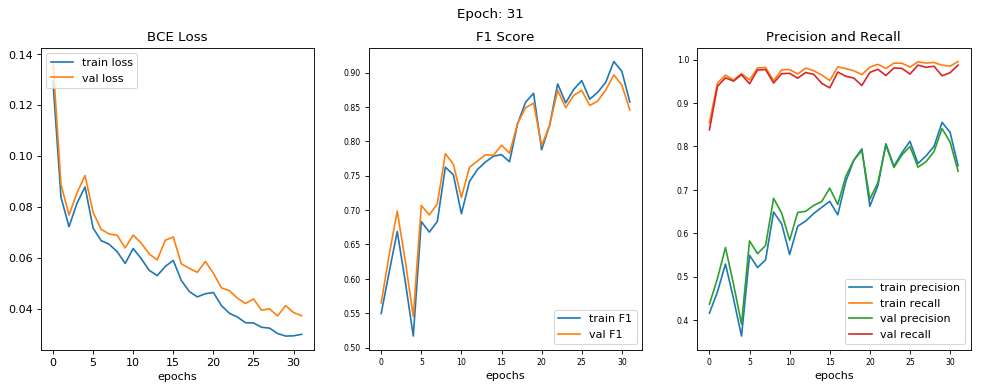

epoch [31/200] 
train loss = 0.0300, train f1 score = 0.8571 
train precision = 0.7554, train recall = 0.9955 

val loss = 0.0373, val f1 score = 0.8455 
val precision = 0.7431, val recall = 0.9872 




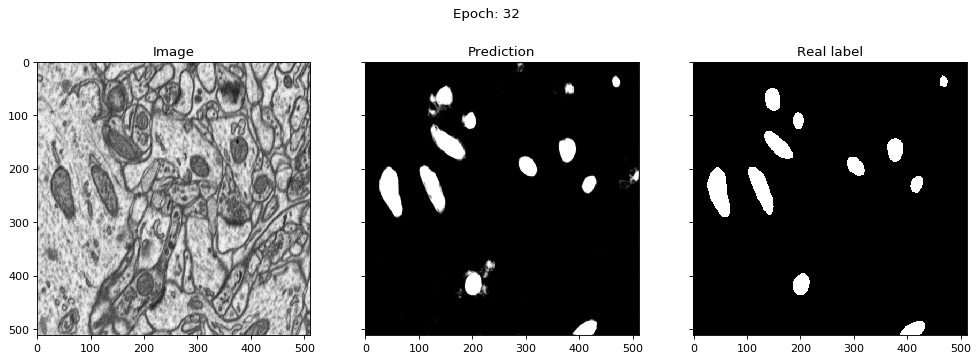

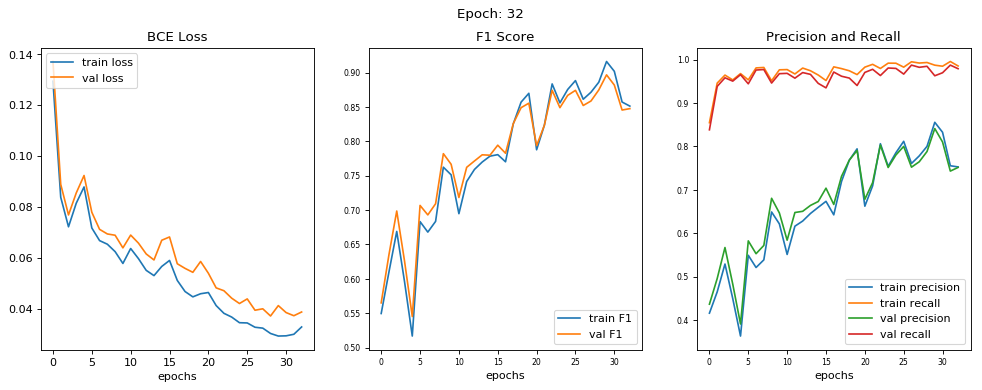

epoch [32/200] 
train loss = 0.0329, train f1 score = 0.8512 
train precision = 0.7527, train recall = 0.9852 

val loss = 0.0388, val f1 score = 0.8475 
val precision = 0.7516, val recall = 0.9789 




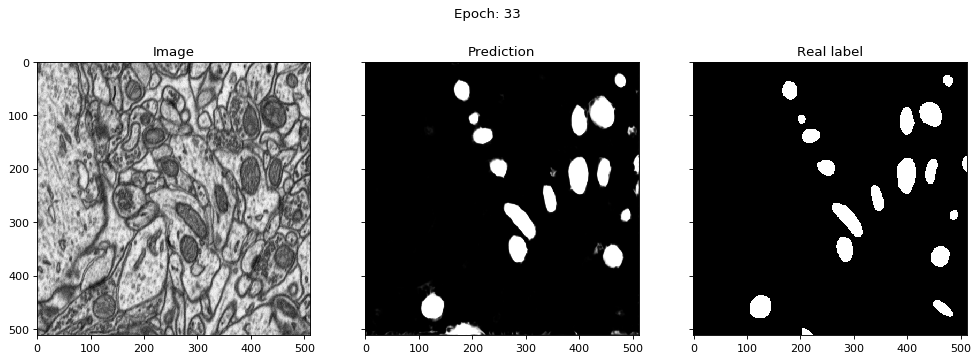

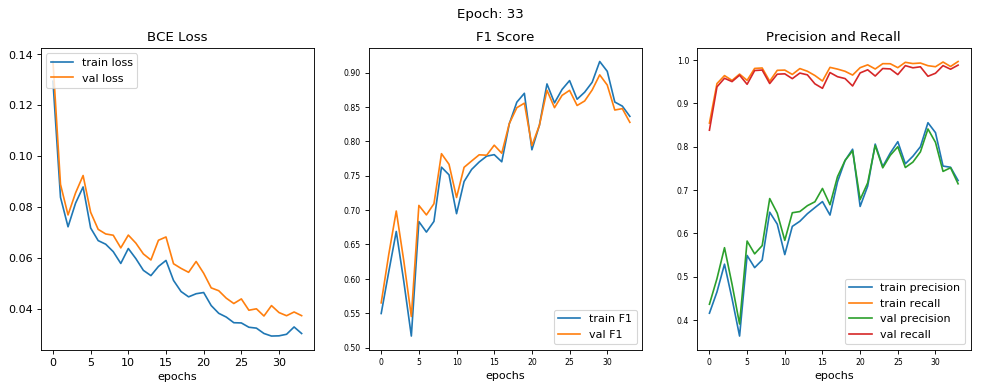

epoch [33/200] 
train loss = 0.0303, train f1 score = 0.8363 
train precision = 0.7221, train recall = 0.9967 

val loss = 0.0373, val f1 score = 0.8276 
val precision = 0.7145, val recall = 0.9884 




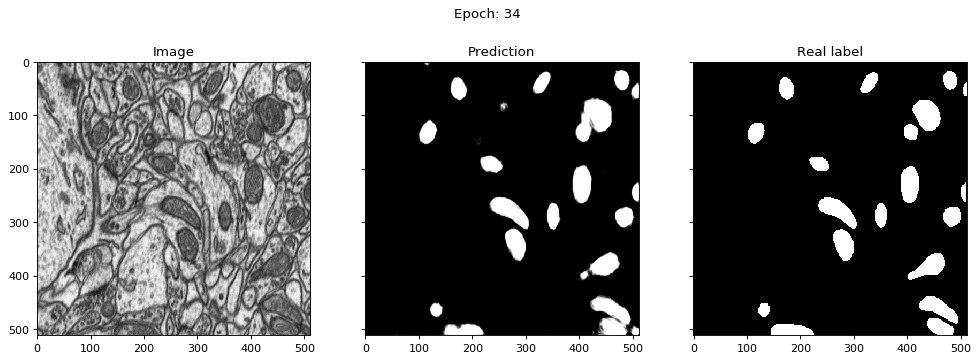

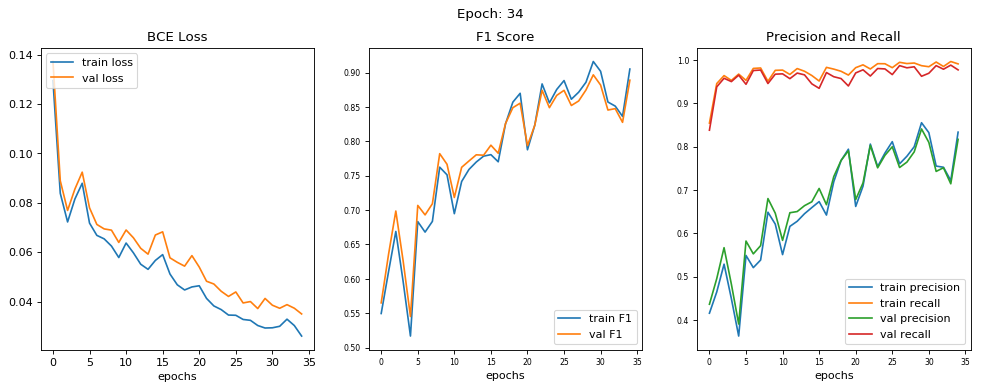

epoch [34/200] 
train loss = 0.0261, train f1 score = 0.9051 
train precision = 0.8337, train recall = 0.9912 

val loss = 0.0350, val f1 score = 0.8889 
val precision = 0.8171, val recall = 0.9774 




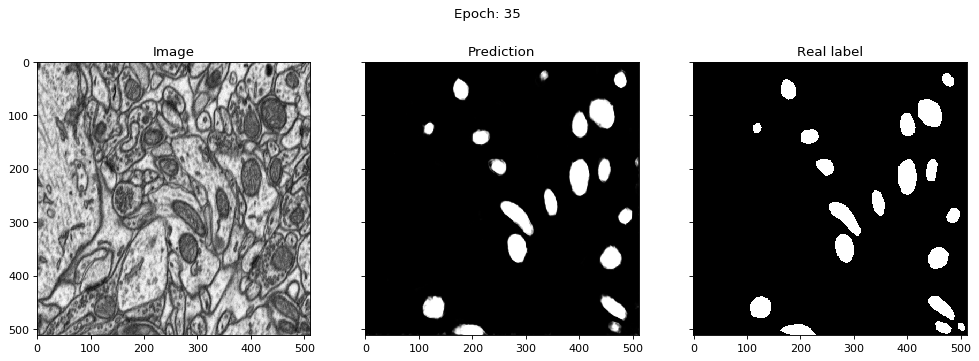

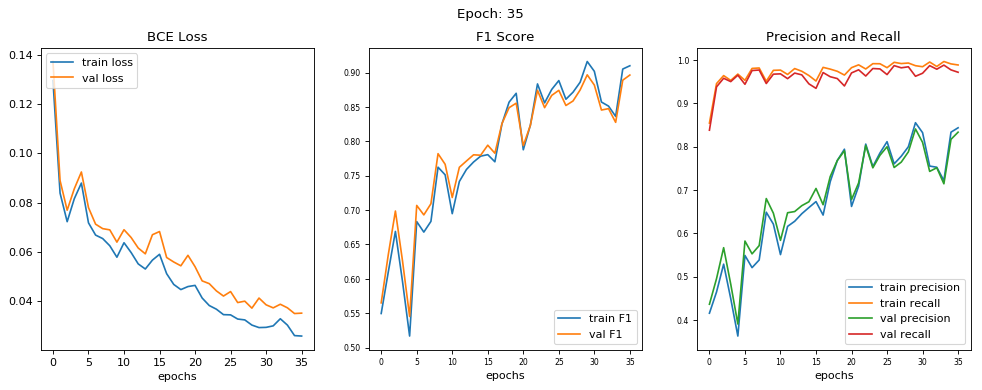

epoch [35/200] 
train loss = 0.0259, train f1 score = 0.9099 
train precision = 0.8438, train recall = 0.9887 

val loss = 0.0352, val f1 score = 0.8964 
val precision = 0.8336, val recall = 0.9719 




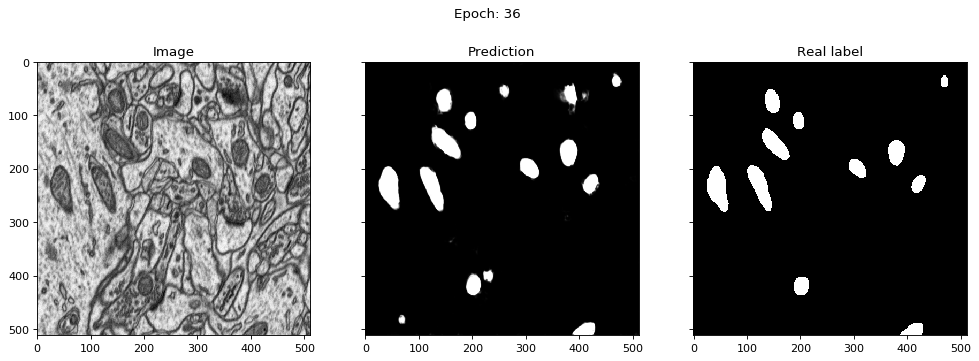

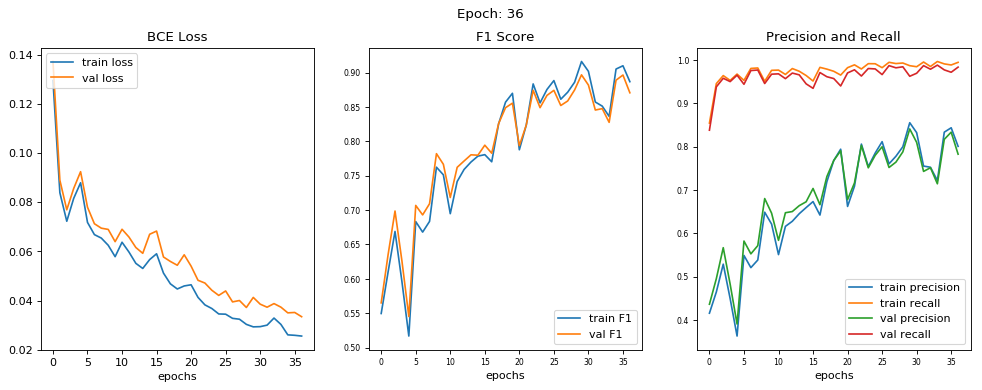

epoch [36/200] 
train loss = 0.0256, train f1 score = 0.8868 
train precision = 0.8009, train recall = 0.9948 

val loss = 0.0334, val f1 score = 0.8706 
val precision = 0.7829, val recall = 0.9837 




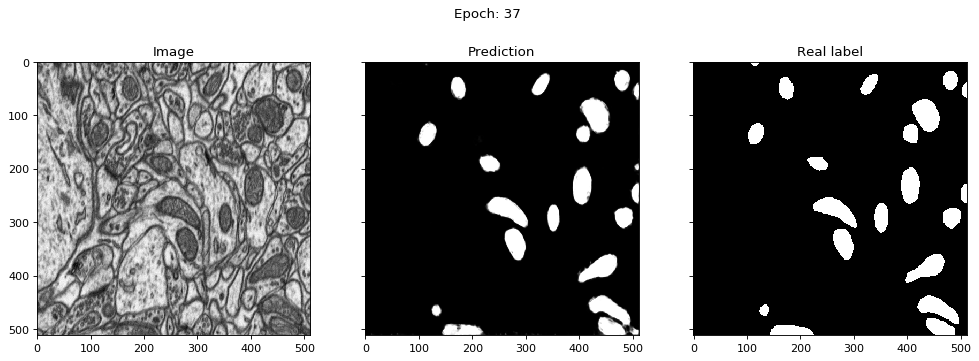

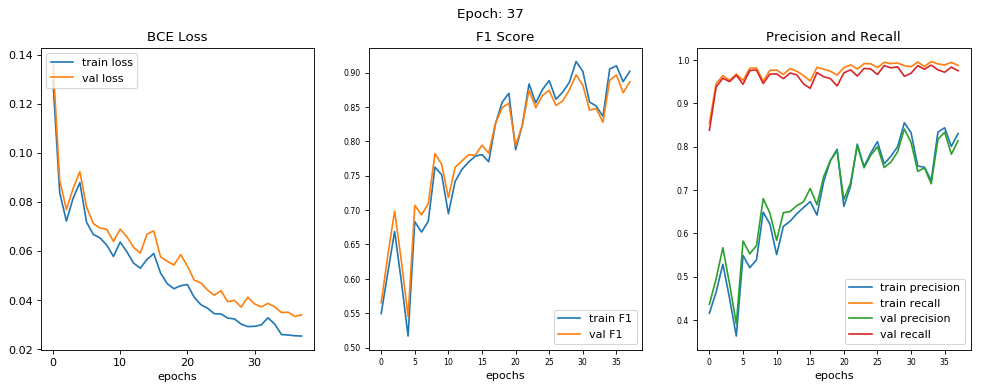

epoch [37/200] 
train loss = 0.0255, train f1 score = 0.9020 
train precision = 0.8306, train recall = 0.9876 

val loss = 0.0341, val f1 score = 0.8865 
val precision = 0.8140, val recall = 0.9754 




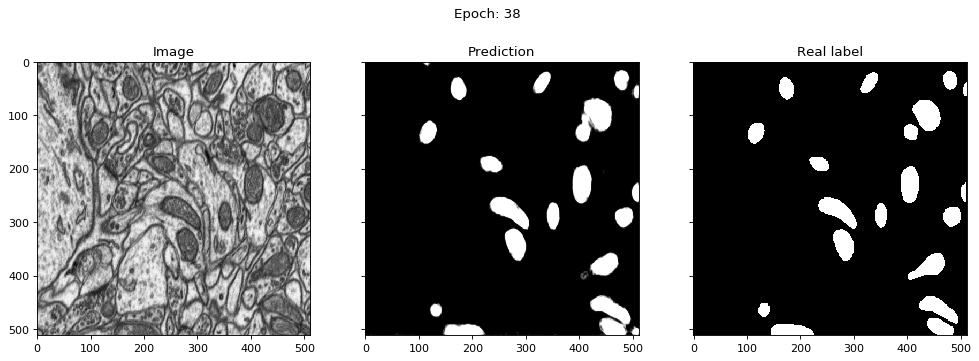

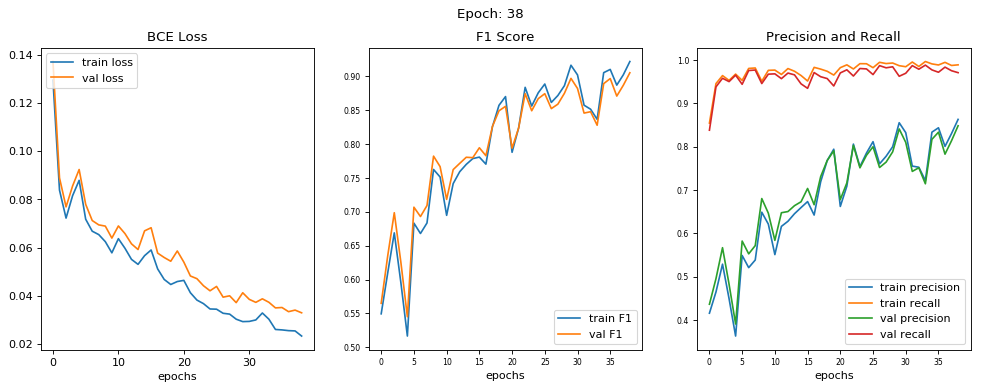

epoch [38/200] 
train loss = 0.0233, train f1 score = 0.9216 
train precision = 0.8632, train recall = 0.9890 

val loss = 0.0330, val f1 score = 0.9050 
val precision = 0.8485, val recall = 0.9710 




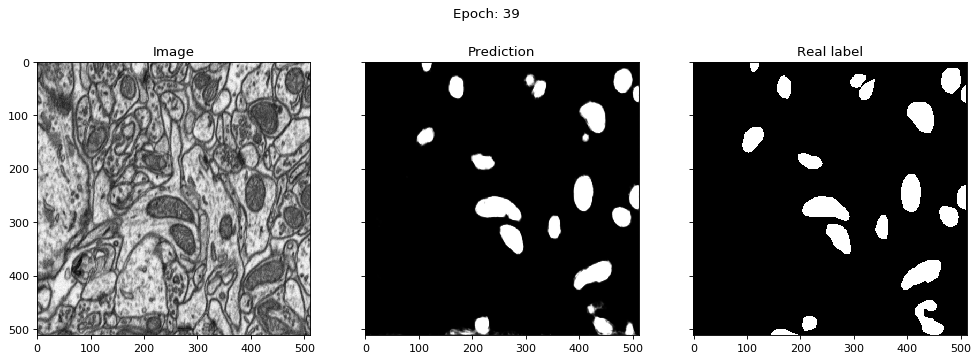

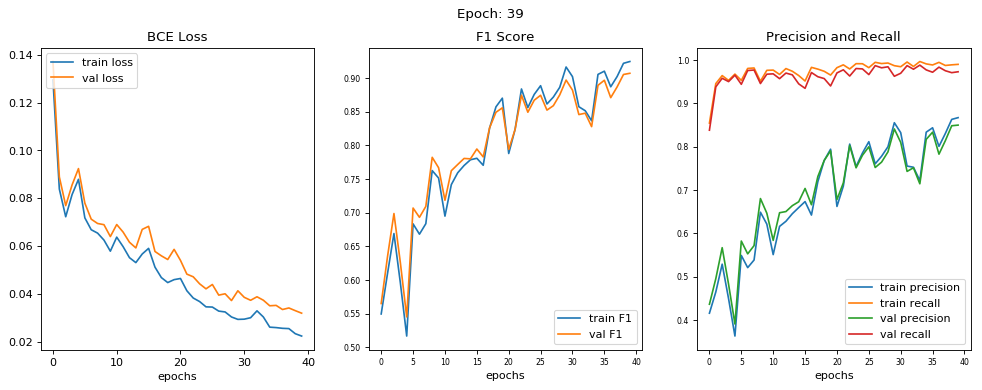

epoch [39/200] 
train loss = 0.0223, train f1 score = 0.9243 
train precision = 0.8672, train recall = 0.9901 

val loss = 0.0319, val f1 score = 0.9068 
val precision = 0.8500, val recall = 0.9730 




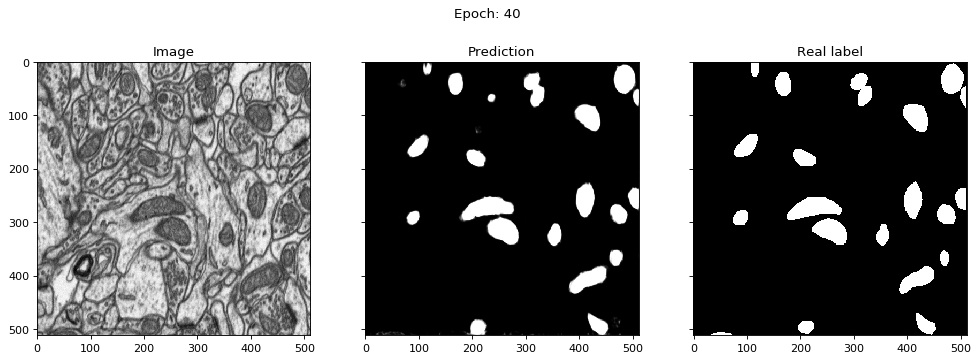

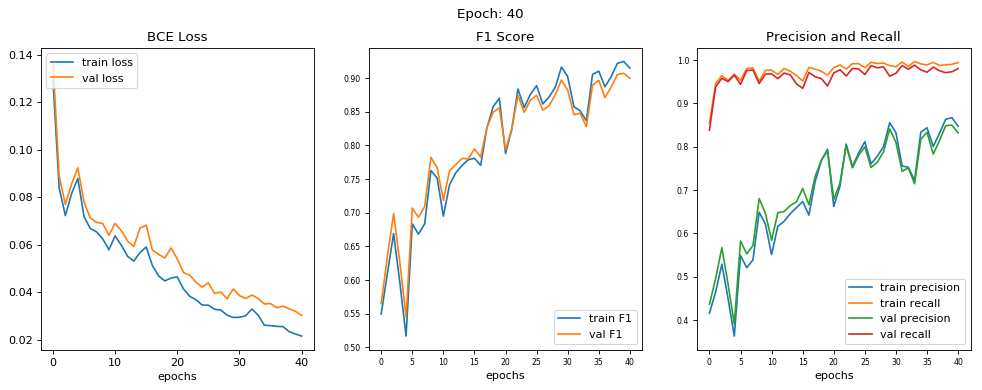

epoch [40/200] 
train loss = 0.0215, train f1 score = 0.9146 
train precision = 0.8474, train recall = 0.9943 

val loss = 0.0302, val f1 score = 0.8994 
val precision = 0.8320, val recall = 0.9804 




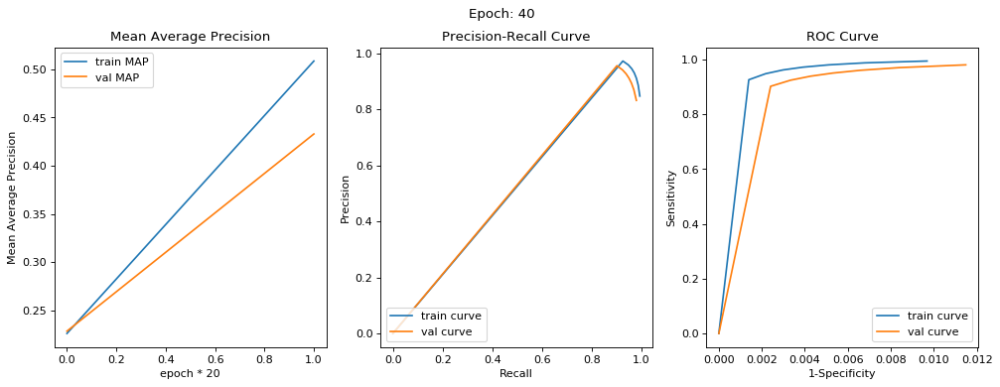

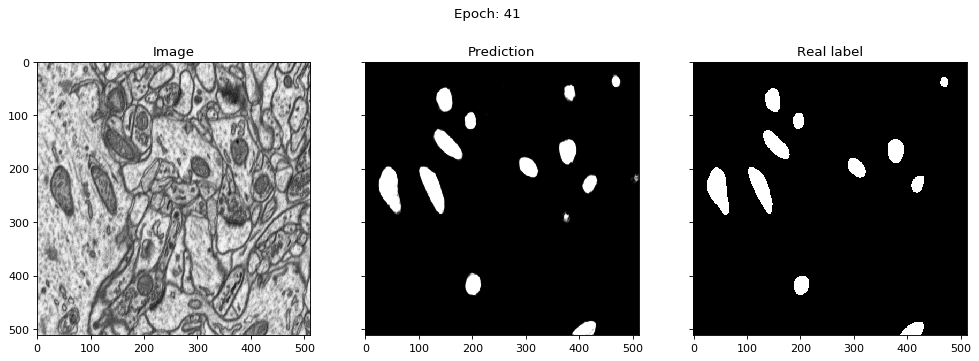

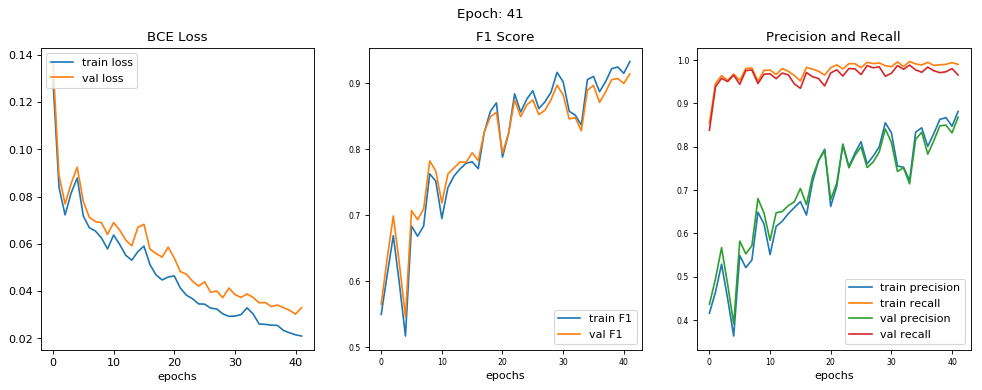

epoch [41/200] 
train loss = 0.0210, train f1 score = 0.9325 
train precision = 0.8817, train recall = 0.9901 

val loss = 0.0330, val f1 score = 0.9137 
val precision = 0.8681, val recall = 0.9655 




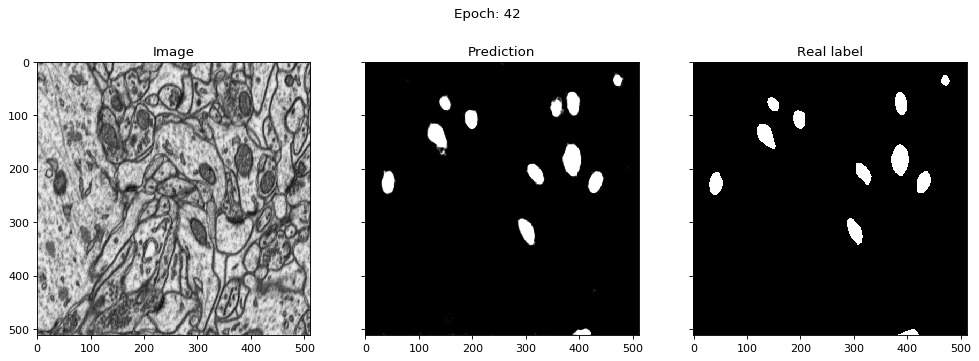

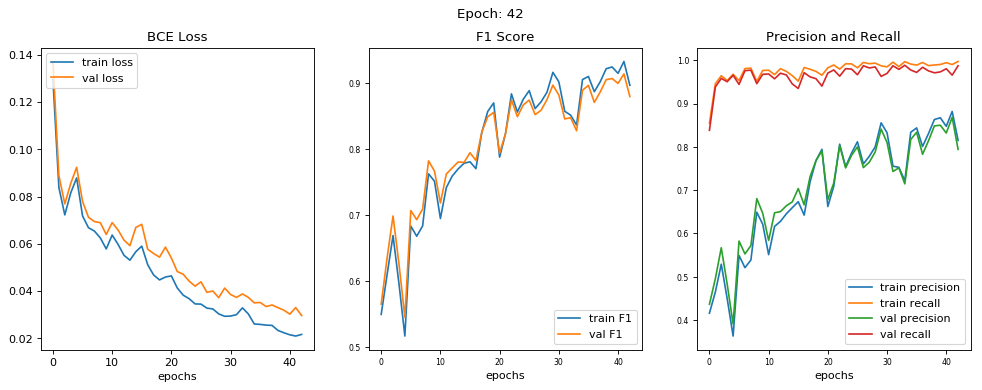

epoch [42/200] 
train loss = 0.0216, train f1 score = 0.8965 
train precision = 0.8149, train recall = 0.9970 

val loss = 0.0296, val f1 score = 0.8794 
val precision = 0.7942, val recall = 0.9872 




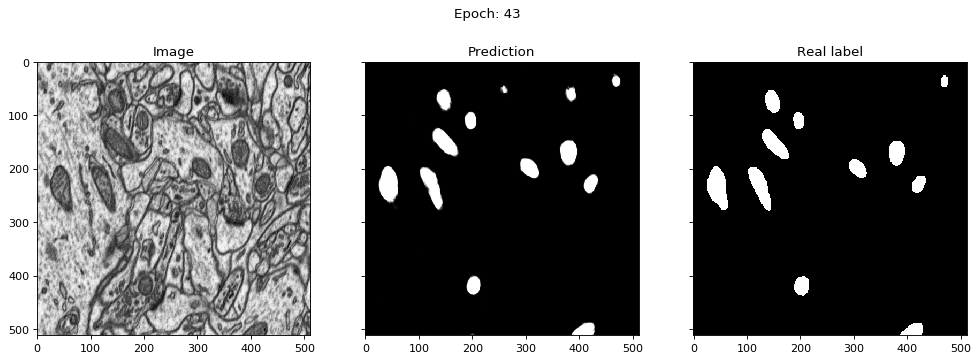

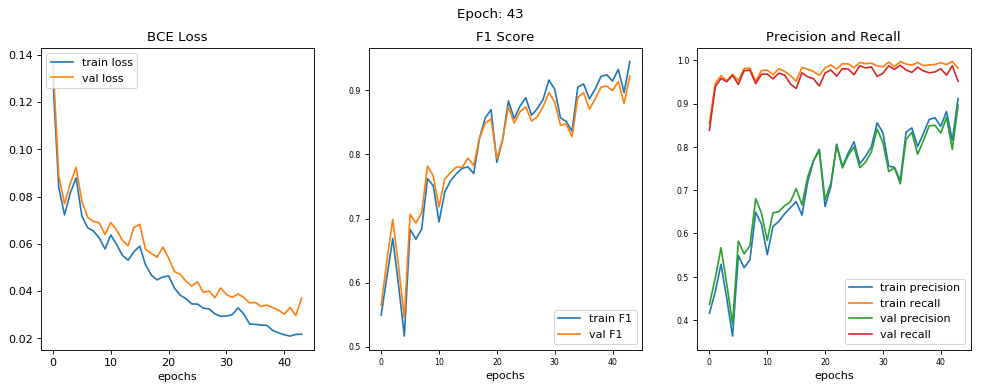

epoch [43/200] 
train loss = 0.0217, train f1 score = 0.9450 
train precision = 0.9115, train recall = 0.9815 

val loss = 0.0370, val f1 score = 0.9223 
val precision = 0.8962, val recall = 0.9513 




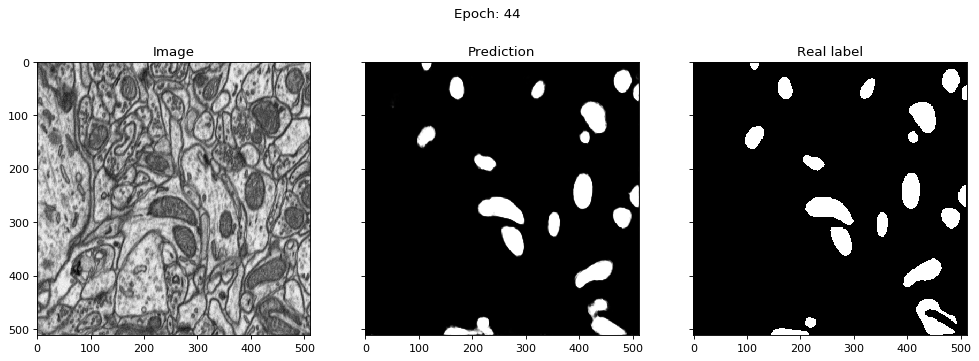

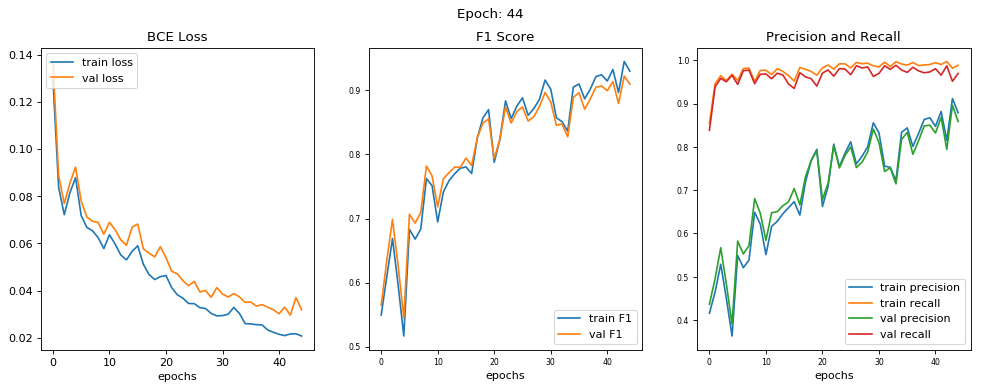

epoch [44/200] 
train loss = 0.0207, train f1 score = 0.9299 
train precision = 0.8787, train recall = 0.9884 

val loss = 0.0319, val f1 score = 0.9097 
val precision = 0.8586, val recall = 0.9693 




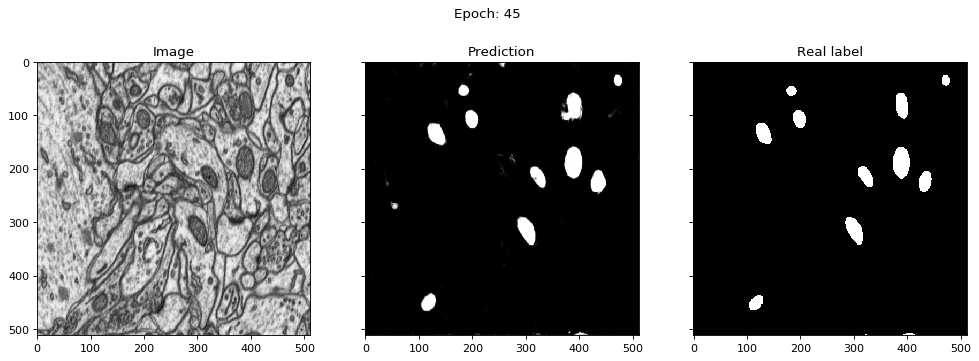

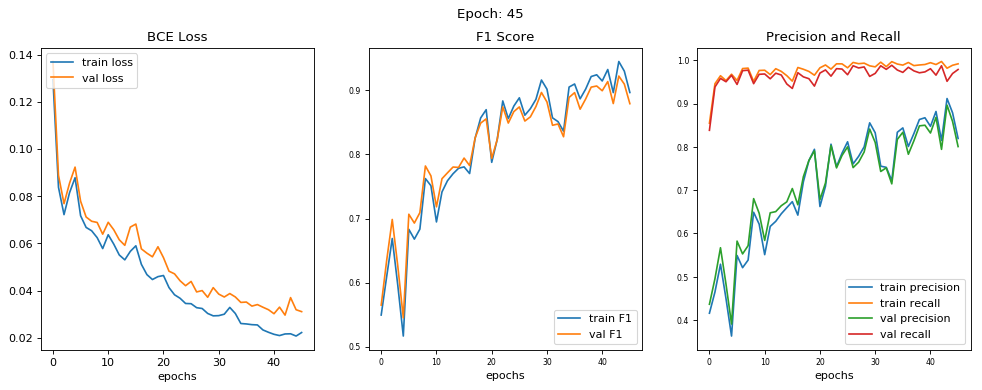

epoch [45/200] 
train loss = 0.0222, train f1 score = 0.8966 
train precision = 0.8193, train recall = 0.9917 

val loss = 0.0311, val f1 score = 0.8792 
val precision = 0.8006, val recall = 0.9786 




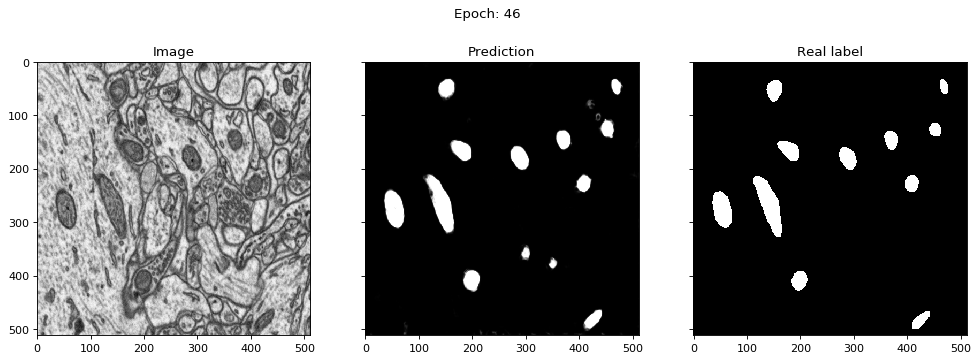

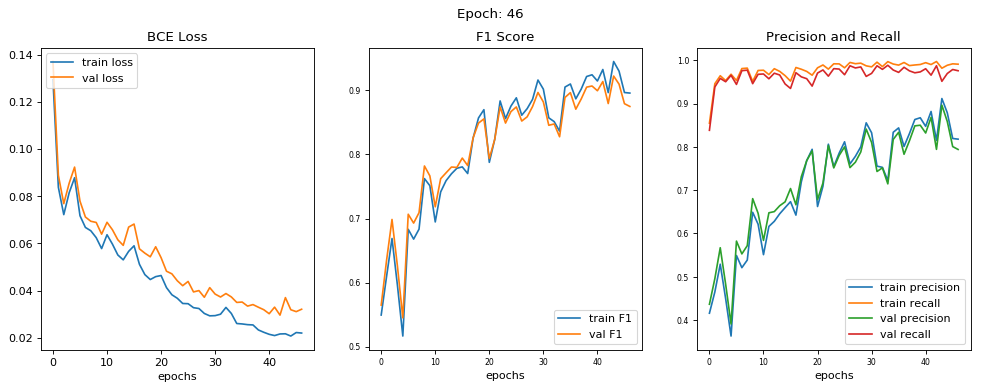

epoch [46/200] 
train loss = 0.0220, train f1 score = 0.8958 
train precision = 0.8178, train recall = 0.9908 

val loss = 0.0321, val f1 score = 0.8749 
val precision = 0.7940, val recall = 0.9757 




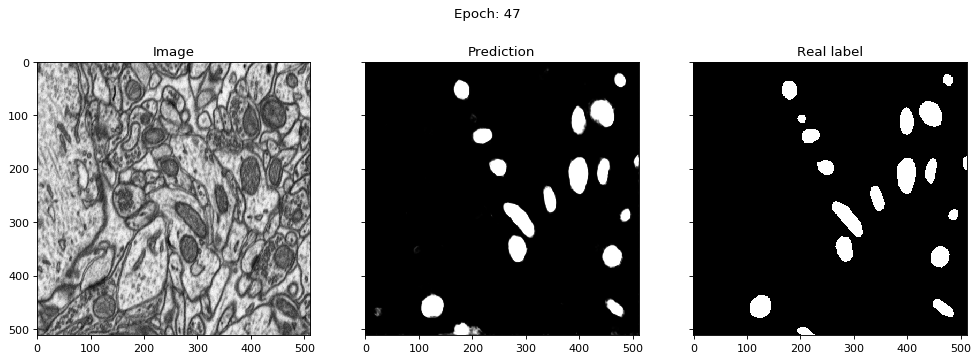

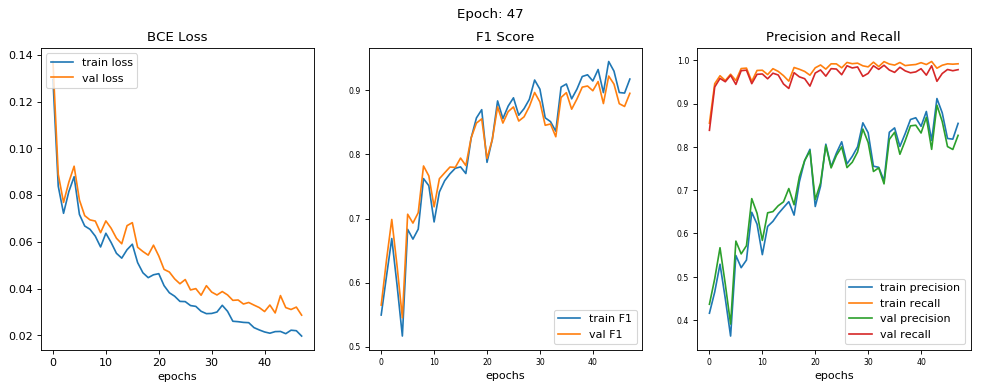

epoch [47/200] 
train loss = 0.0197, train f1 score = 0.9176 
train precision = 0.8541, train recall = 0.9918 

val loss = 0.0287, val f1 score = 0.8954 
val precision = 0.8265, val recall = 0.9782 




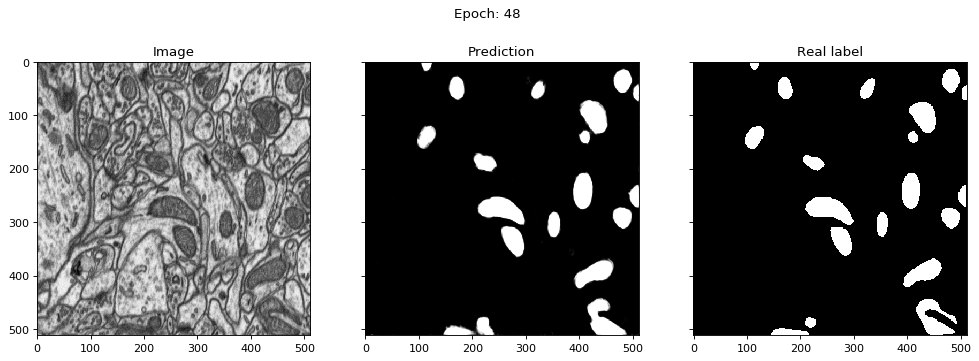

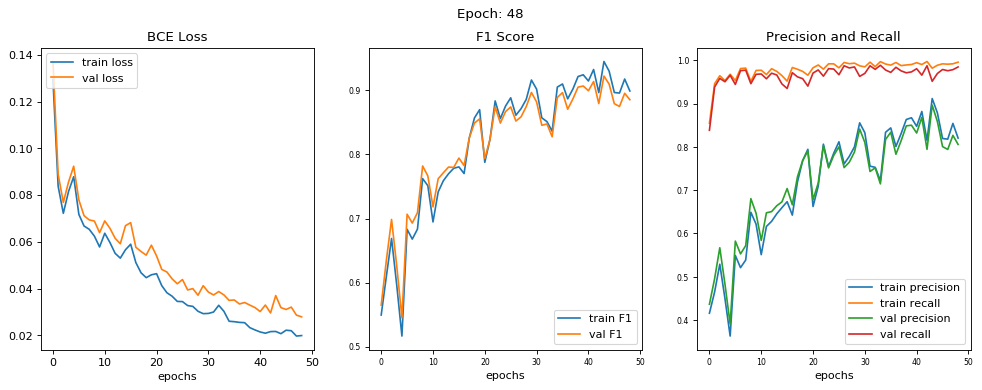

epoch [48/200] 
train loss = 0.0199, train f1 score = 0.8990 
train precision = 0.8202, train recall = 0.9955 

val loss = 0.0280, val f1 score = 0.8854 
val precision = 0.8056, val recall = 0.9845 




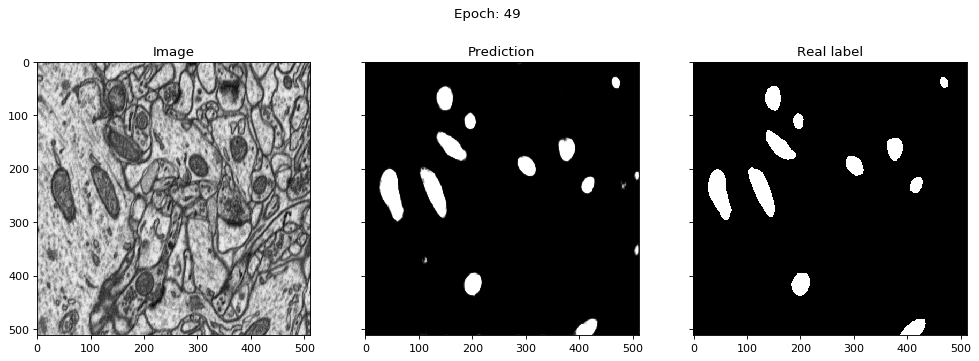

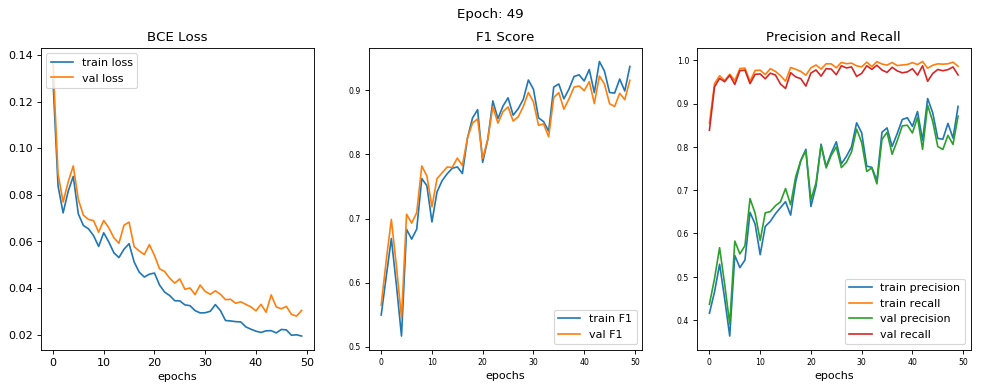

epoch [49/200] 
train loss = 0.0194, train f1 score = 0.9372 
train precision = 0.8935, train recall = 0.9859 

val loss = 0.0304, val f1 score = 0.9156 
val precision = 0.8711, val recall = 0.9660 




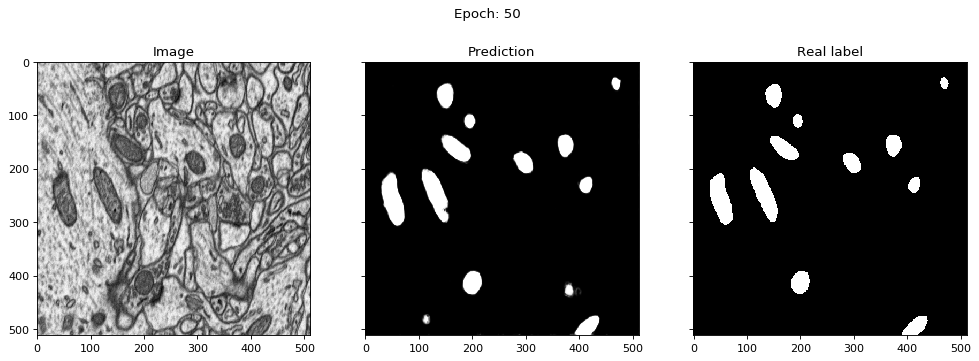

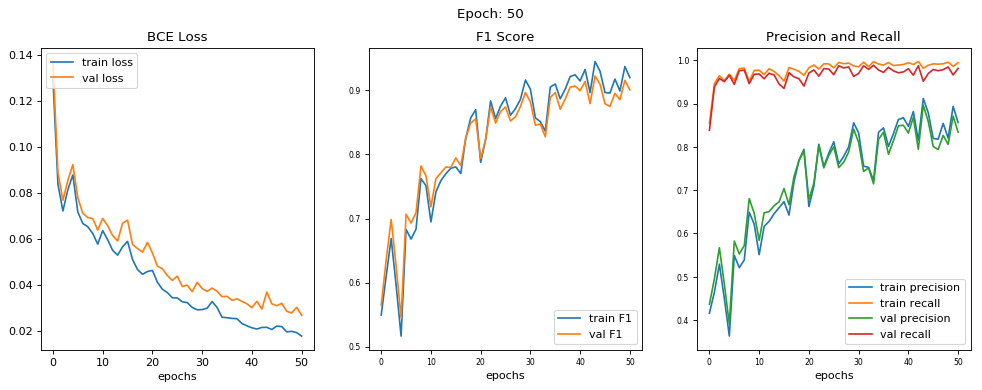

epoch [50/200] 
train loss = 0.0179, train f1 score = 0.9198 
train precision = 0.8562, train recall = 0.9943 

val loss = 0.0270, val f1 score = 0.9009 
val precision = 0.8339, val recall = 0.9811 




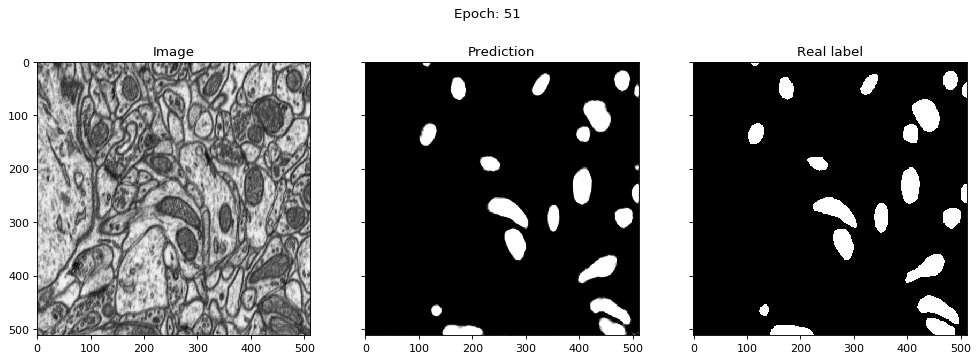

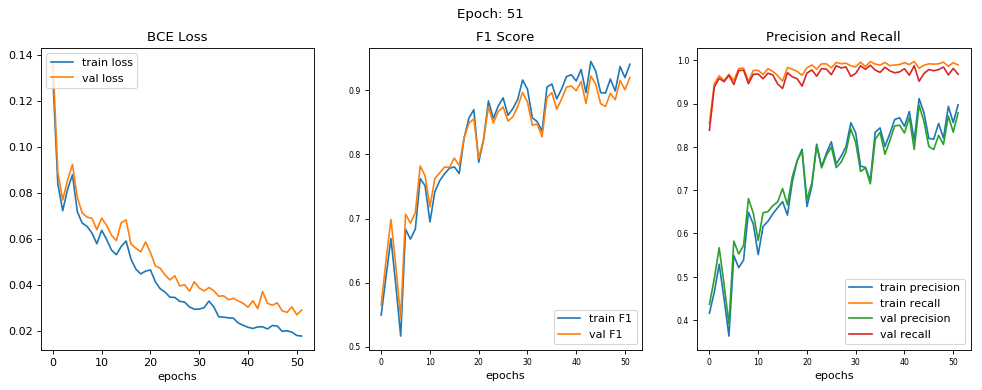

epoch [51/200] 
train loss = 0.0177, train f1 score = 0.9407 
train precision = 0.8972, train recall = 0.9891 

val loss = 0.0289, val f1 score = 0.9202 
val precision = 0.8782, val recall = 0.9677 




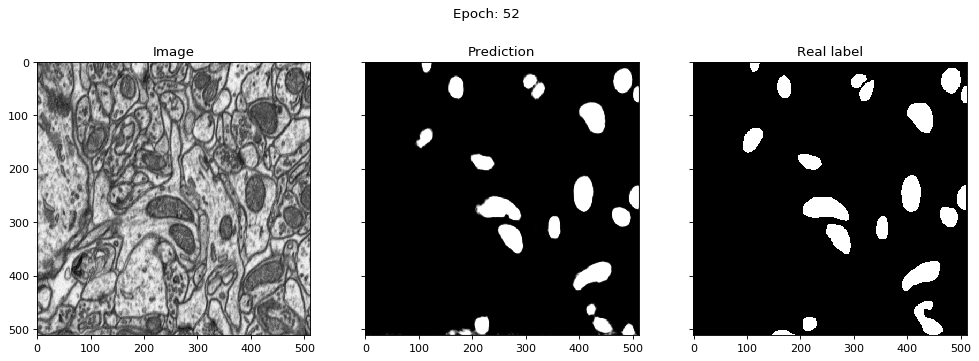

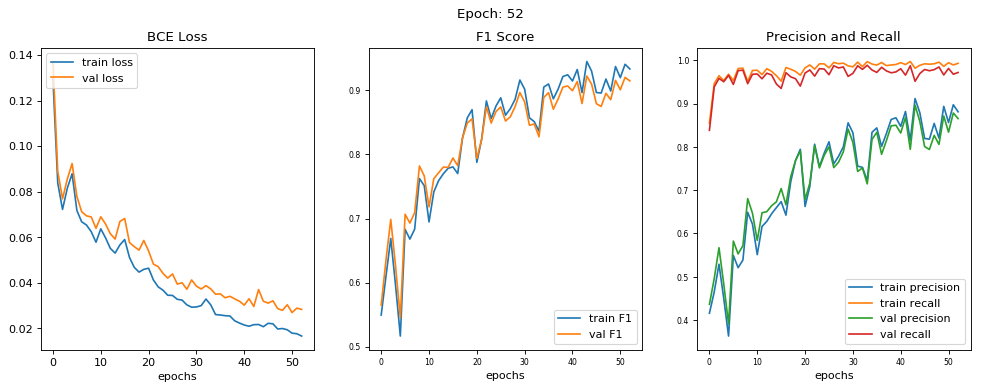

epoch [52/200] 
train loss = 0.0166, train f1 score = 0.9333 
train precision = 0.8810, train recall = 0.9928 

val loss = 0.0283, val f1 score = 0.9148 
val precision = 0.8653, val recall = 0.9716 




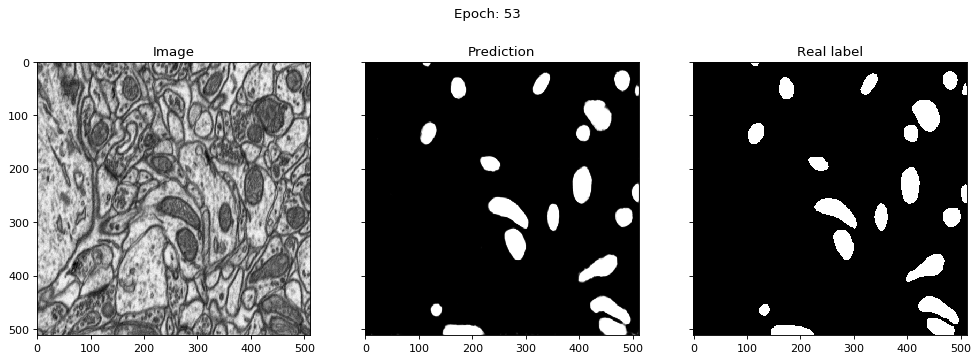

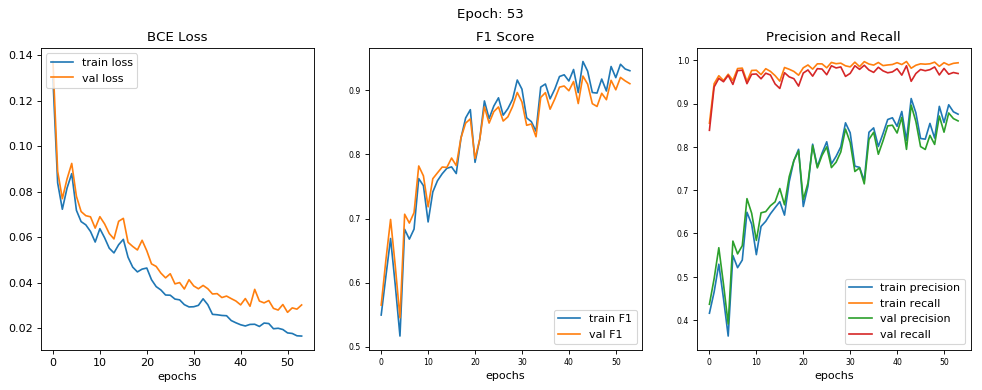

epoch [53/200] 
train loss = 0.0165, train f1 score = 0.9306 
train precision = 0.8754, train recall = 0.9941 

val loss = 0.0302, val f1 score = 0.9104 
val precision = 0.8599, val recall = 0.9693 




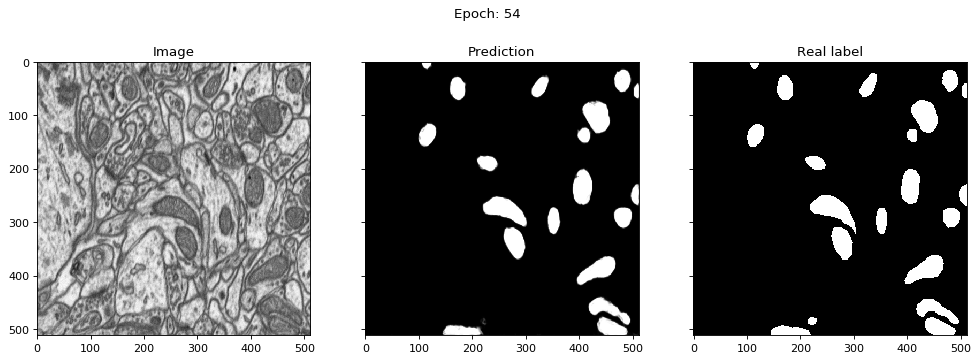

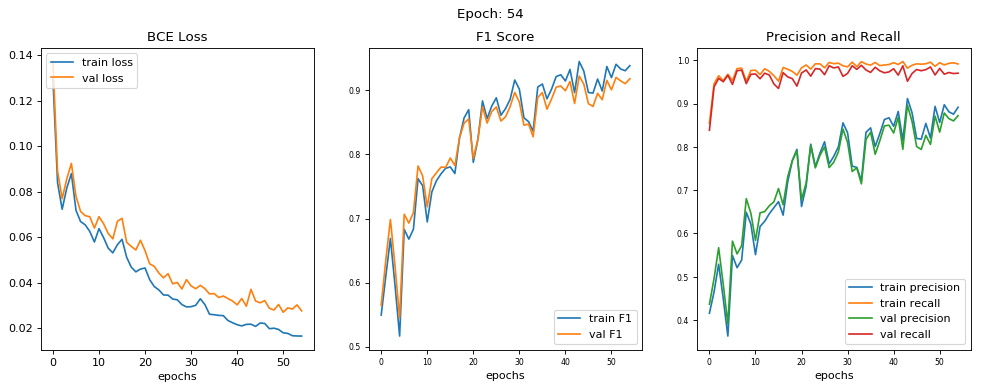

epoch [54/200] 
train loss = 0.0165, train f1 score = 0.9386 
train precision = 0.8914, train recall = 0.9914 

val loss = 0.0276, val f1 score = 0.9181 
val precision = 0.8720, val recall = 0.9701 




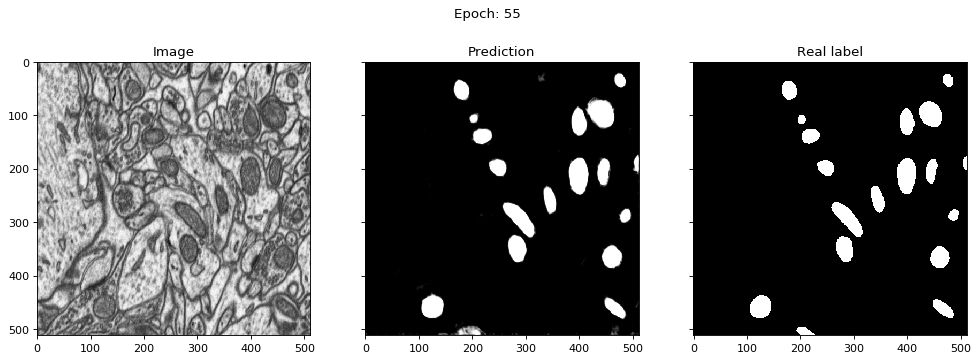

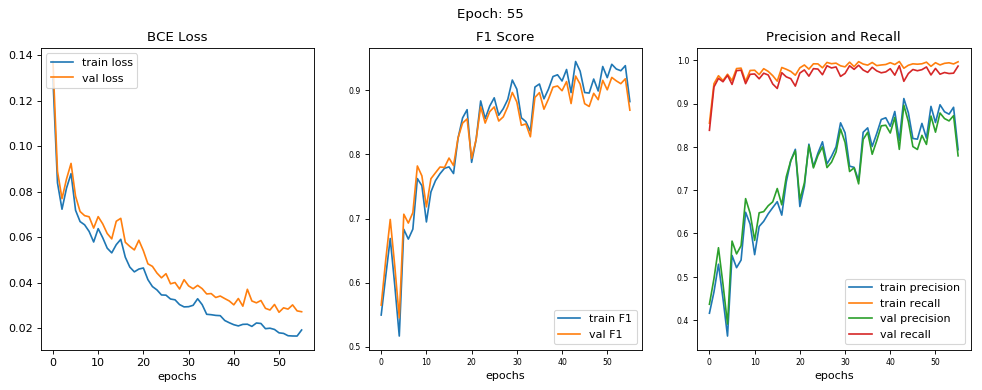

epoch [55/200] 
train loss = 0.0192, train f1 score = 0.8825 
train precision = 0.7935, train recall = 0.9964 

val loss = 0.0272, val f1 score = 0.8691 
val precision = 0.7793, val recall = 0.9865 




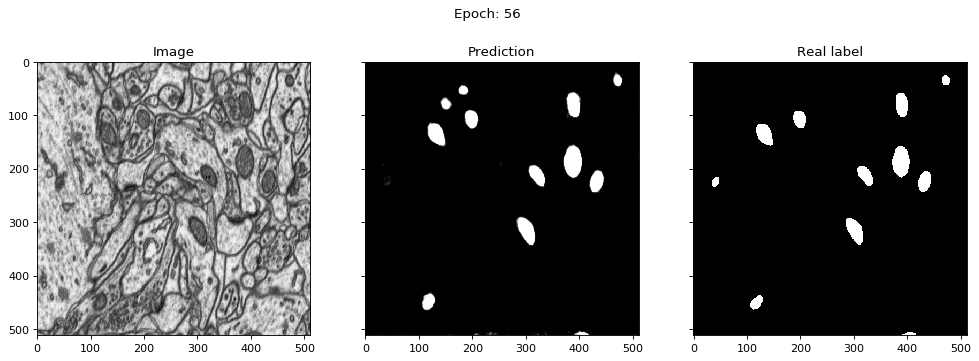

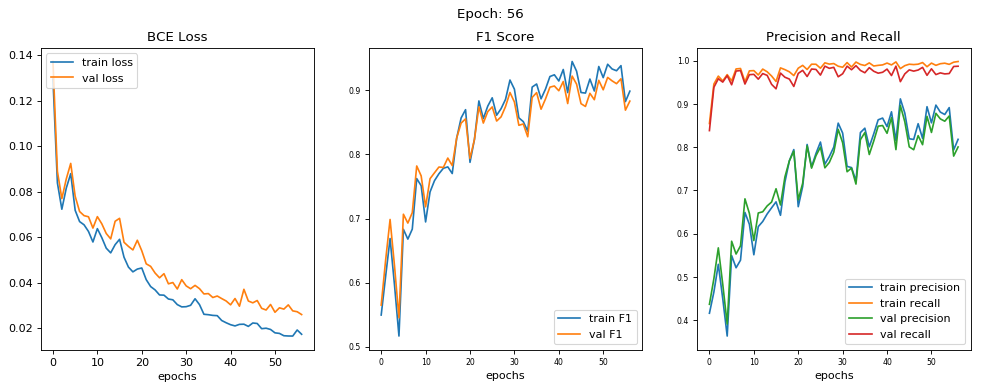

epoch [56/200] 
train loss = 0.0173, train f1 score = 0.8988 
train precision = 0.8180, train recall = 0.9980 

val loss = 0.0259, val f1 score = 0.8832 
val precision = 0.8004, val recall = 0.9871 




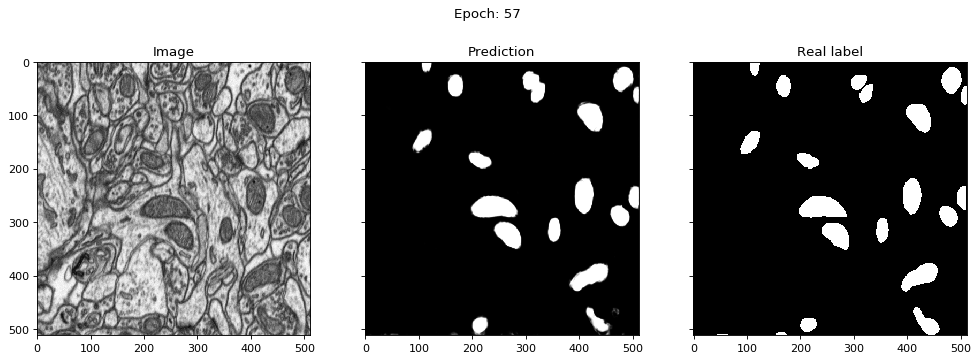

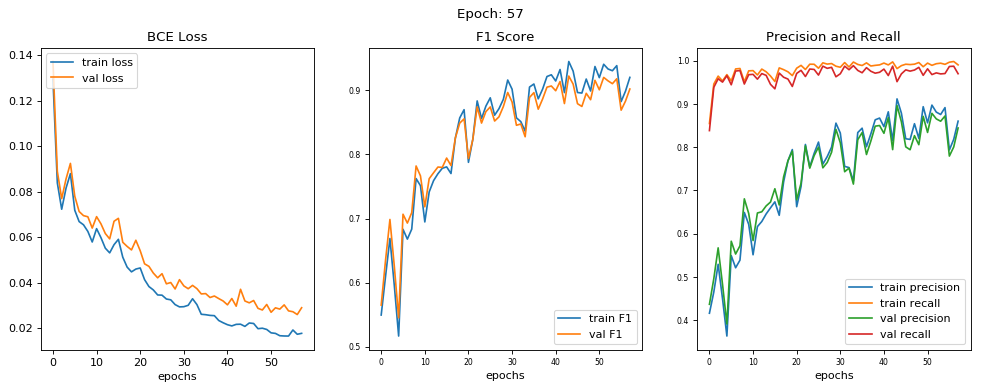

epoch [57/200] 
train loss = 0.0177, train f1 score = 0.9203 
train precision = 0.8601, train recall = 0.9901 

val loss = 0.0290, val f1 score = 0.9021 
val precision = 0.8443, val recall = 0.9698 




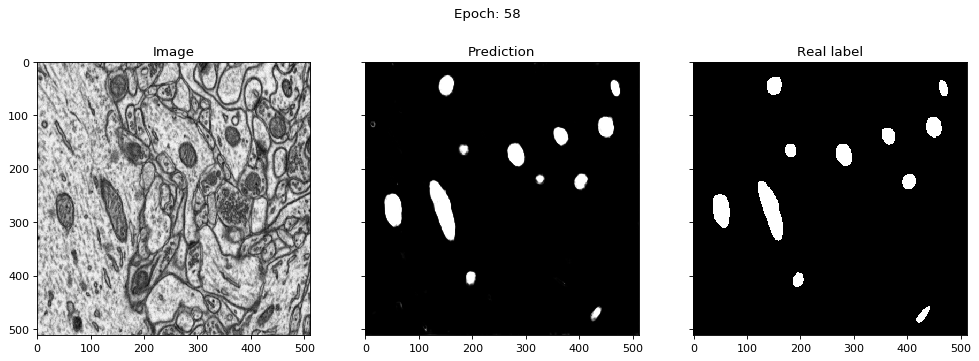

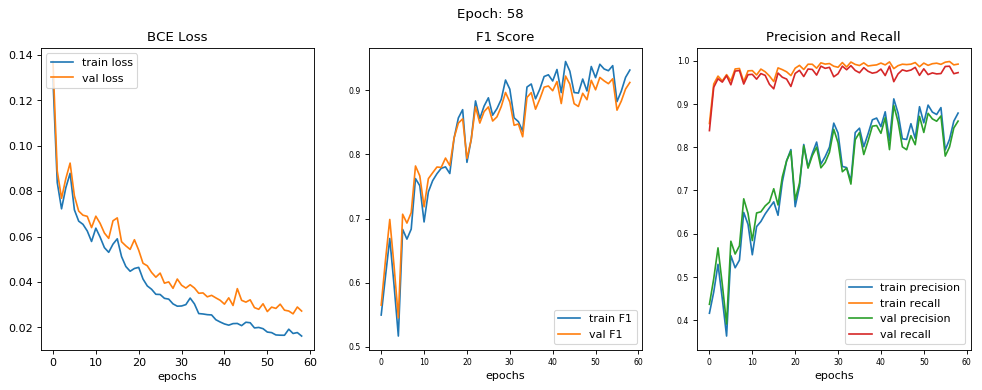

epoch [58/200] 
train loss = 0.0162, train f1 score = 0.9317 
train precision = 0.8787, train recall = 0.9919 

val loss = 0.0272, val f1 score = 0.9123 
val precision = 0.8602, val recall = 0.9722 




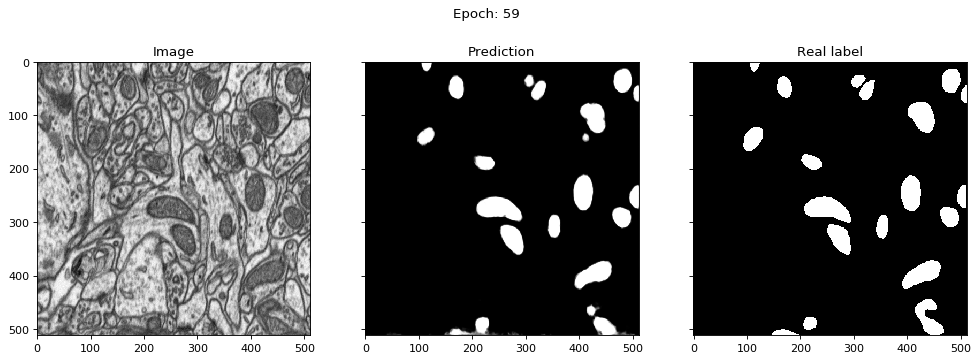

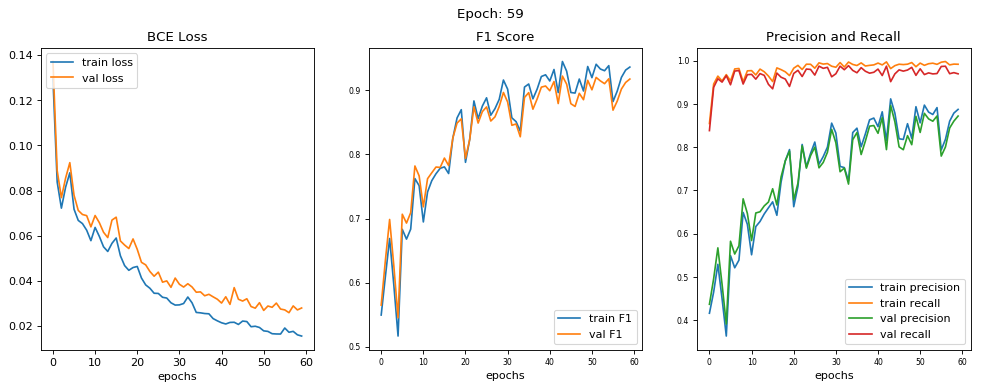

epoch [59/200] 
train loss = 0.0156, train f1 score = 0.9363 
train precision = 0.8873, train recall = 0.9916 

val loss = 0.0280, val f1 score = 0.9177 
val precision = 0.8718, val recall = 0.9695 




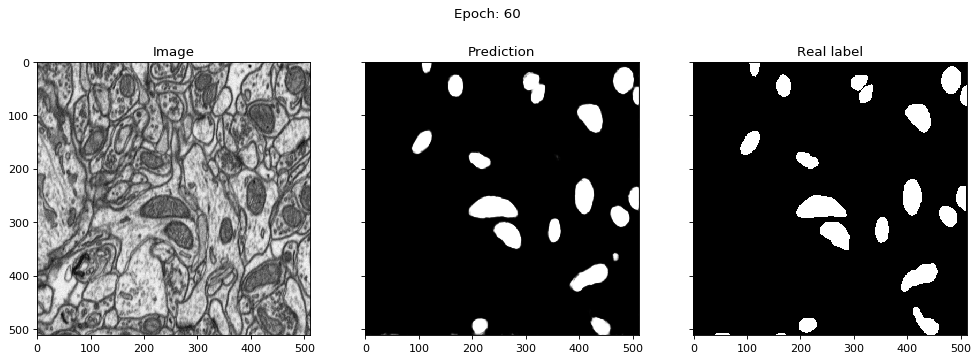

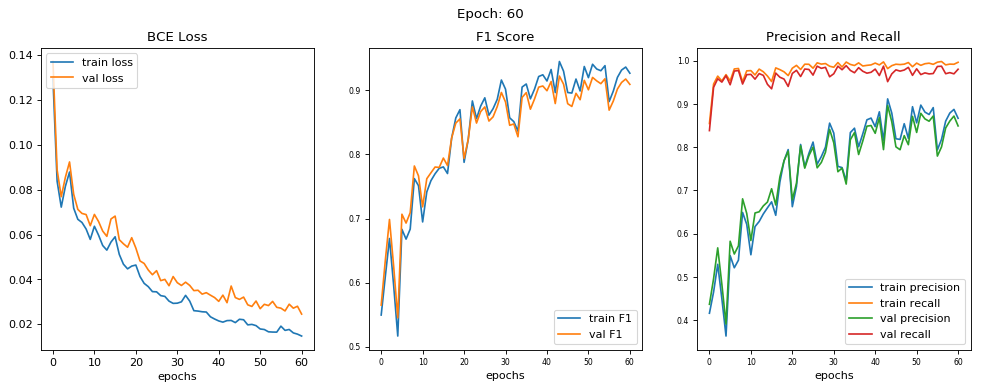

epoch [60/200] 
train loss = 0.0147, train f1 score = 0.9267 
train precision = 0.8667, train recall = 0.9961 

val loss = 0.0245, val f1 score = 0.9093 
val precision = 0.8490, val recall = 0.9801 




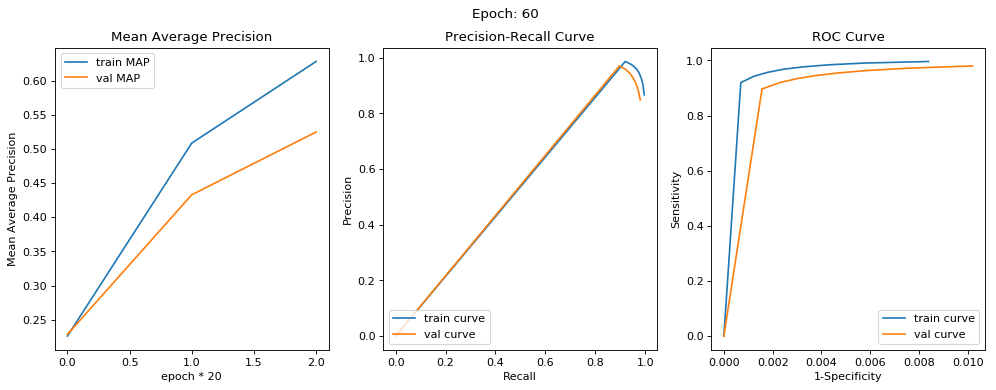

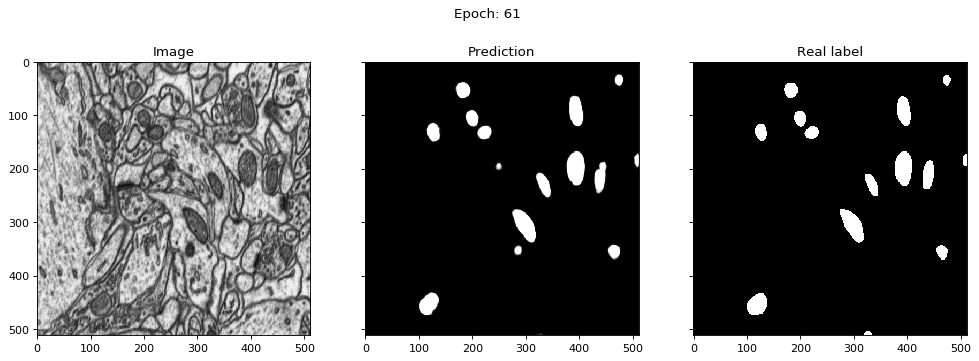

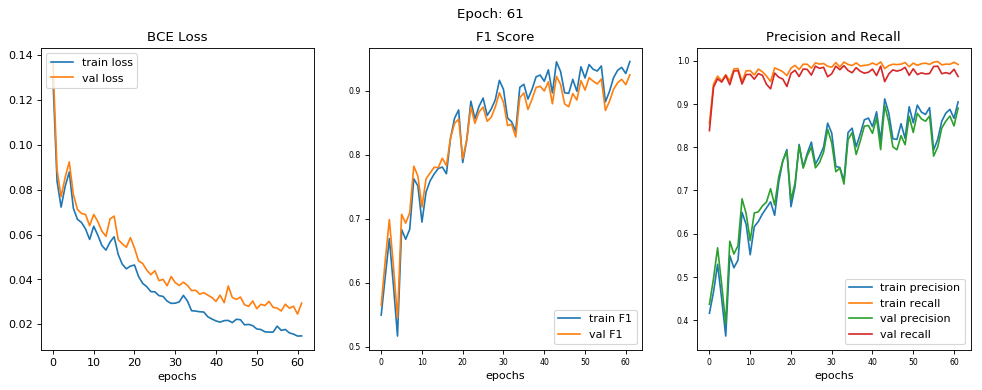

epoch [61/200] 
train loss = 0.0148, train f1 score = 0.9455 
train precision = 0.9044, train recall = 0.9910 

val loss = 0.0295, val f1 score = 0.9247 
val precision = 0.8903, val recall = 0.9635 




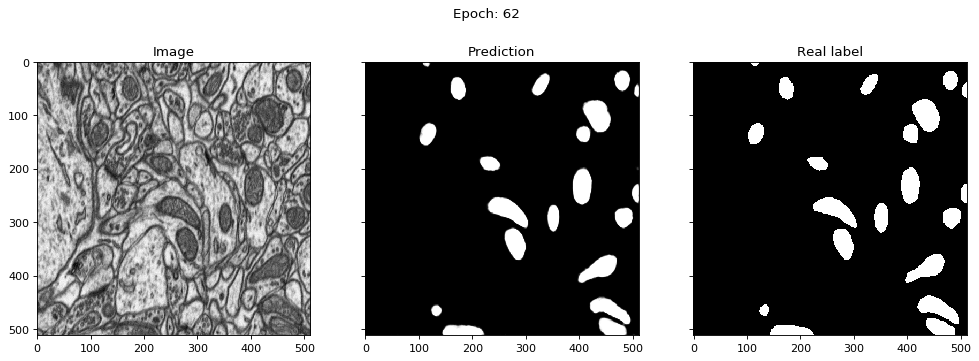

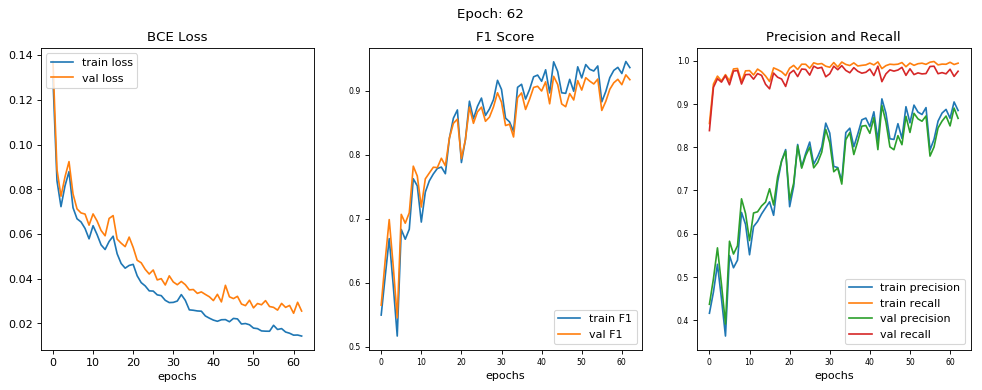

epoch [62/200] 
train loss = 0.0143, train f1 score = 0.9360 
train precision = 0.8847, train recall = 0.9941 

val loss = 0.0255, val f1 score = 0.9171 
val precision = 0.8665, val recall = 0.9754 




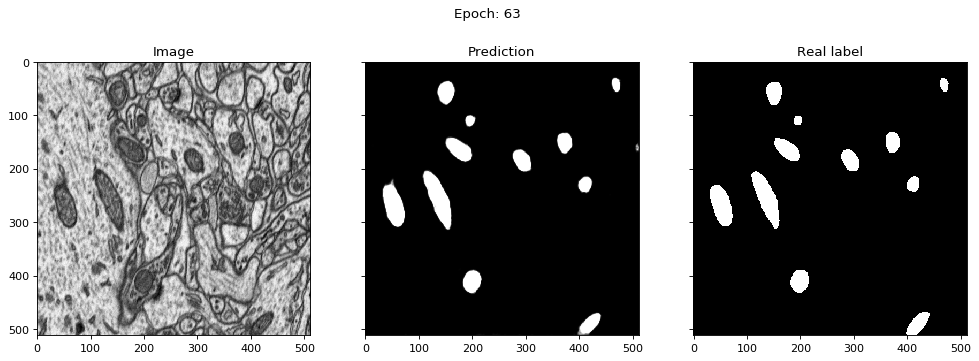

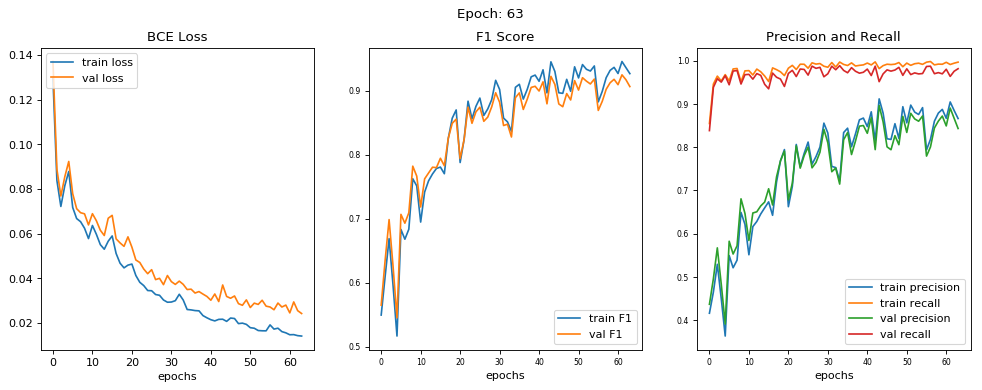

epoch [63/200] 
train loss = 0.0142, train f1 score = 0.9265 
train precision = 0.8661, train recall = 0.9965 

val loss = 0.0243, val f1 score = 0.9063 
val precision = 0.8431, val recall = 0.9813 




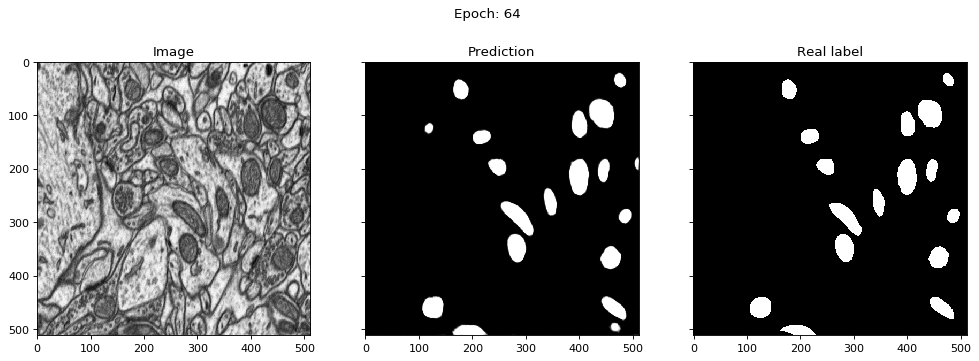

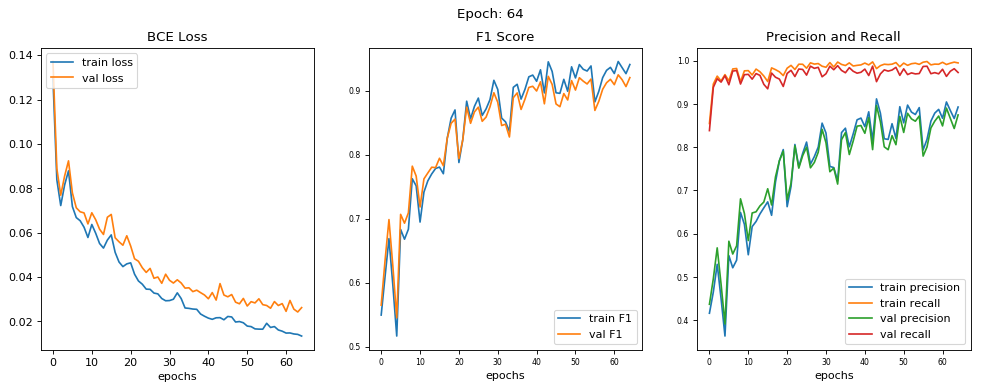

epoch [64/200] 
train loss = 0.0134, train f1 score = 0.9408 
train precision = 0.8927, train recall = 0.9947 

val loss = 0.0262, val f1 score = 0.9204 
val precision = 0.8744, val recall = 0.9726 




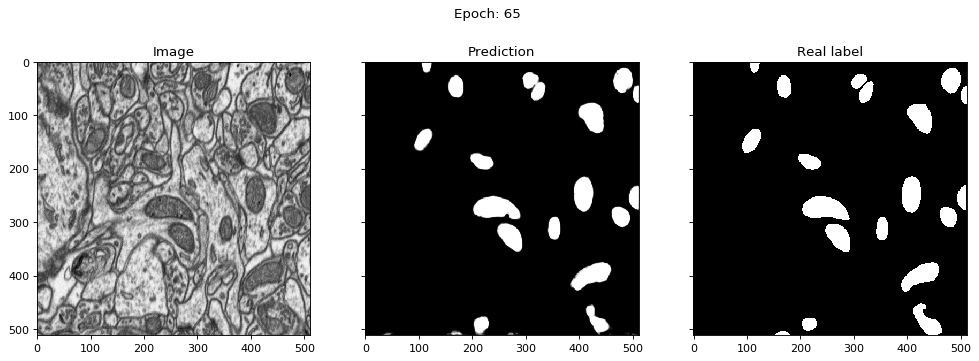

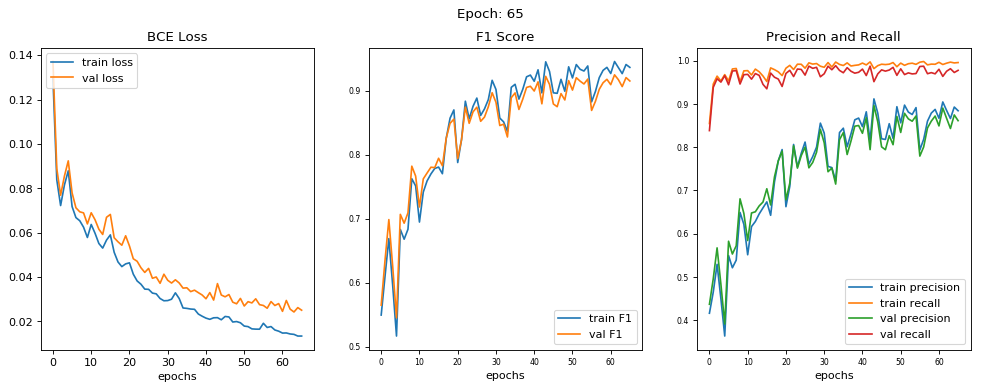

epoch [65/200] 
train loss = 0.0134, train f1 score = 0.9363 
train precision = 0.8841, train recall = 0.9955 

val loss = 0.0251, val f1 score = 0.9151 
val precision = 0.8612, val recall = 0.9775 




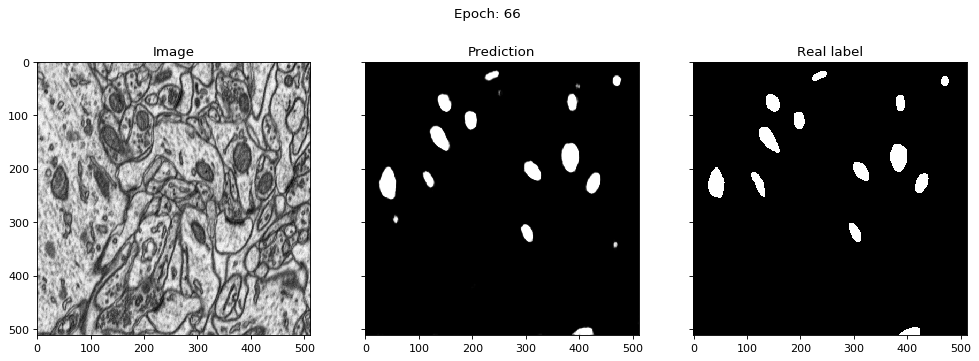

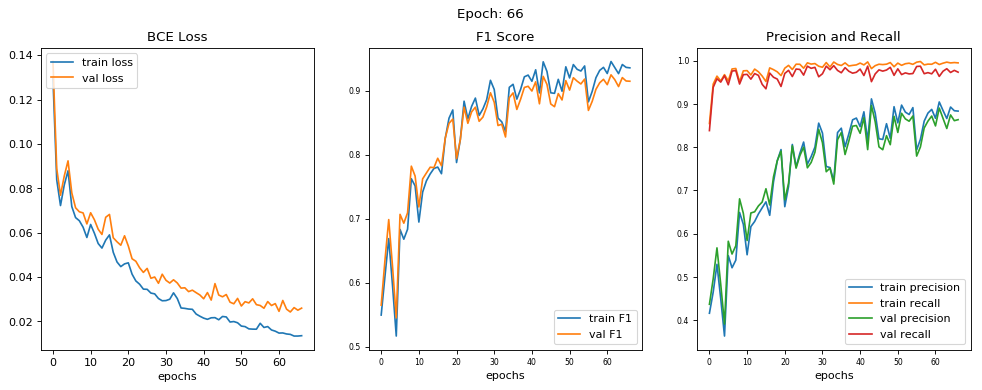

epoch [66/200] 
train loss = 0.0136, train f1 score = 0.9356 
train precision = 0.8833, train recall = 0.9948 

val loss = 0.0260, val f1 score = 0.9147 
val precision = 0.8635, val recall = 0.9733 




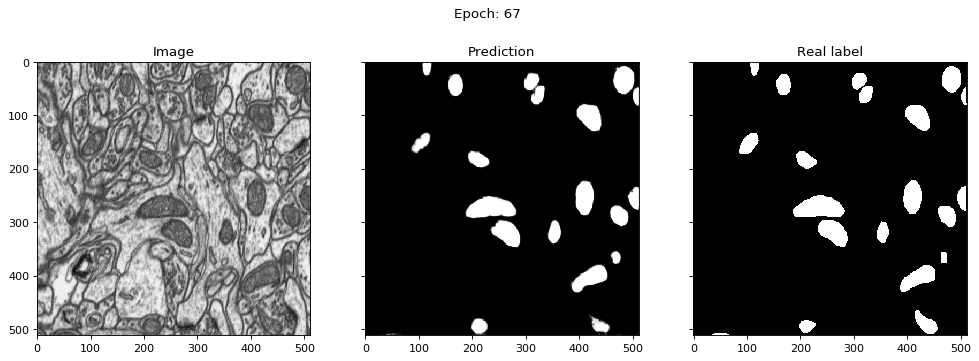

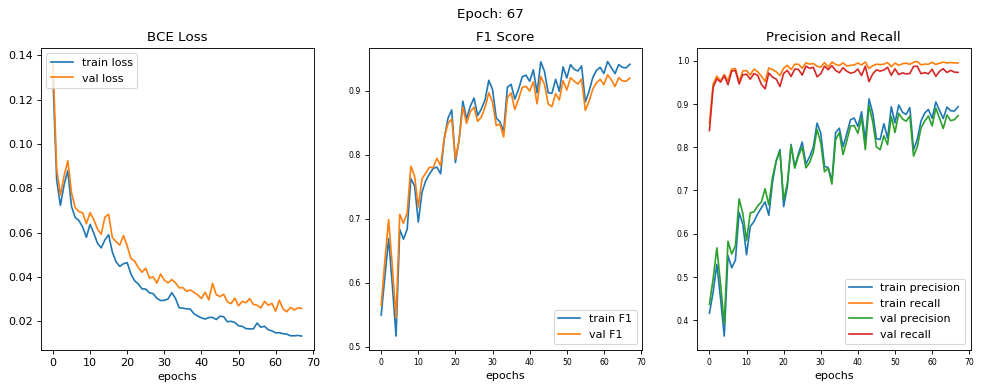

epoch [67/200] 
train loss = 0.0133, train f1 score = 0.9411 
train precision = 0.8934, train recall = 0.9946 

val loss = 0.0258, val f1 score = 0.9195 
val precision = 0.8728, val recall = 0.9728 




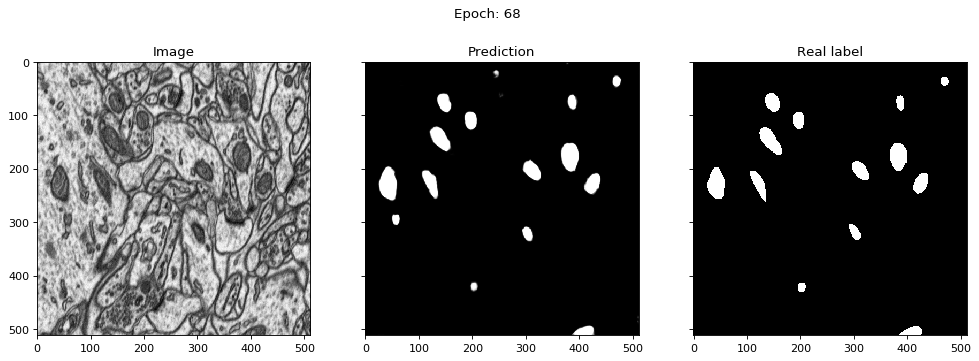

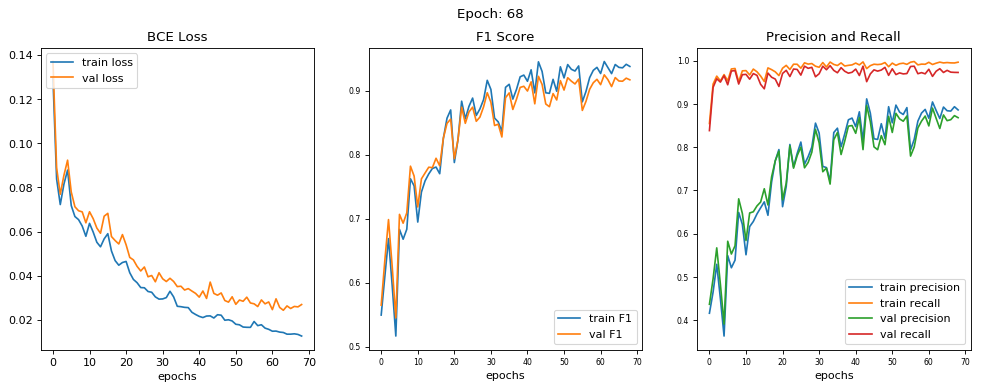

epoch [68/200] 
train loss = 0.0126, train f1 score = 0.9378 
train precision = 0.8860, train recall = 0.9963 

val loss = 0.0269, val f1 score = 0.9169 
val precision = 0.8681, val recall = 0.9726 




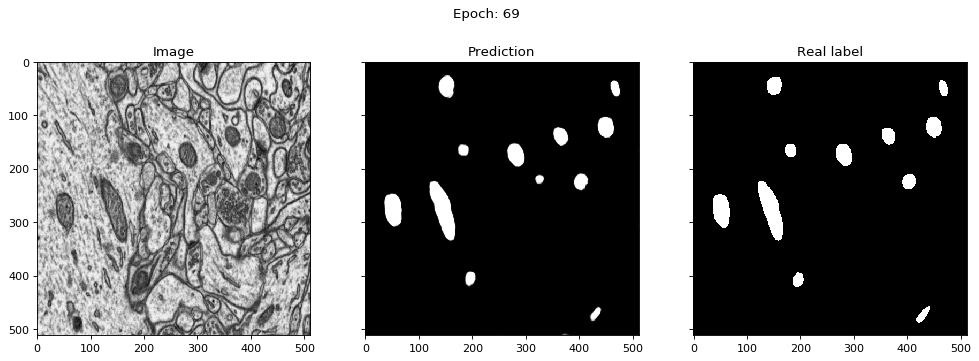

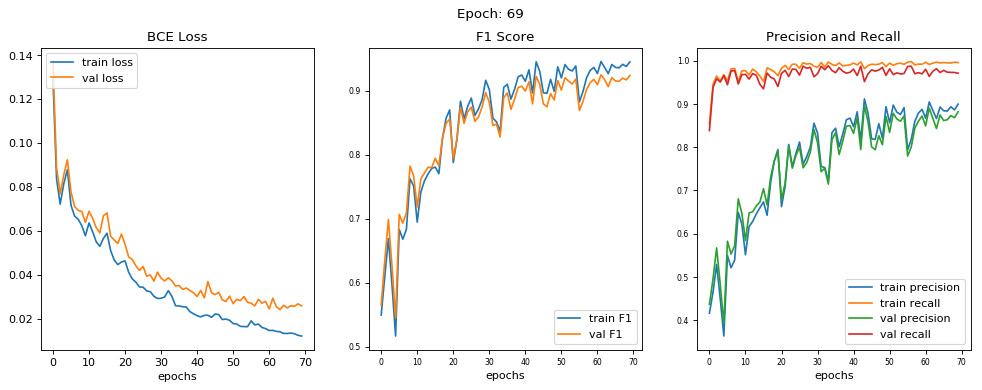

epoch [69/200] 
train loss = 0.0122, train f1 score = 0.9449 
train precision = 0.8995, train recall = 0.9954 

val loss = 0.0259, val f1 score = 0.9237 
val precision = 0.8817, val recall = 0.9709 




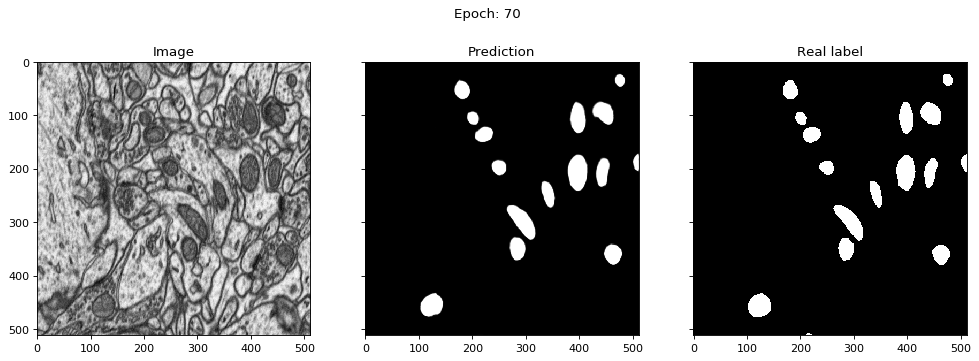

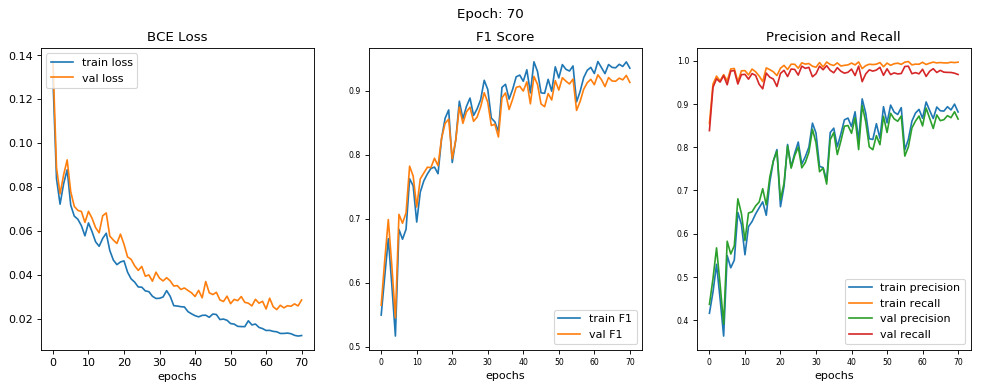

epoch [70/200] 
train loss = 0.0125, train f1 score = 0.9351 
train precision = 0.8812, train recall = 0.9965 

val loss = 0.0286, val f1 score = 0.9128 
val precision = 0.8649, val recall = 0.9679 




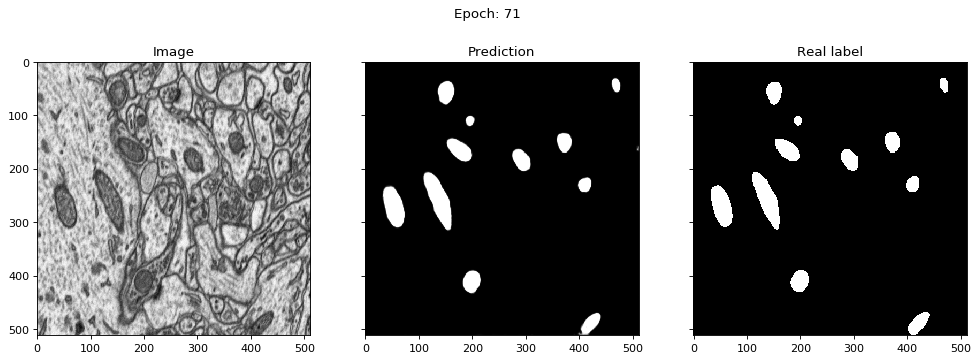

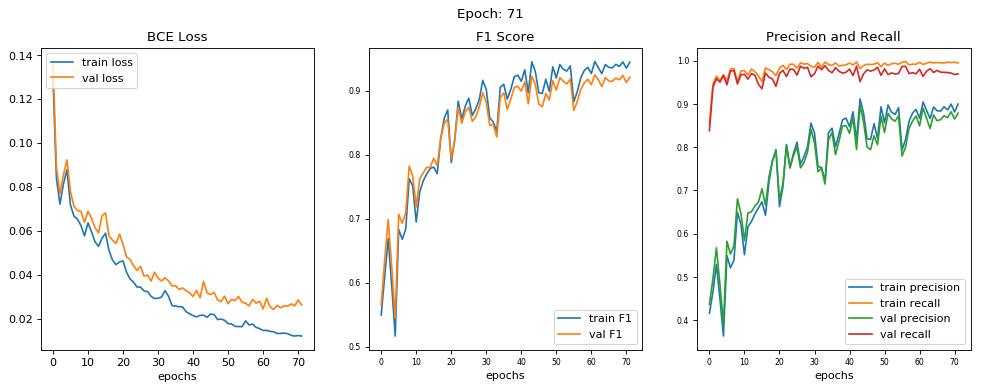

epoch [71/200] 
train loss = 0.0122, train f1 score = 0.9445 
train precision = 0.8996, train recall = 0.9945 

val loss = 0.0264, val f1 score = 0.9212 
val precision = 0.8786, val recall = 0.9694 




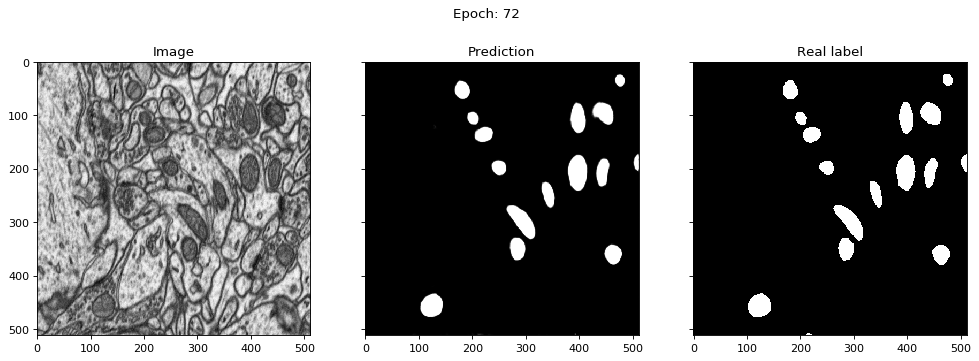

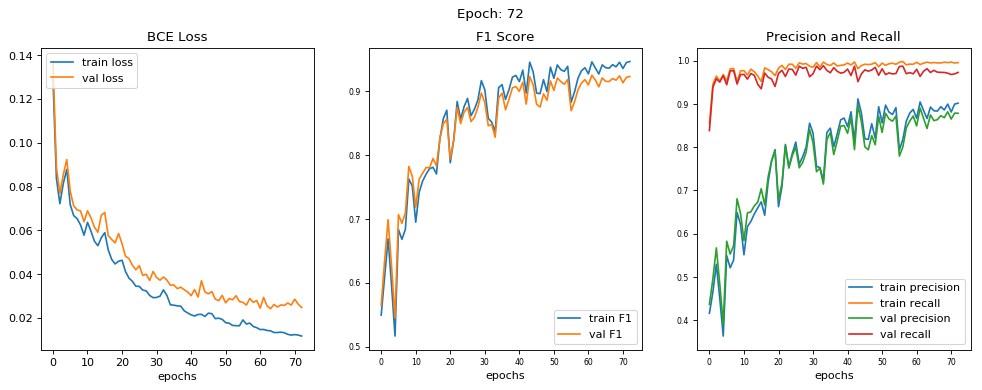

epoch [72/200] 
train loss = 0.0118, train f1 score = 0.9461 
train precision = 0.9016, train recall = 0.9954 

val loss = 0.0248, val f1 score = 0.9226 
val precision = 0.8783, val recall = 0.9727 




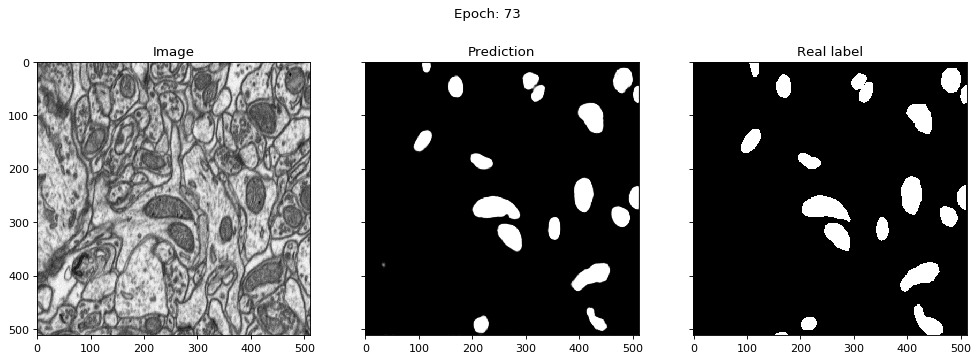

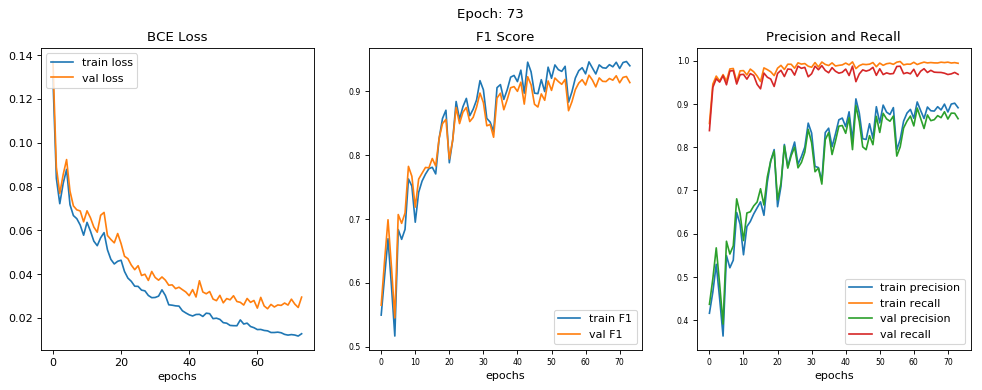

epoch [73/200] 
train loss = 0.0128, train f1 score = 0.9394 
train precision = 0.8911, train recall = 0.9939 

val loss = 0.0296, val f1 score = 0.9131 
val precision = 0.8657, val recall = 0.9683 




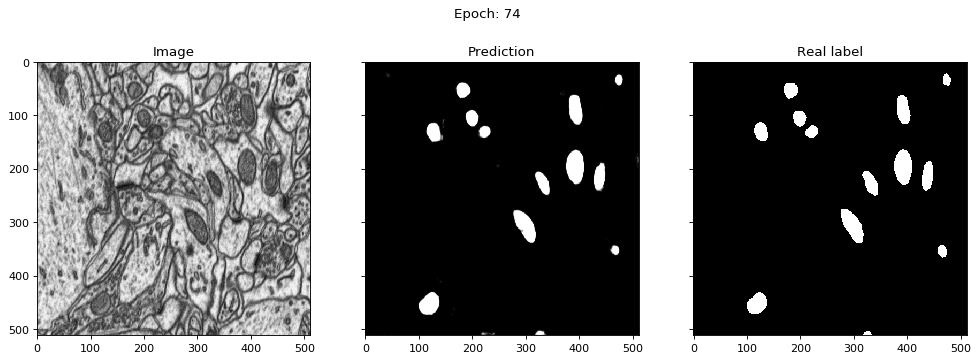

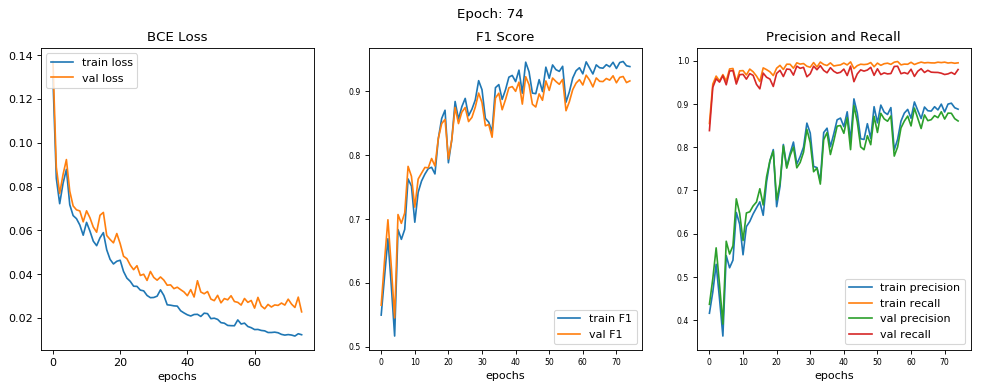

epoch [74/200] 
train loss = 0.0124, train f1 score = 0.9381 
train precision = 0.8877, train recall = 0.9949 

val loss = 0.0228, val f1 score = 0.9157 
val precision = 0.8605, val recall = 0.9794 




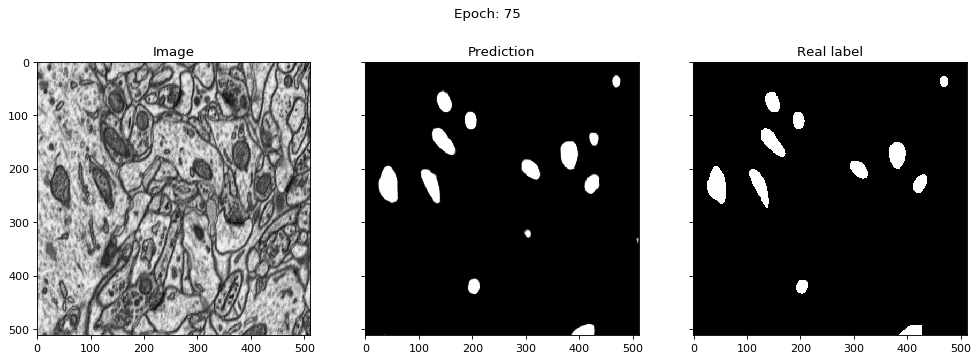

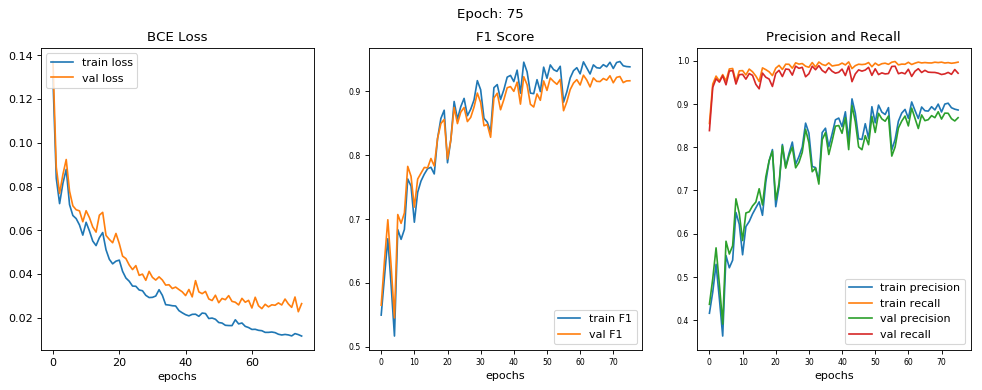

epoch [75/200] 
train loss = 0.0117, train f1 score = 0.9377 
train precision = 0.8858, train recall = 0.9965 

val loss = 0.0265, val f1 score = 0.9159 
val precision = 0.8680, val recall = 0.9709 




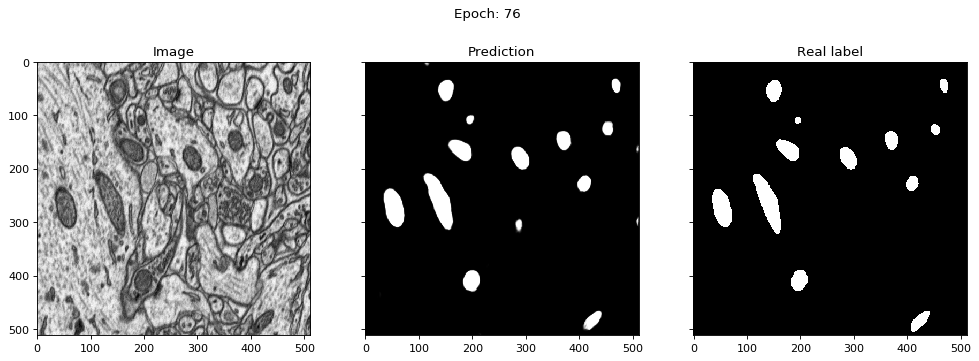

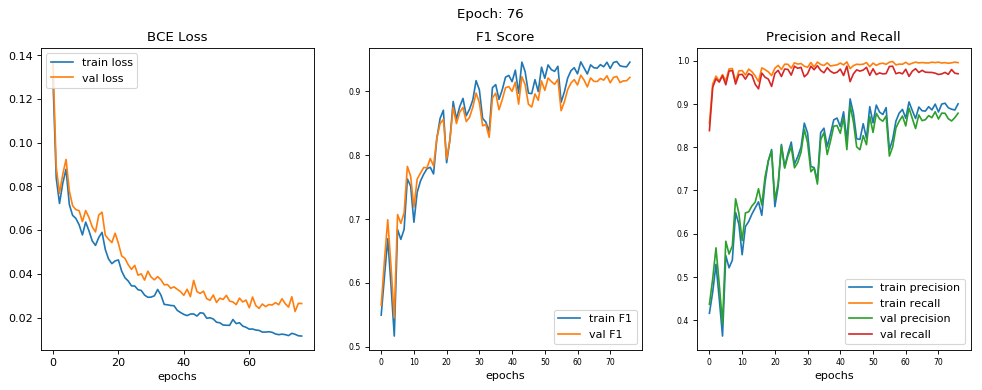

epoch [76/200] 
train loss = 0.0116, train f1 score = 0.9450 
train precision = 0.9000, train recall = 0.9953 

val loss = 0.0265, val f1 score = 0.9212 
val precision = 0.8785, val recall = 0.9696 




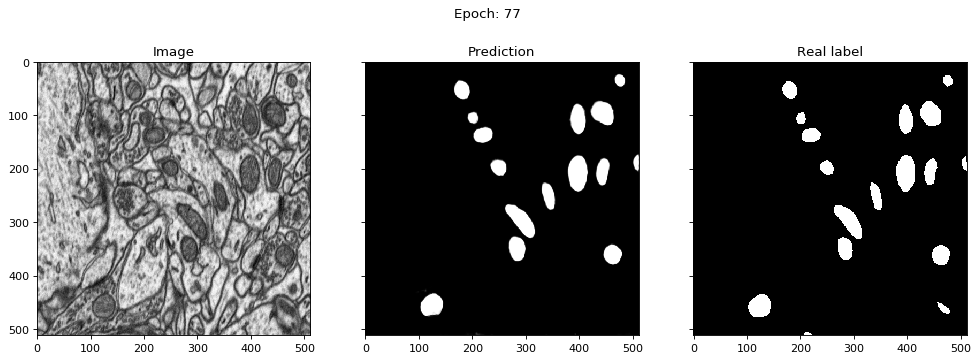

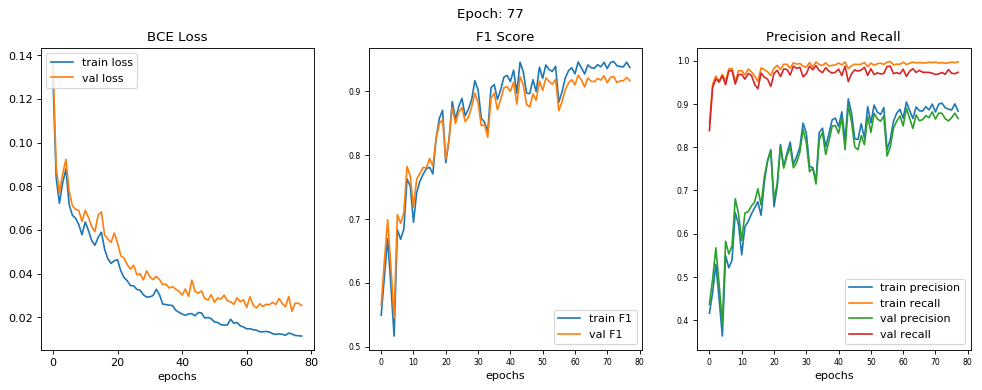

epoch [77/200] 
train loss = 0.0115, train f1 score = 0.9366 
train precision = 0.8832, train recall = 0.9971 

val loss = 0.0255, val f1 score = 0.9161 
val precision = 0.8663, val recall = 0.9731 




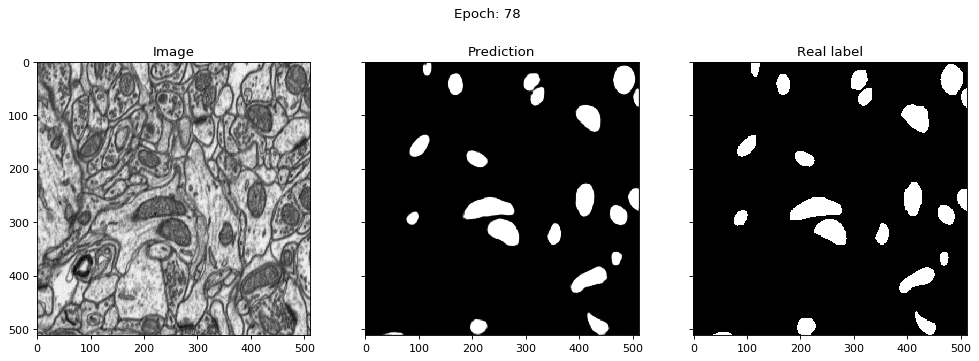

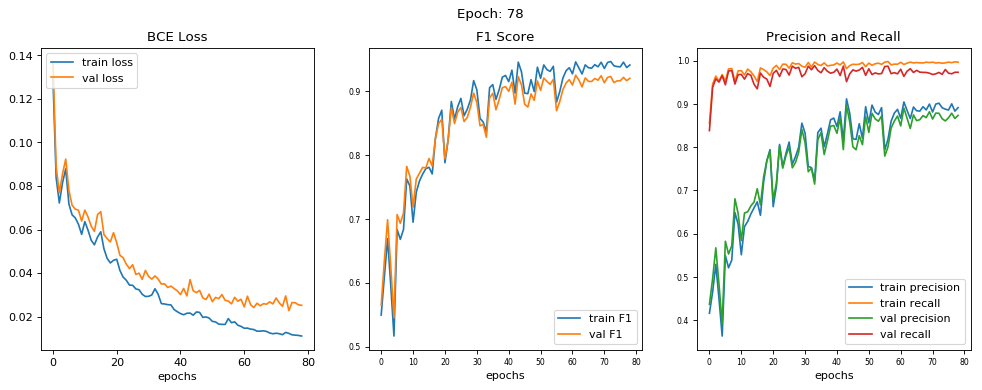

epoch [78/200] 
train loss = 0.0112, train f1 score = 0.9407 
train precision = 0.8913, train recall = 0.9963 

val loss = 0.0253, val f1 score = 0.9198 
val precision = 0.8733, val recall = 0.9730 




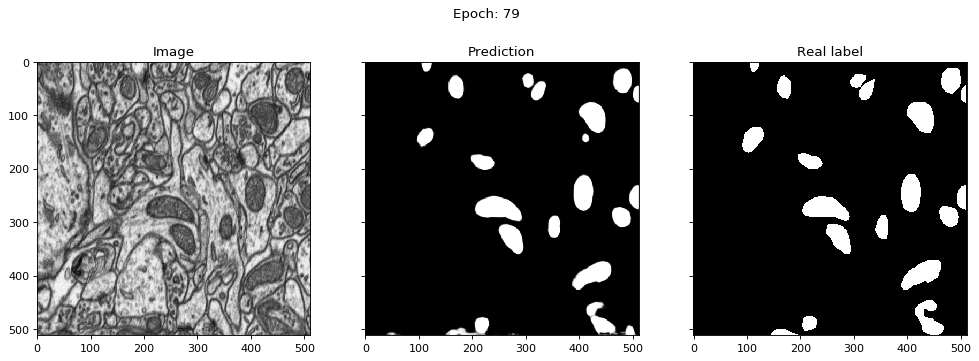

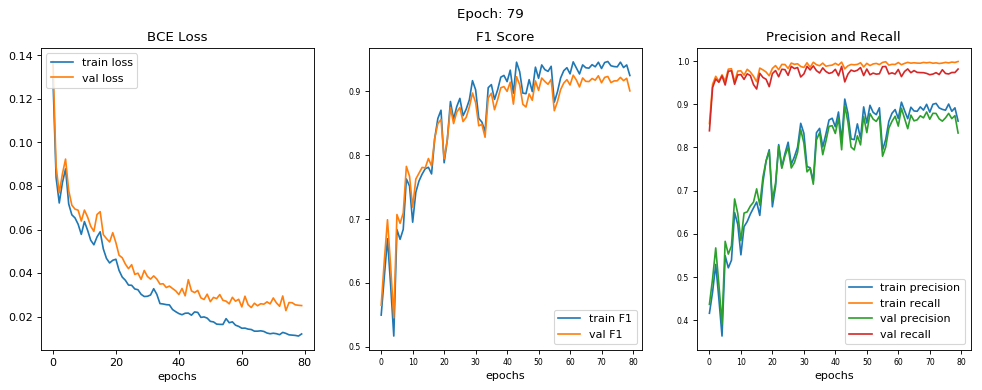

epoch [79/200] 
train loss = 0.0121, train f1 score = 0.9241 
train precision = 0.8606, train recall = 0.9985 

val loss = 0.0252, val f1 score = 0.9001 
val precision = 0.8330, val recall = 0.9810 




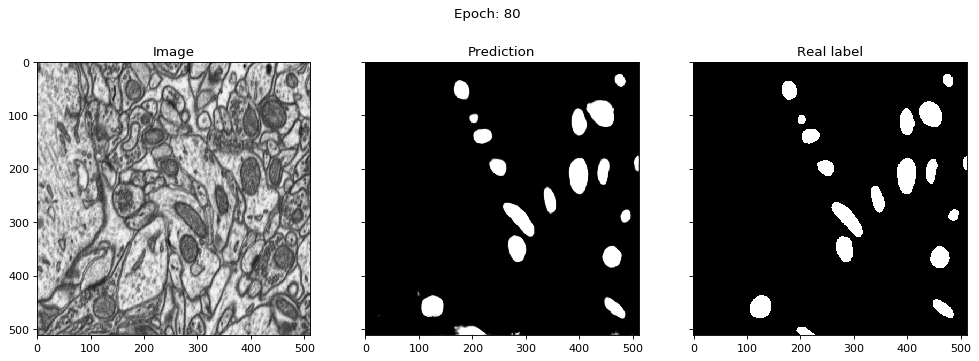

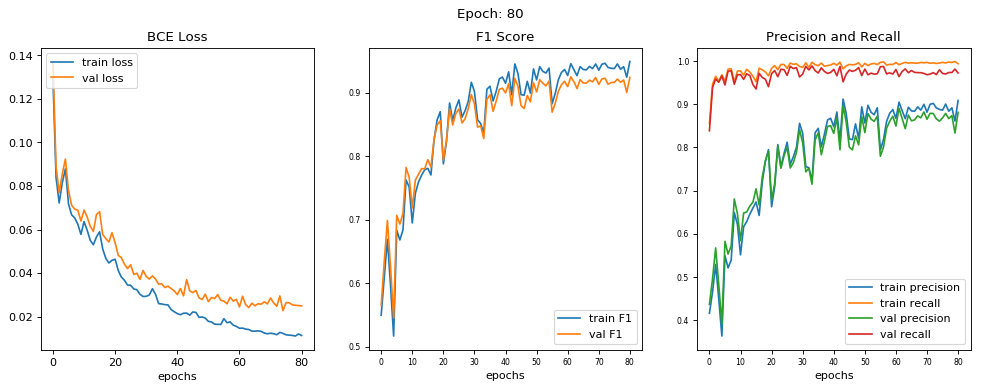

epoch [80/200] 
train loss = 0.0114, train f1 score = 0.9488 
train precision = 0.9084, train recall = 0.9932 

val loss = 0.0250, val f1 score = 0.9237 
val precision = 0.8808, val recall = 0.9719 




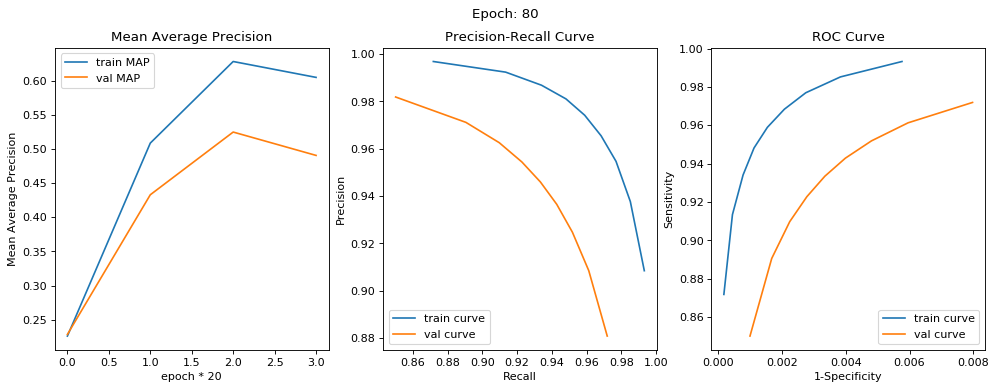

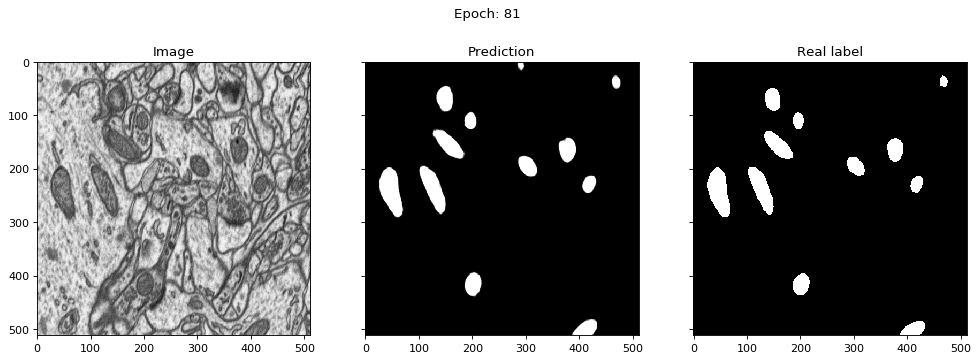

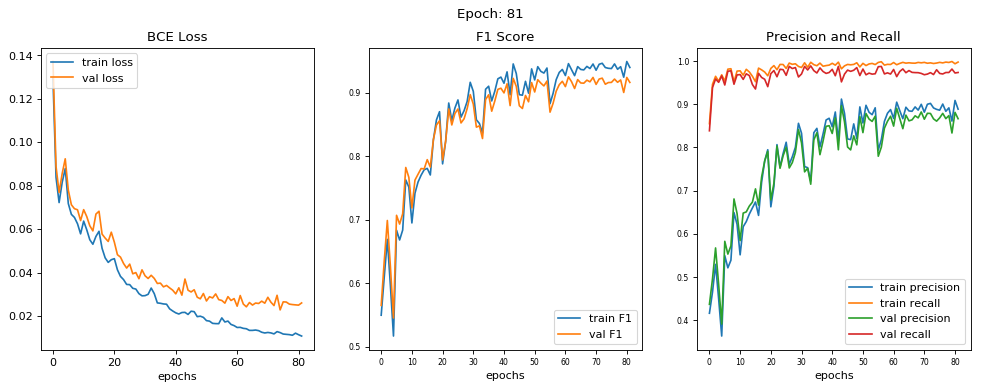

epoch [81/200] 
train loss = 0.0108, train f1 score = 0.9394 
train precision = 0.8882, train recall = 0.9972 

val loss = 0.0261, val f1 score = 0.9159 
val precision = 0.8661, val recall = 0.9731 




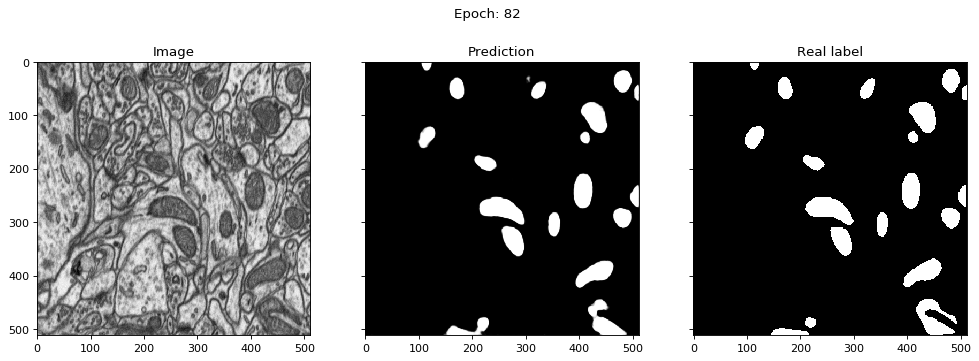

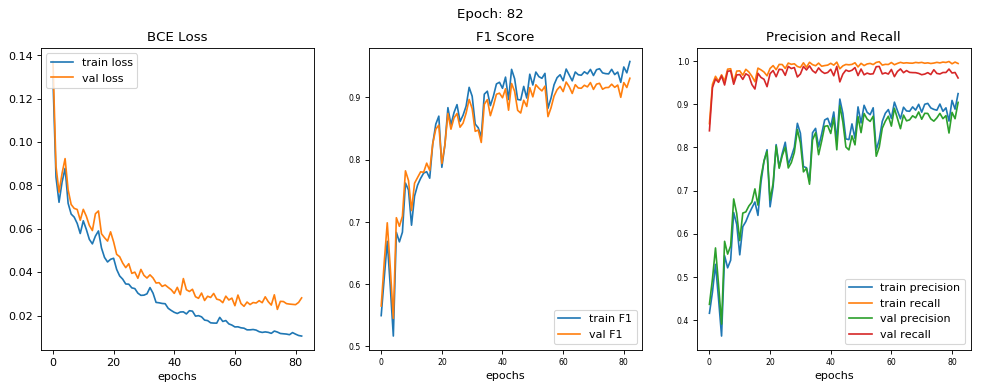

epoch [82/200] 
train loss = 0.0105, train f1 score = 0.9576 
train precision = 0.9242, train recall = 0.9939 

val loss = 0.0282, val f1 score = 0.9307 
val precision = 0.9039, val recall = 0.9604 




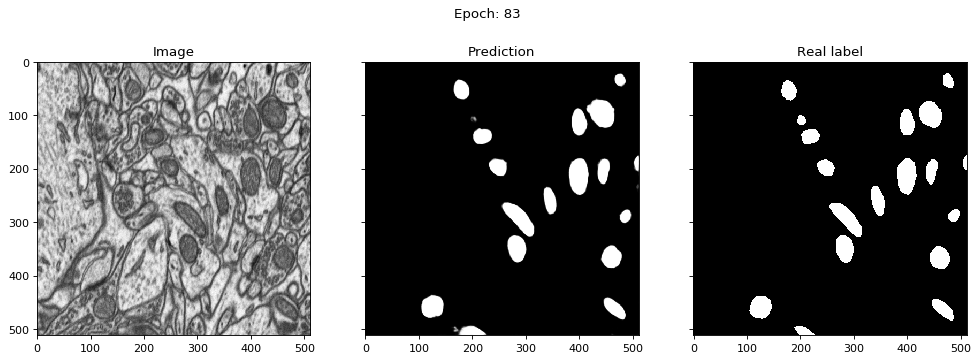

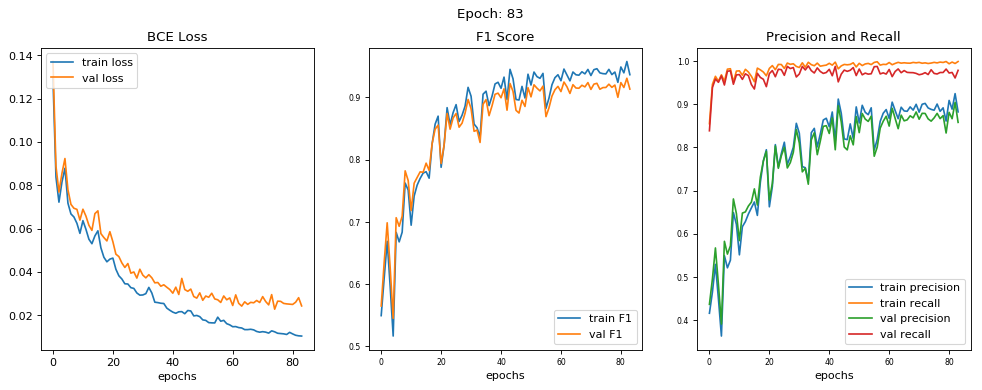

epoch [83/200] 
train loss = 0.0104, train f1 score = 0.9365 
train precision = 0.8819, train recall = 0.9985 

val loss = 0.0244, val f1 score = 0.9133 
val precision = 0.8577, val recall = 0.9781 




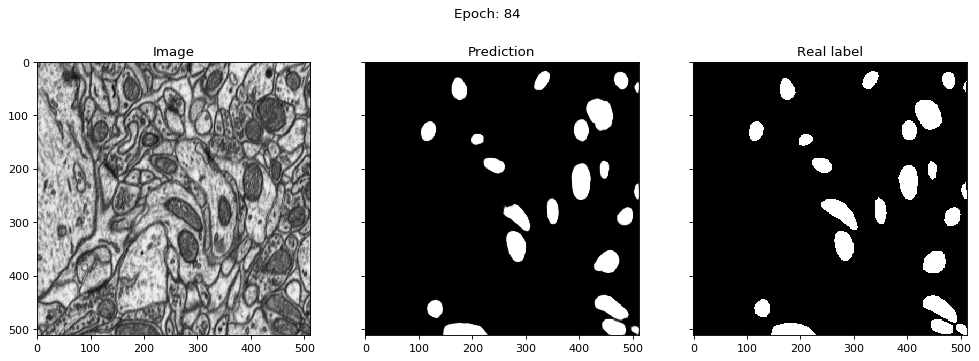

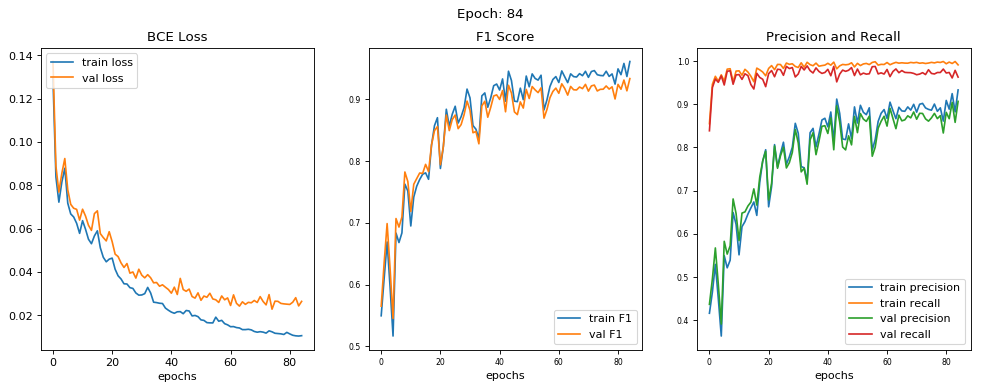

epoch [84/200] 
train loss = 0.0106, train f1 score = 0.9607 
train precision = 0.9327, train recall = 0.9907 

val loss = 0.0264, val f1 score = 0.9331 
val precision = 0.9062, val recall = 0.9624 




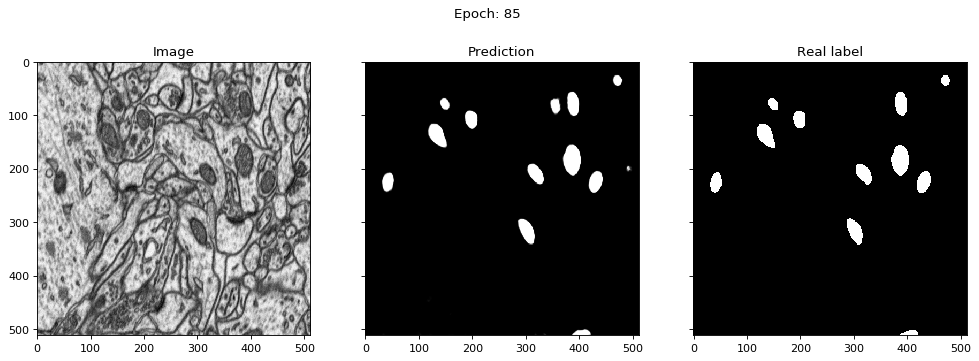

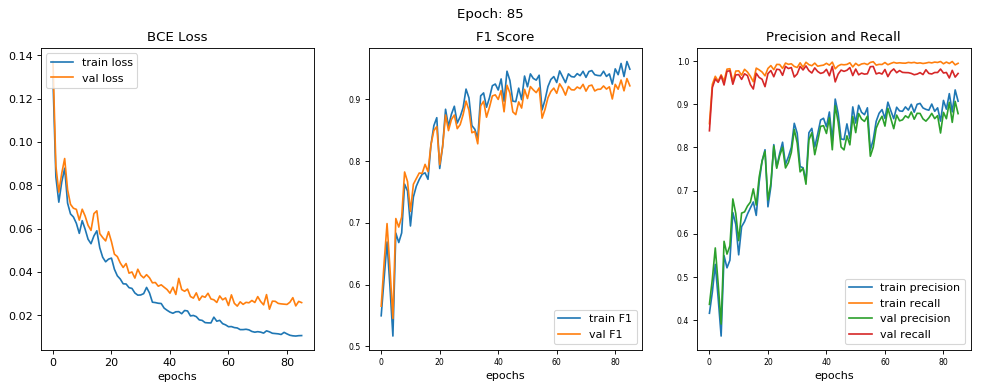

epoch [85/200] 
train loss = 0.0107, train f1 score = 0.9484 
train precision = 0.9067, train recall = 0.9943 

val loss = 0.0259, val f1 score = 0.9214 
val precision = 0.8779, val recall = 0.9708 




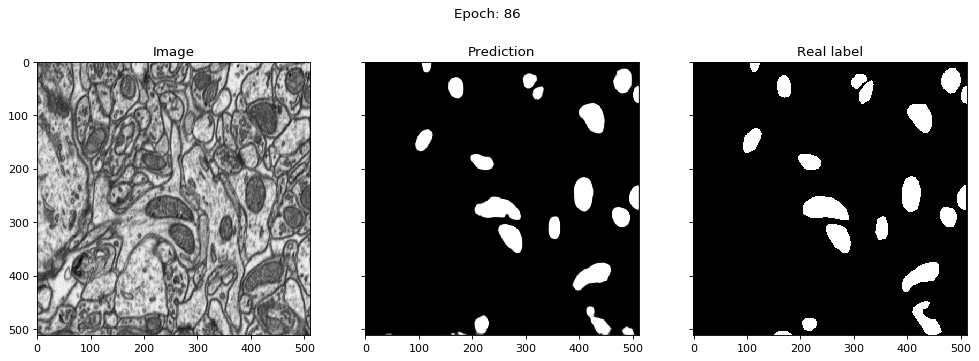

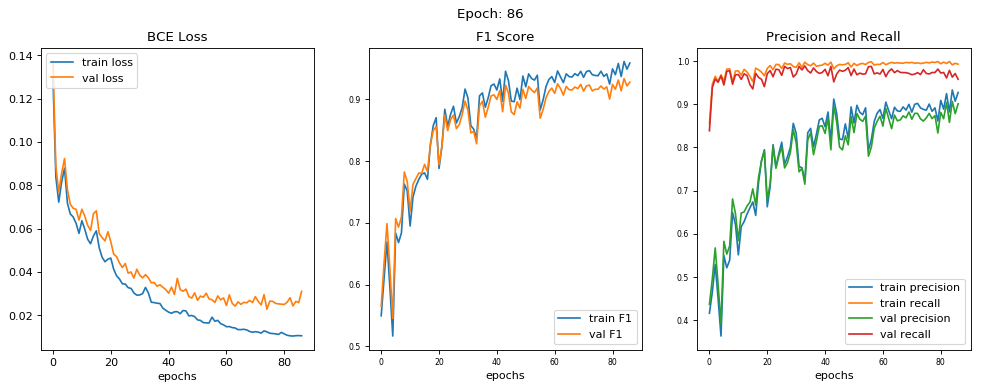

epoch [86/200] 
train loss = 0.0106, train f1 score = 0.9583 
train precision = 0.9268, train recall = 0.9923 

val loss = 0.0311, val f1 score = 0.9274 
val precision = 0.9006, val recall = 0.9574 




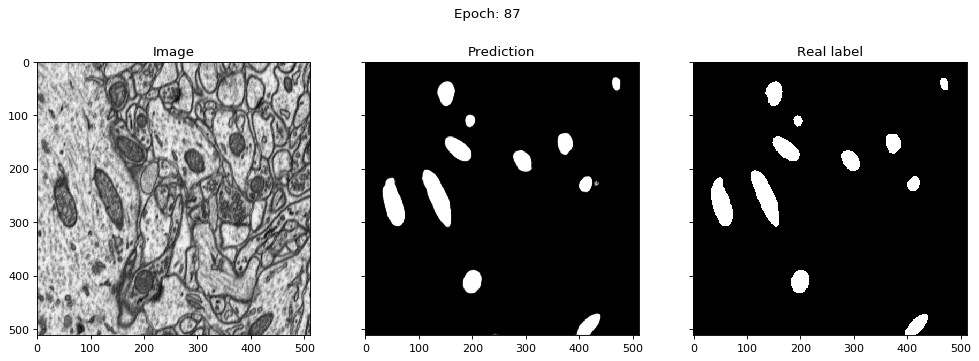

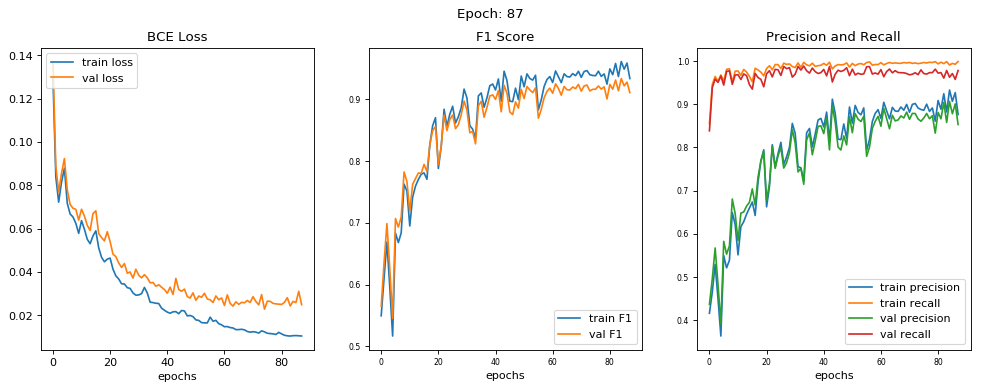

epoch [87/200] 
train loss = 0.0105, train f1 score = 0.9332 
train precision = 0.8760, train recall = 0.9988 

val loss = 0.0249, val f1 score = 0.9104 
val precision = 0.8529, val recall = 0.9779 




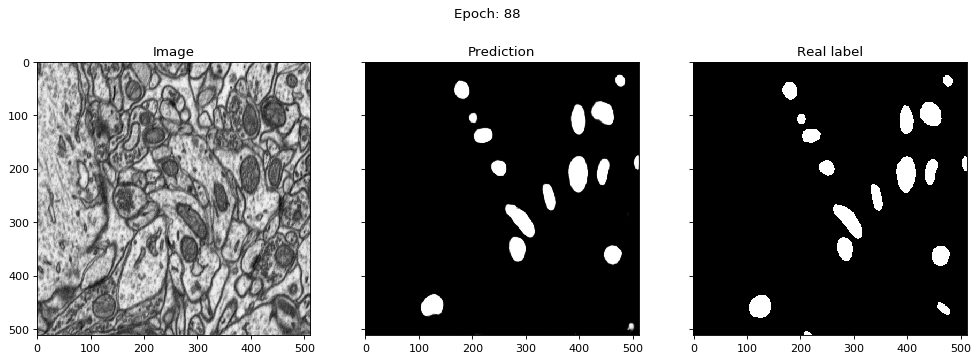

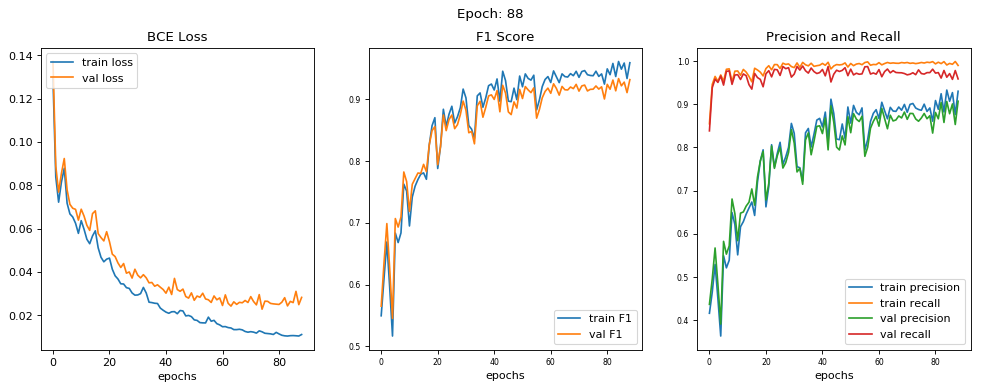

epoch [88/200] 
train loss = 0.0111, train f1 score = 0.9588 
train precision = 0.9300, train recall = 0.9897 

val loss = 0.0283, val f1 score = 0.9314 
val precision = 0.9068, val recall = 0.9584 




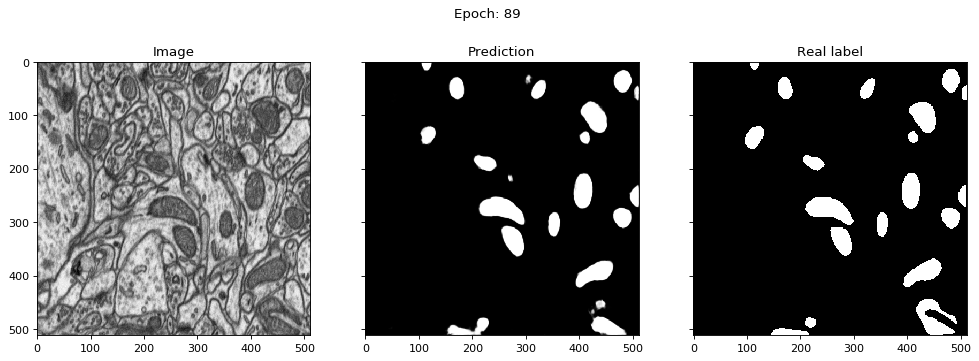

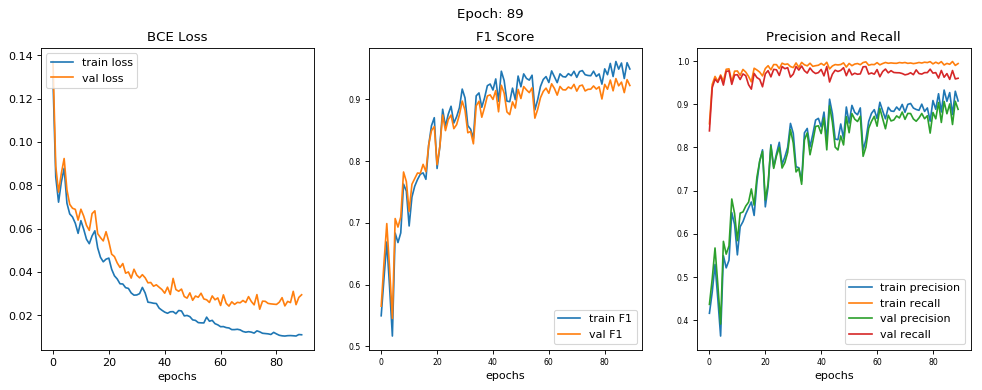

epoch [89/200] 
train loss = 0.0110, train f1 score = 0.9486 
train precision = 0.9075, train recall = 0.9940 

val loss = 0.0295, val f1 score = 0.9219 
val precision = 0.8881, val recall = 0.9600 




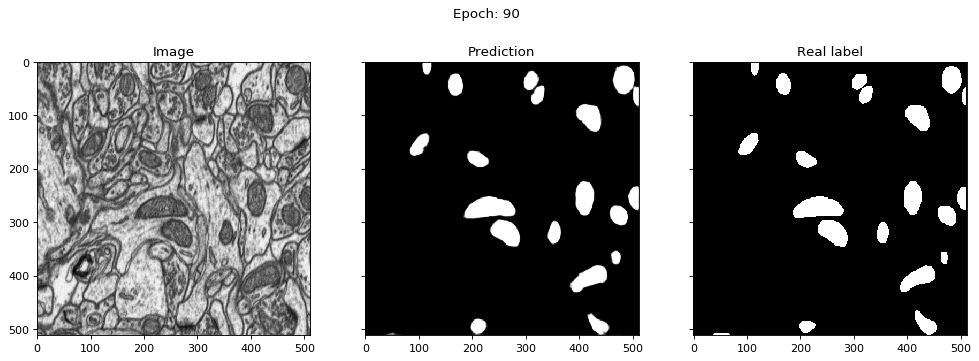

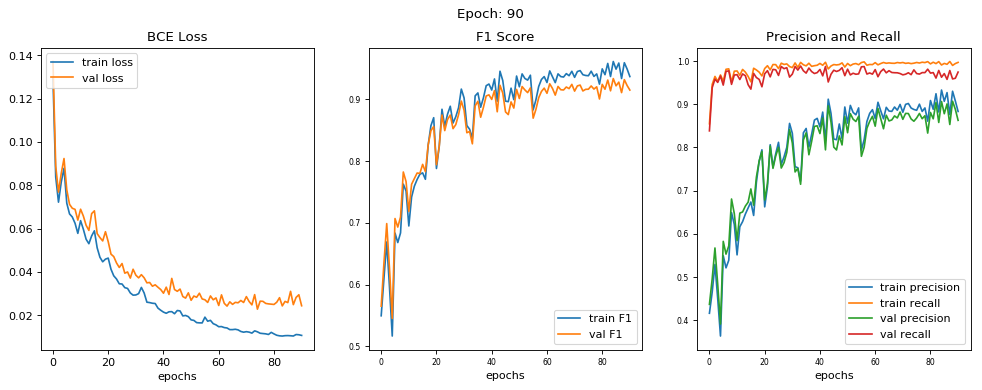

epoch [90/200] 
train loss = 0.0107, train f1 score = 0.9364 
train precision = 0.8831, train recall = 0.9967 

val loss = 0.0244, val f1 score = 0.9145 
val precision = 0.8626, val recall = 0.9743 




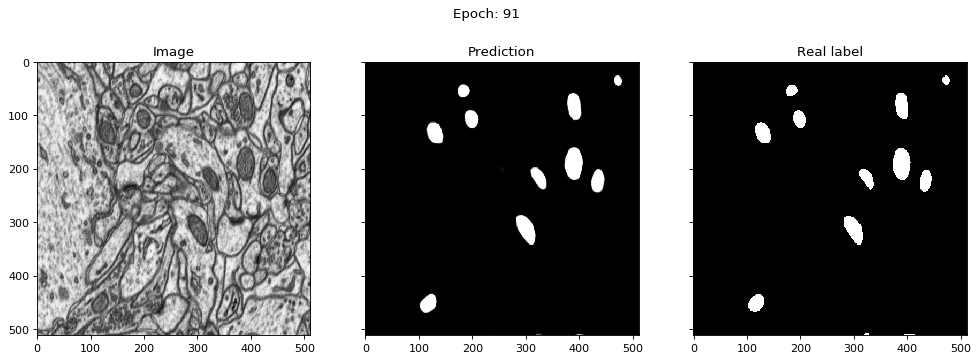

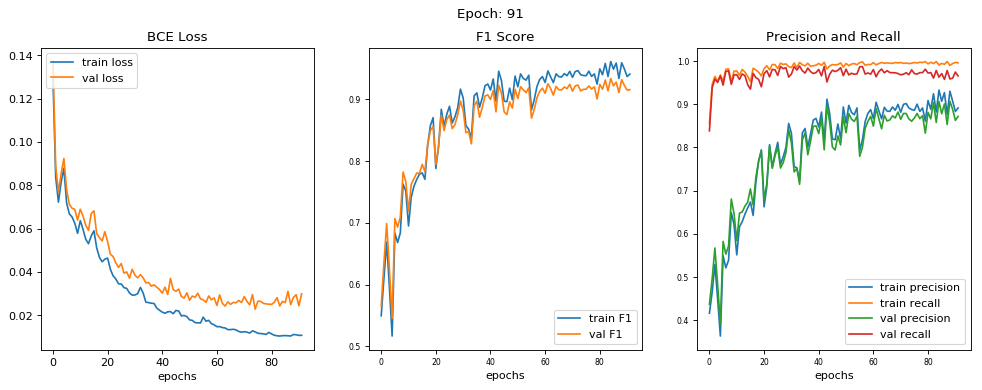

epoch [91/200] 
train loss = 0.0108, train f1 score = 0.9403 
train precision = 0.8913, train recall = 0.9956 

val loss = 0.0299, val f1 score = 0.9151 
val precision = 0.8717, val recall = 0.9655 




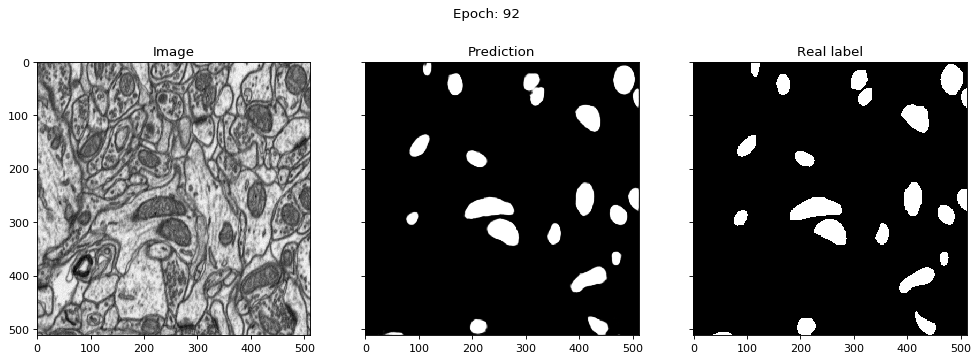

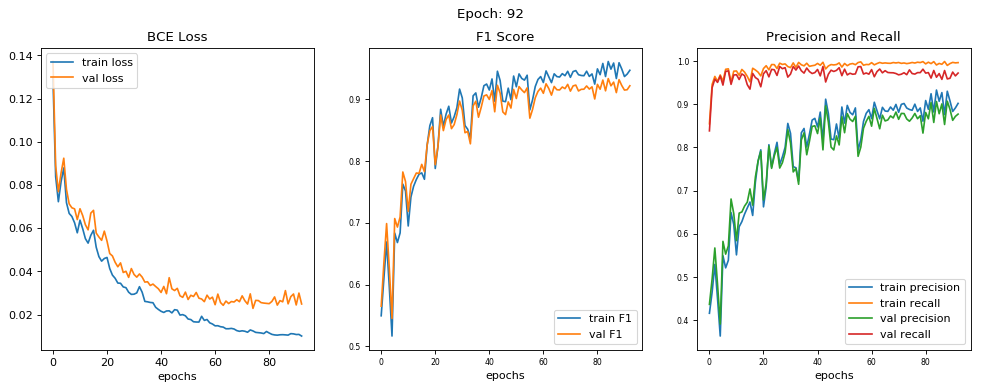

epoch [92/200] 
train loss = 0.0100, train f1 score = 0.9465 
train precision = 0.9018, train recall = 0.9962 

val loss = 0.0249, val f1 score = 0.9215 
val precision = 0.8770, val recall = 0.9720 




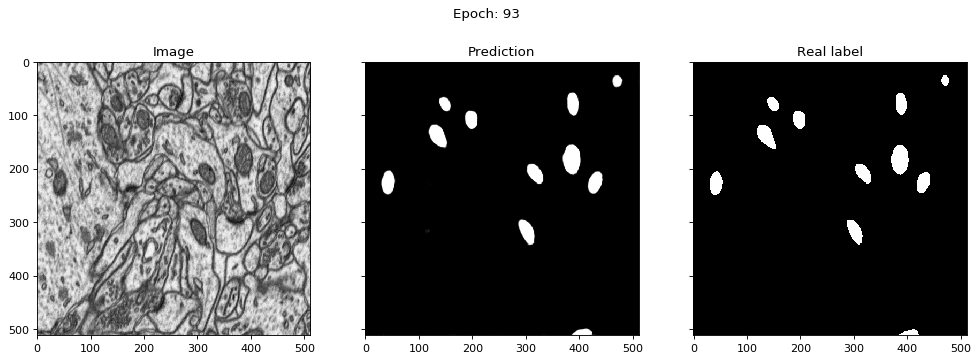

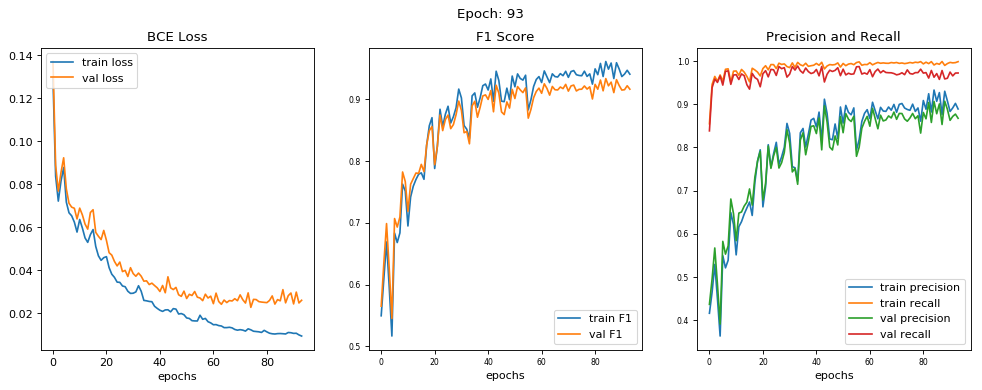

epoch [93/200] 
train loss = 0.0095, train f1 score = 0.9402 
train precision = 0.8888, train recall = 0.9984 

val loss = 0.0261, val f1 score = 0.9160 
val precision = 0.8674, val recall = 0.9722 




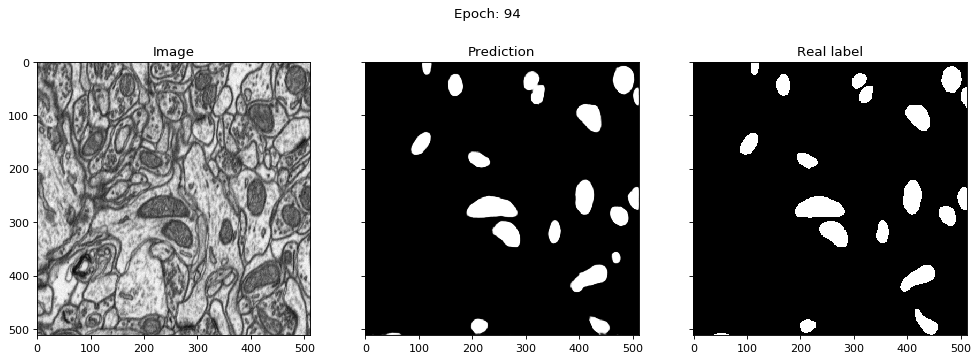

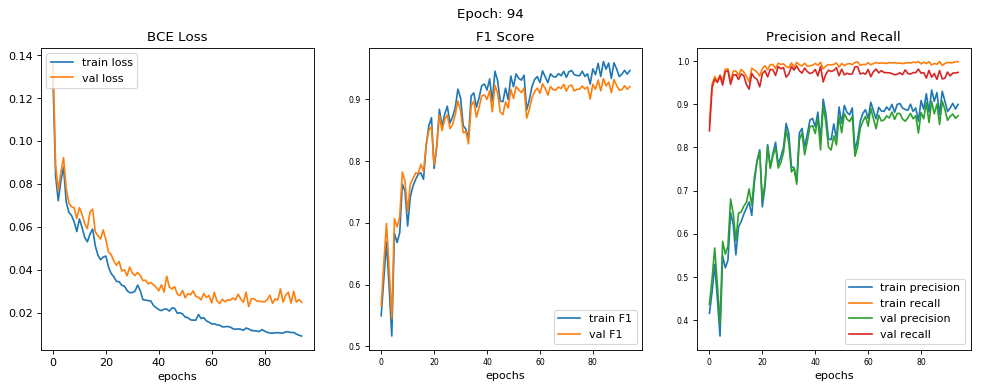

epoch [94/200] 
train loss = 0.0091, train f1 score = 0.9461 
train precision = 0.8995, train recall = 0.9981 

val loss = 0.0248, val f1 score = 0.9200 
val precision = 0.8732, val recall = 0.9736 




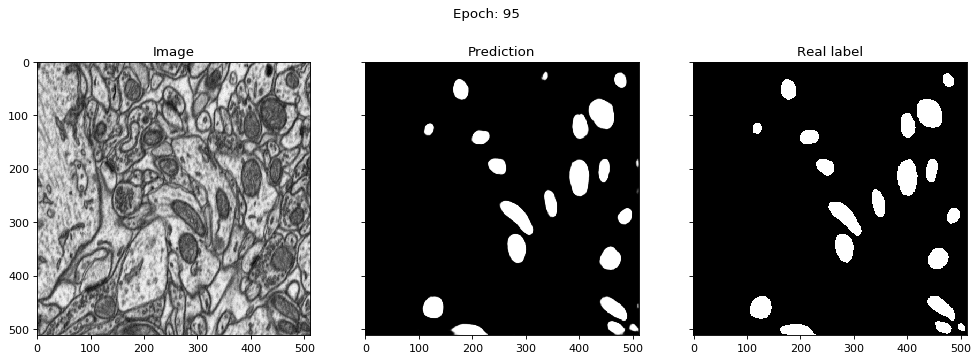

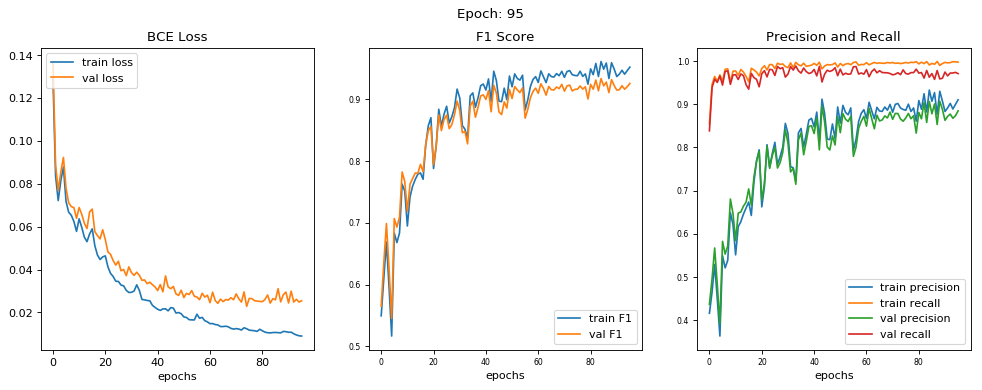

epoch [95/200] 
train loss = 0.0090, train f1 score = 0.9517 
train precision = 0.9102, train recall = 0.9973 

val loss = 0.0254, val f1 score = 0.9253 
val precision = 0.8845, val recall = 0.9708 




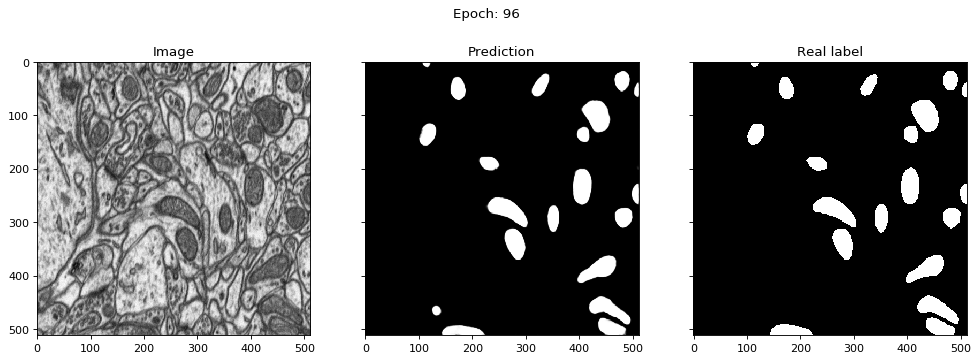

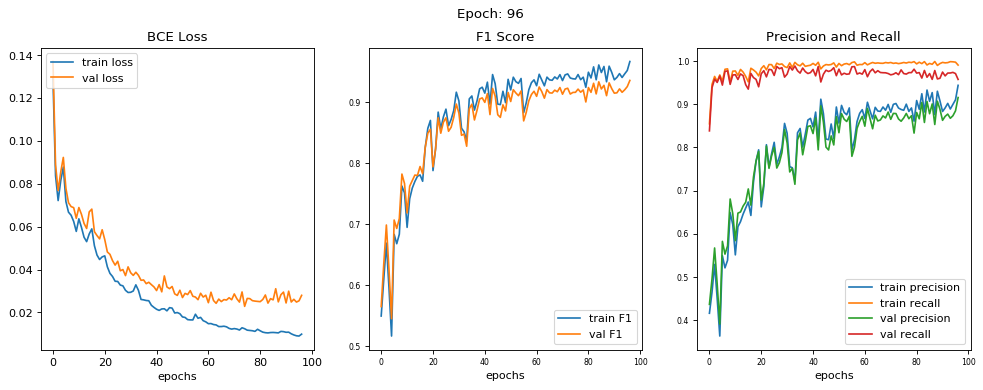

epoch [96/200] 
train loss = 0.0099, train f1 score = 0.9664 
train precision = 0.9436, train recall = 0.9905 

val loss = 0.0280, val f1 score = 0.9354 
val precision = 0.9154, val recall = 0.9573 




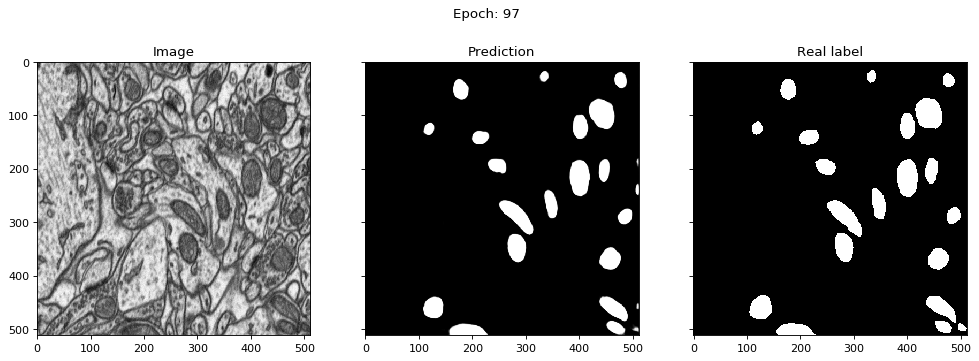

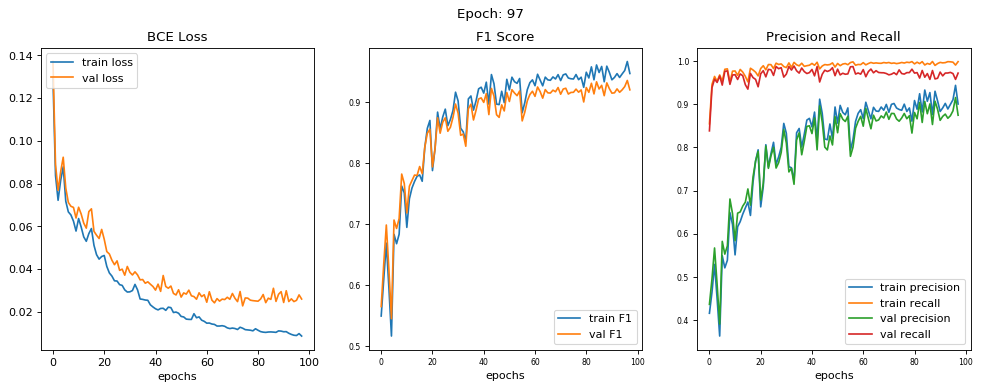

epoch [97/200] 
train loss = 0.0087, train f1 score = 0.9467 
train precision = 0.9004, train recall = 0.9984 

val loss = 0.0260, val f1 score = 0.9200 
val precision = 0.8744, val recall = 0.9719 




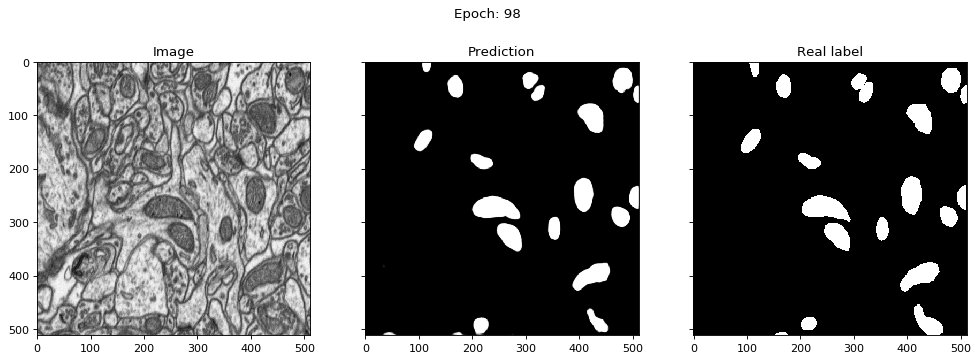

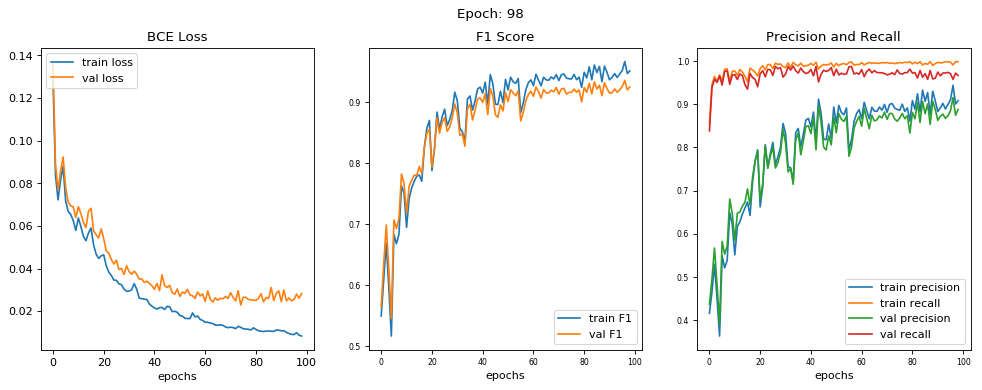

epoch [98/200] 
train loss = 0.0083, train f1 score = 0.9509 
train precision = 0.9082, train recall = 0.9983 

val loss = 0.0282, val f1 score = 0.9247 
val precision = 0.8876, val recall = 0.9665 




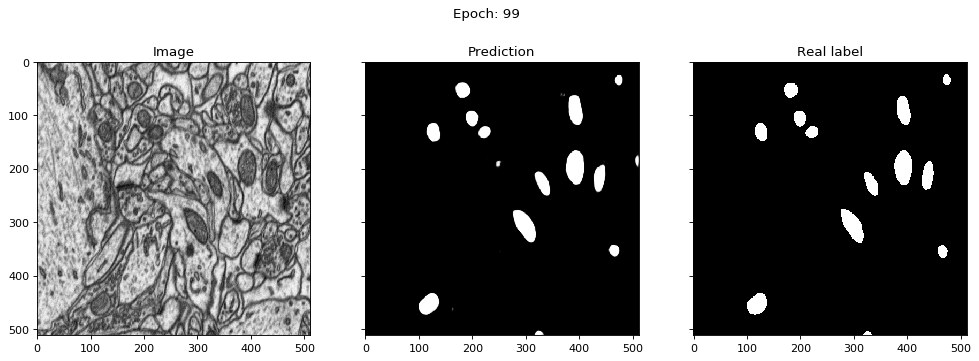

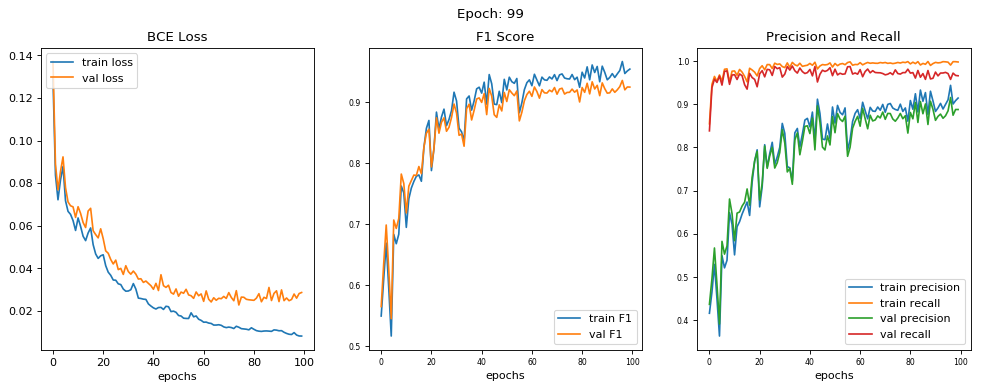

epoch [99/200] 
train loss = 0.0083, train f1 score = 0.9540 
train precision = 0.9142, train recall = 0.9976 

val loss = 0.0287, val f1 score = 0.9245 
val precision = 0.8876, val recall = 0.9658 




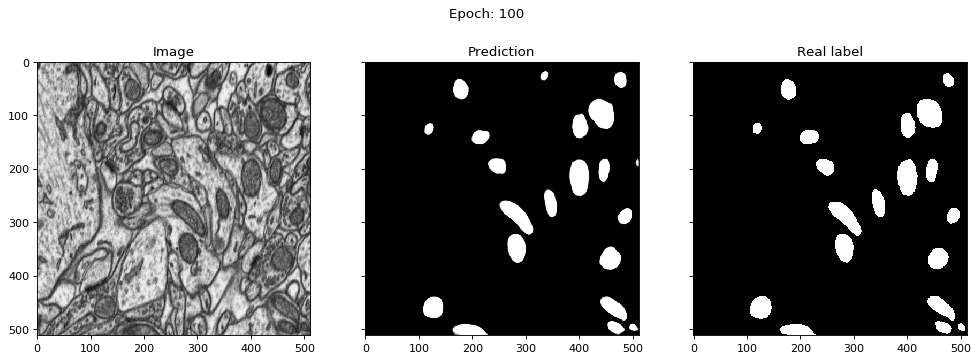

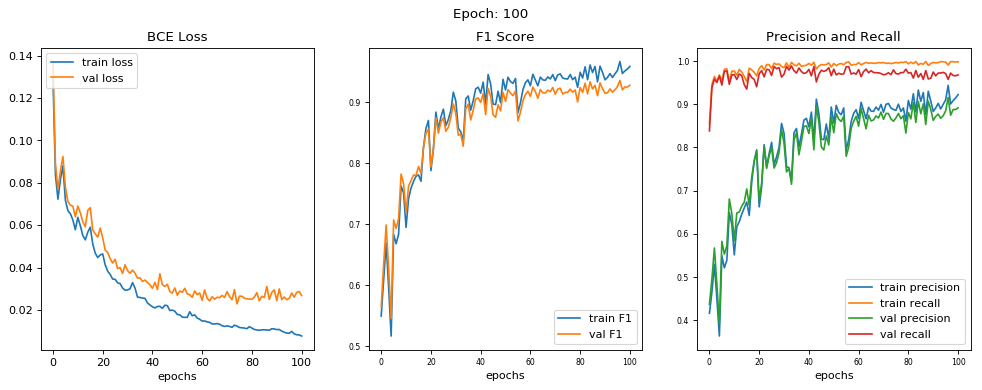

epoch [100/200] 
train loss = 0.0077, train f1 score = 0.9585 
train precision = 0.9221, train recall = 0.9979 

val loss = 0.0268, val f1 score = 0.9275 
val precision = 0.8915, val recall = 0.9677 




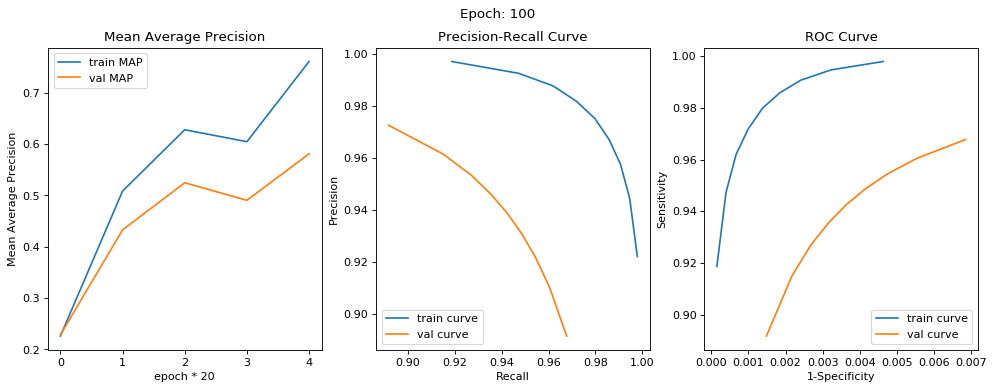

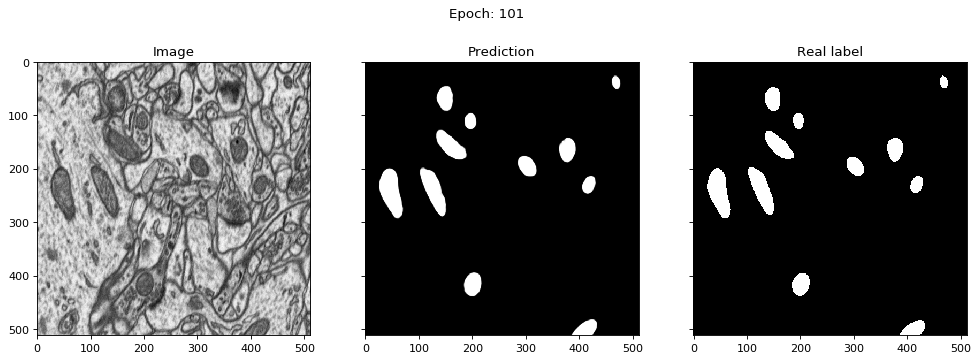

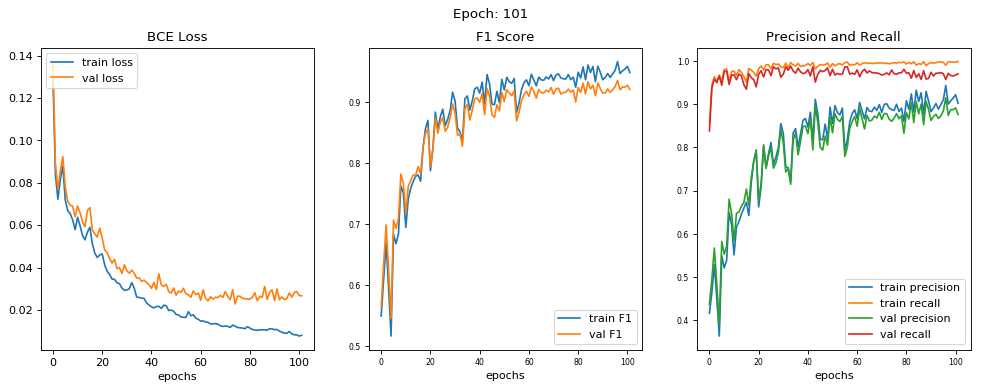

epoch [101/200] 
train loss = 0.0080, train f1 score = 0.9483 
train precision = 0.9026, train recall = 0.9992 

val loss = 0.0267, val f1 score = 0.9205 
val precision = 0.8764, val recall = 0.9707 




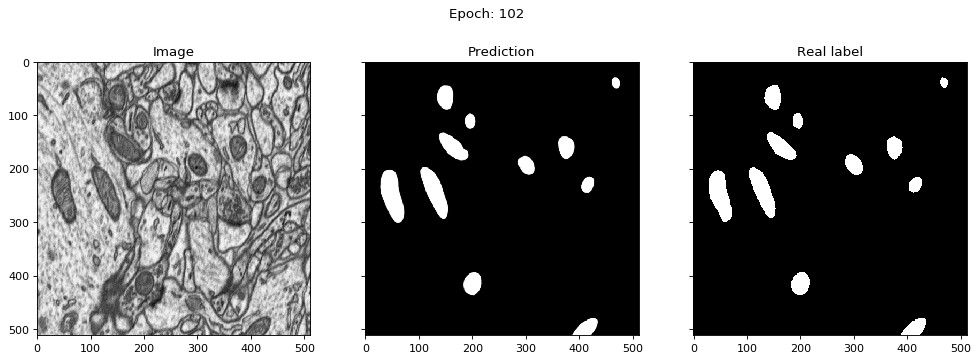

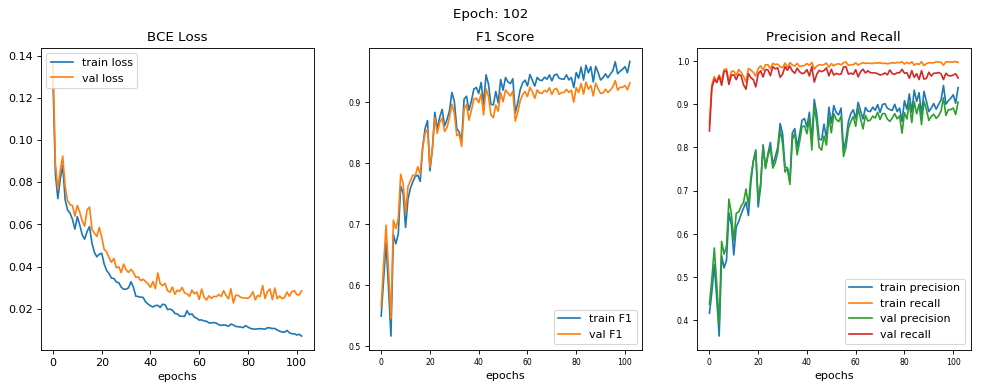

epoch [102/200] 
train loss = 0.0072, train f1 score = 0.9668 
train precision = 0.9384, train recall = 0.9972 

val loss = 0.0286, val f1 score = 0.9318 
val precision = 0.9052, val recall = 0.9612 




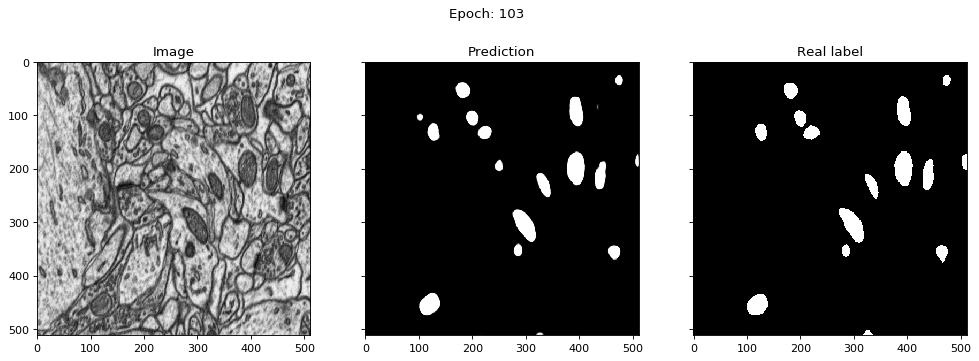

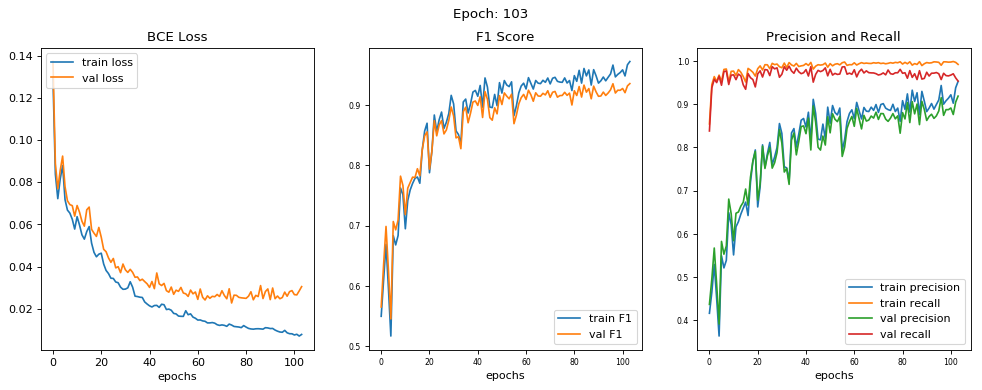

epoch [103/200] 
train loss = 0.0079, train f1 score = 0.9723 
train precision = 0.9530, train recall = 0.9925 

val loss = 0.0306, val f1 score = 0.9356 
val precision = 0.9190, val recall = 0.9538 




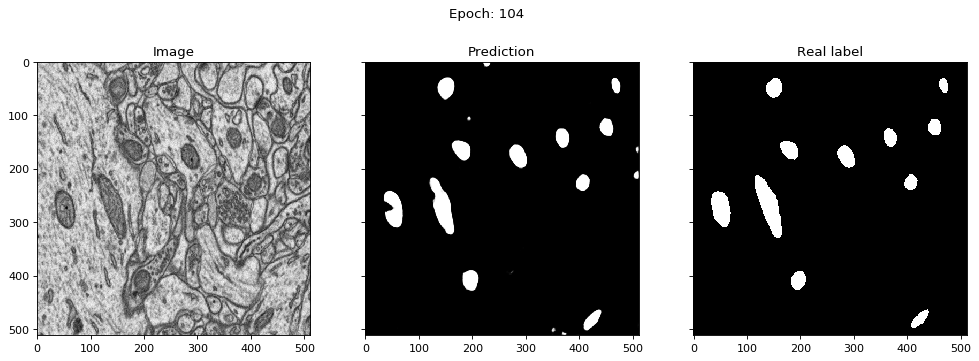

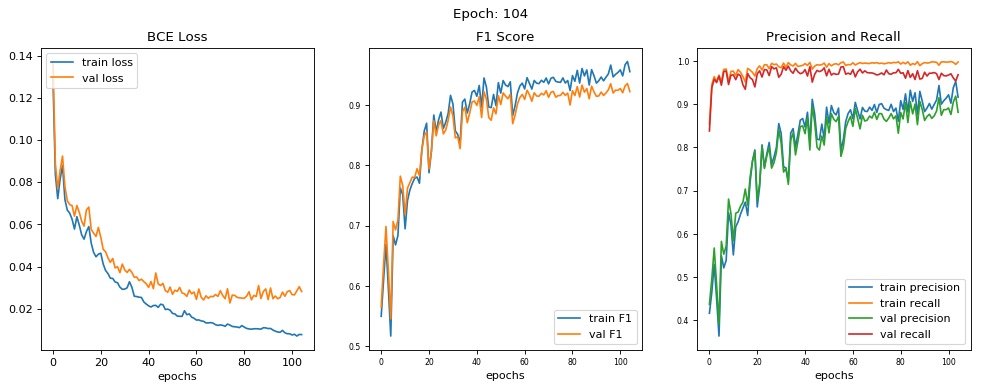

epoch [104/200] 
train loss = 0.0079, train f1 score = 0.9554 
train precision = 0.9164, train recall = 0.9981 

val loss = 0.0283, val f1 score = 0.9223 
val precision = 0.8815, val recall = 0.9685 




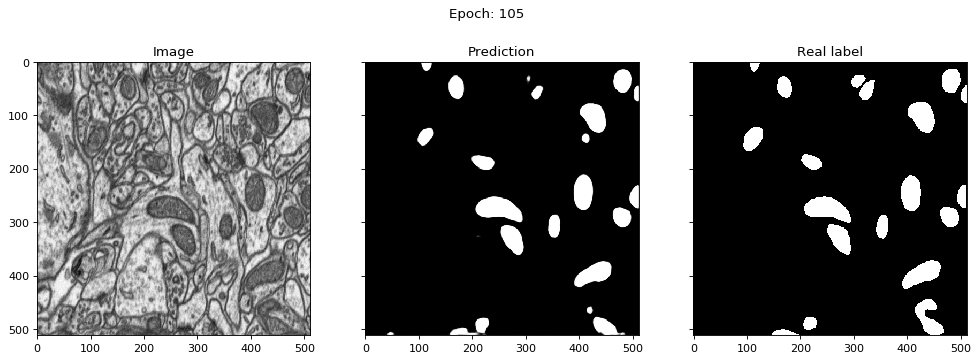

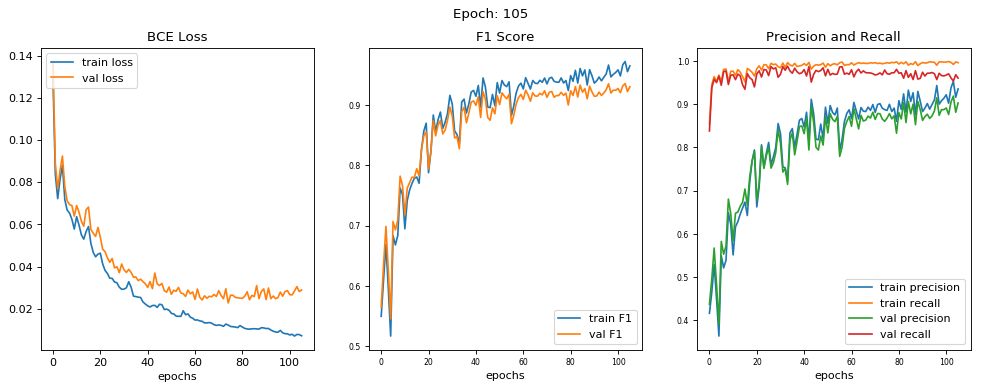

epoch [105/200] 
train loss = 0.0073, train f1 score = 0.9650 
train precision = 0.9356, train recall = 0.9963 

val loss = 0.0290, val f1 score = 0.9305 
val precision = 0.9030, val recall = 0.9607 




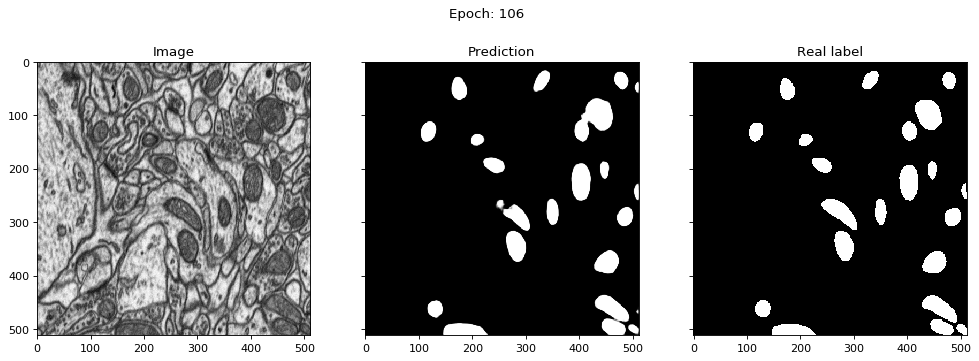

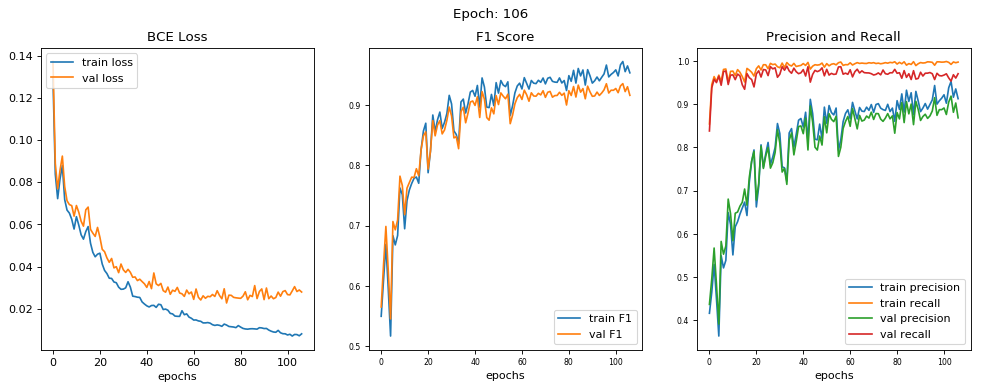

epoch [106/200] 
train loss = 0.0082, train f1 score = 0.9535 
train precision = 0.9130, train recall = 0.9978 

val loss = 0.0280, val f1 score = 0.9161 
val precision = 0.8687, val recall = 0.9708 




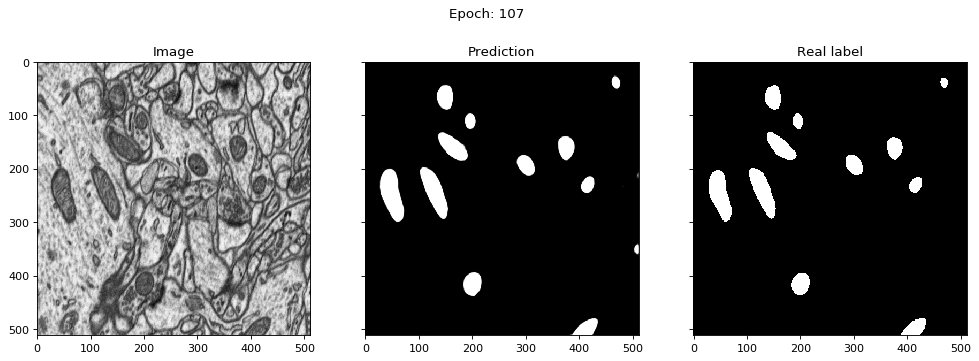

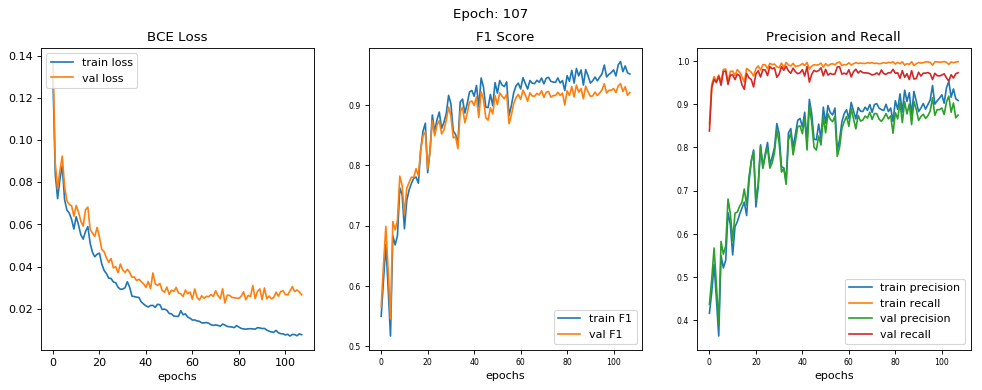

epoch [107/200] 
train loss = 0.0078, train f1 score = 0.9515 
train precision = 0.9087, train recall = 0.9989 

val loss = 0.0268, val f1 score = 0.9207 
val precision = 0.8751, val recall = 0.9732 




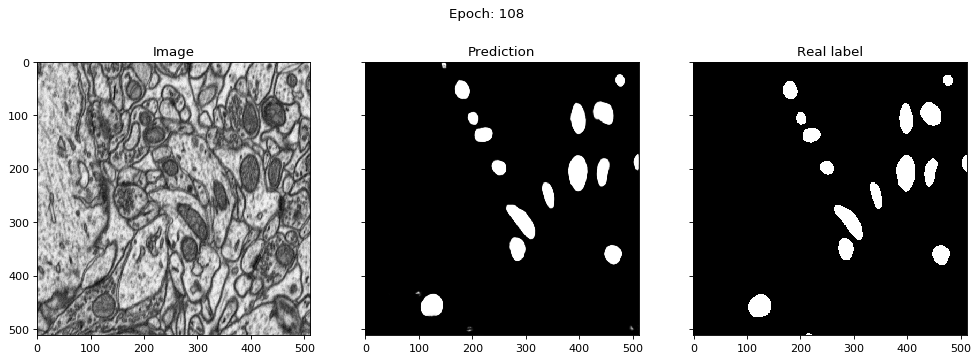

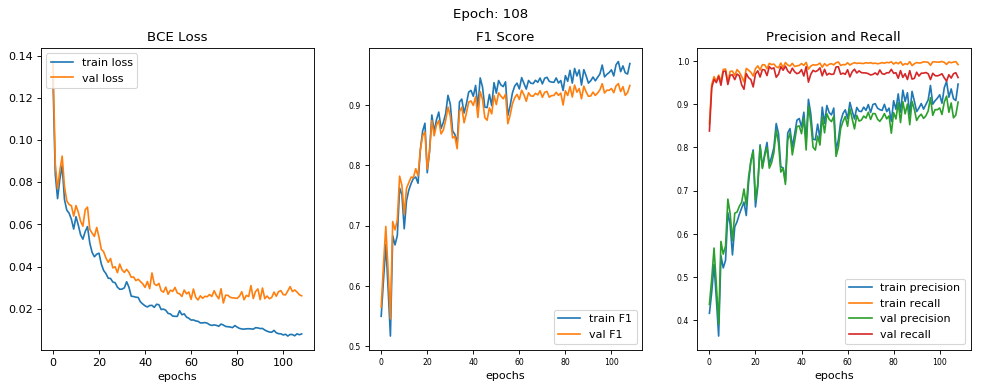

epoch [108/200] 
train loss = 0.0082, train f1 score = 0.9689 
train precision = 0.9469, train recall = 0.9921 

val loss = 0.0262, val f1 score = 0.9324 
val precision = 0.9052, val recall = 0.9621 




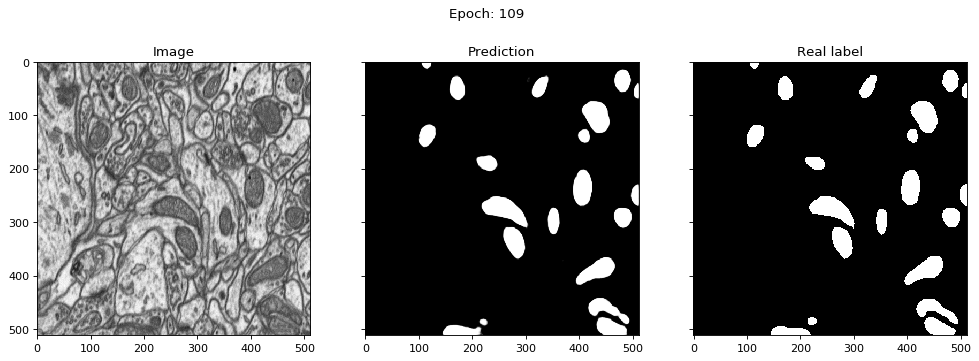

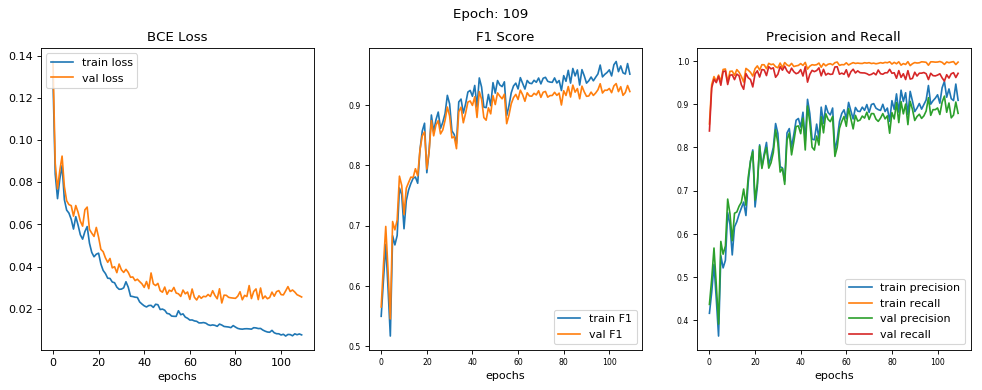

epoch [109/200] 
train loss = 0.0077, train f1 score = 0.9513 
train precision = 0.9093, train recall = 0.9977 

val loss = 0.0257, val f1 score = 0.9224 
val precision = 0.8791, val recall = 0.9717 




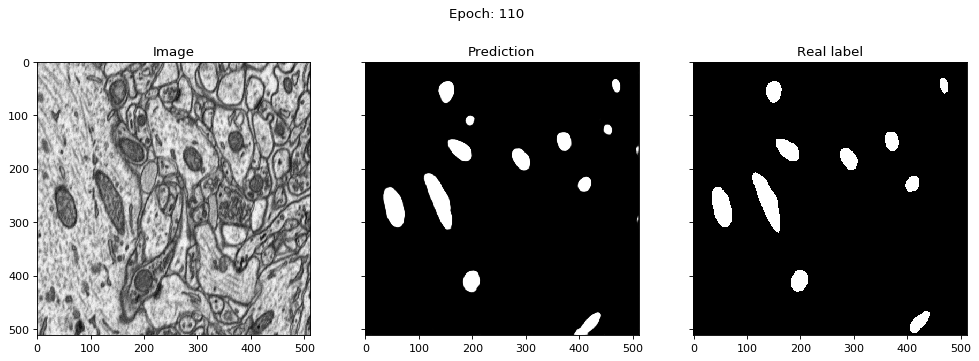

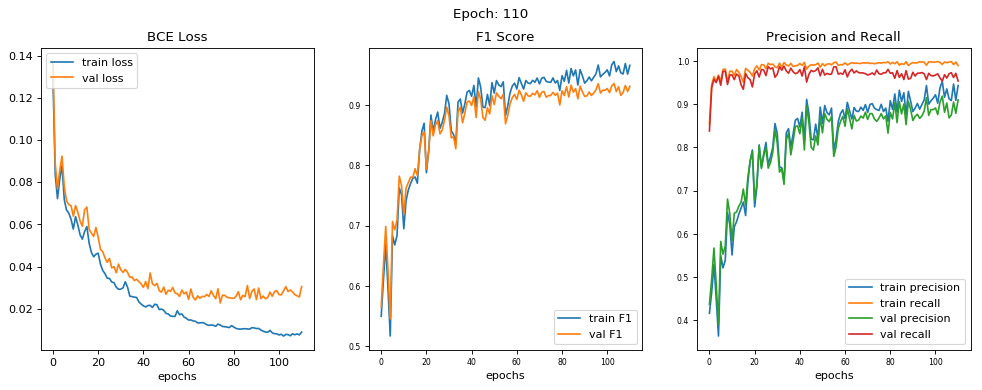

epoch [110/200] 
train loss = 0.0091, train f1 score = 0.9659 
train precision = 0.9434, train recall = 0.9897 

val loss = 0.0306, val f1 score = 0.9311 
val precision = 0.9103, val recall = 0.9540 




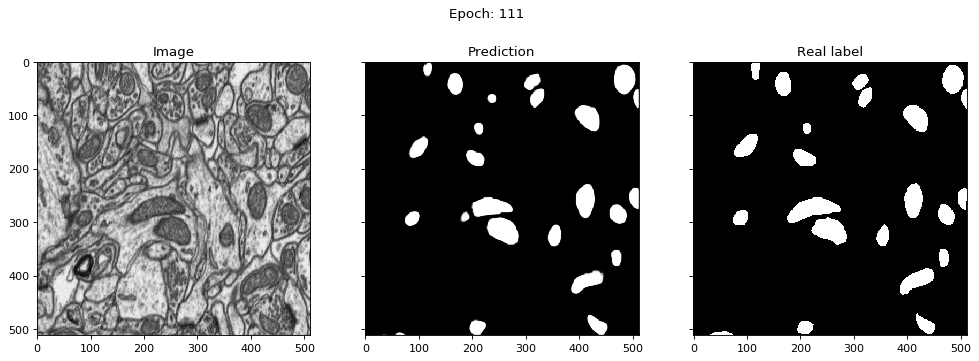

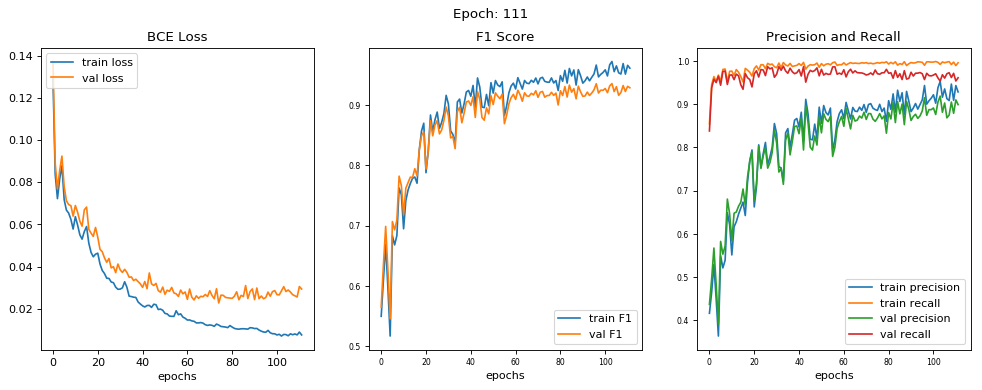

epoch [111/200] 
train loss = 0.0077, train f1 score = 0.9612 
train precision = 0.9287, train recall = 0.9962 

val loss = 0.0294, val f1 score = 0.9287 
val precision = 0.8993, val recall = 0.9615 




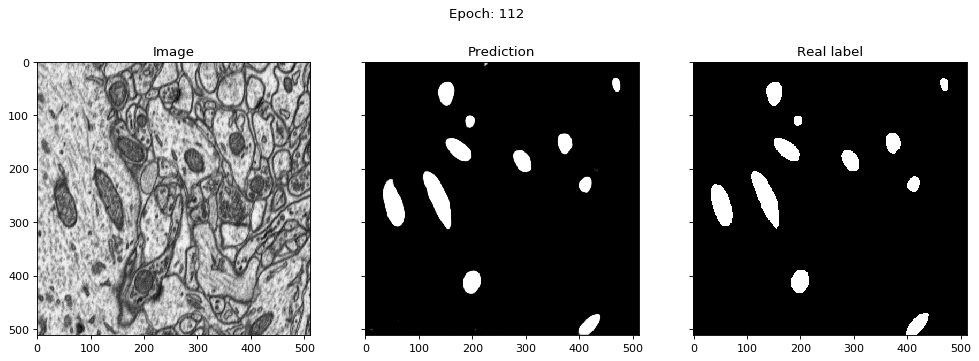

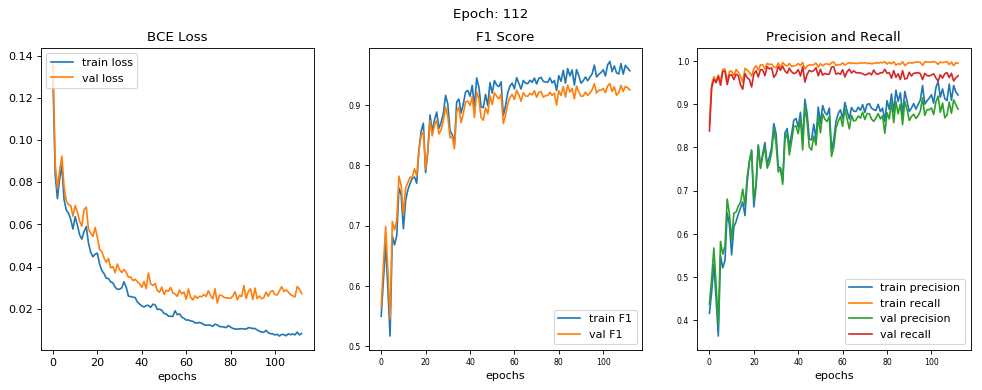

epoch [112/200] 
train loss = 0.0084, train f1 score = 0.9569 
train precision = 0.9217, train recall = 0.9951 

val loss = 0.0273, val f1 score = 0.9252 
val precision = 0.8890, val recall = 0.9661 




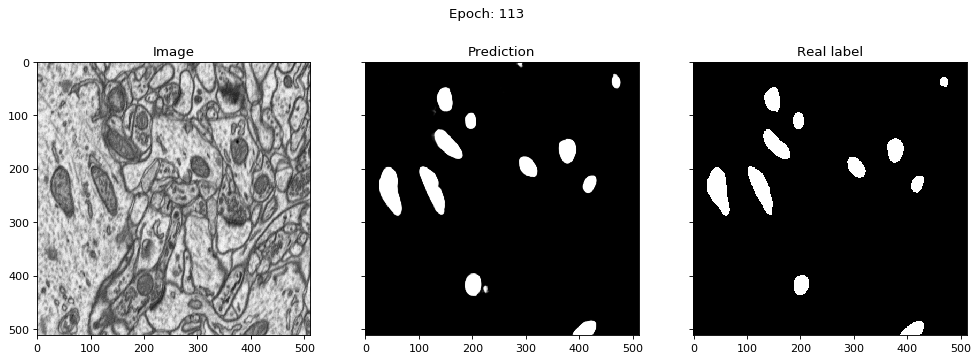

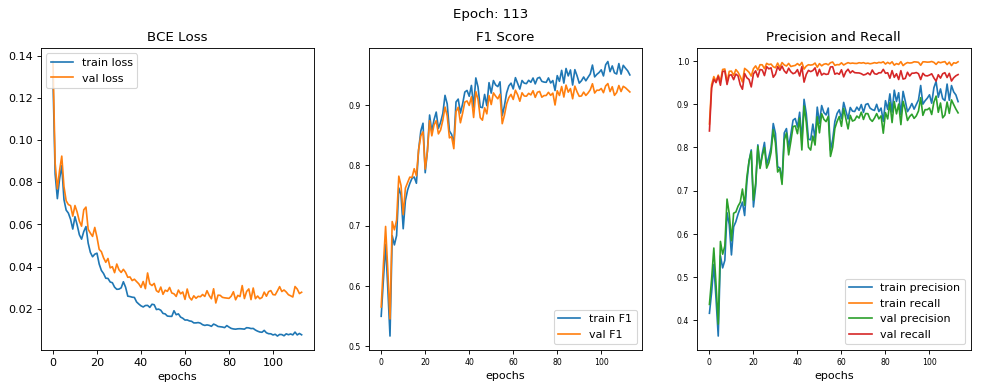

epoch [113/200] 
train loss = 0.0078, train f1 score = 0.9500 
train precision = 0.9062, train recall = 0.9985 

val loss = 0.0279, val f1 score = 0.9218 
val precision = 0.8802, val recall = 0.9689 




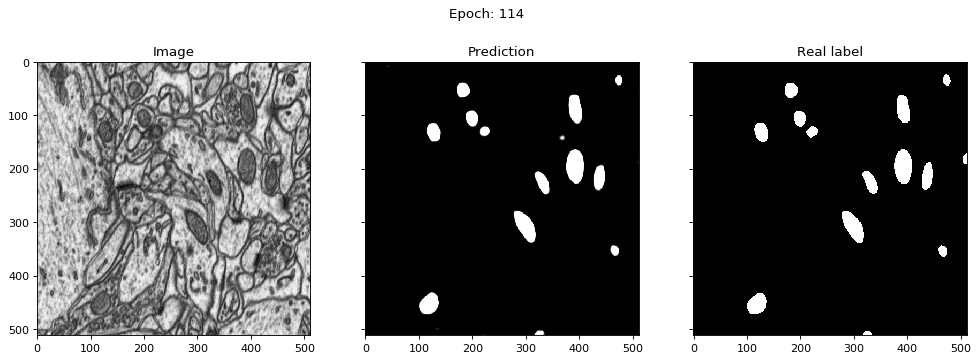

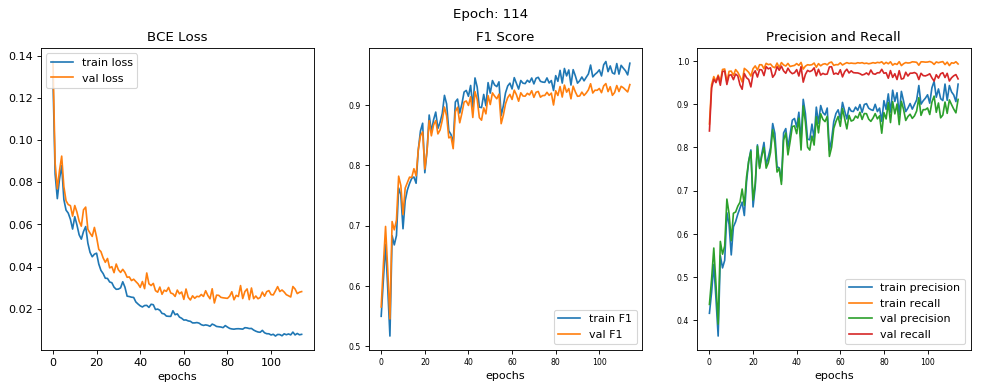

epoch [114/200] 
train loss = 0.0080, train f1 score = 0.9694 
train precision = 0.9467, train recall = 0.9934 

val loss = 0.0282, val f1 score = 0.9340 
val precision = 0.9114, val recall = 0.9589 




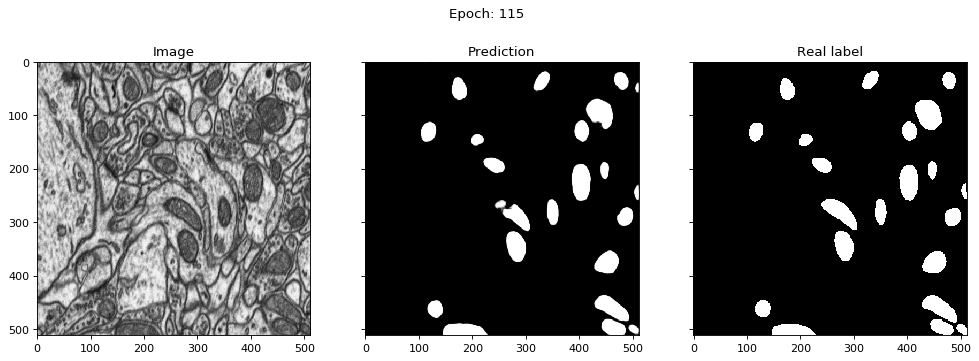

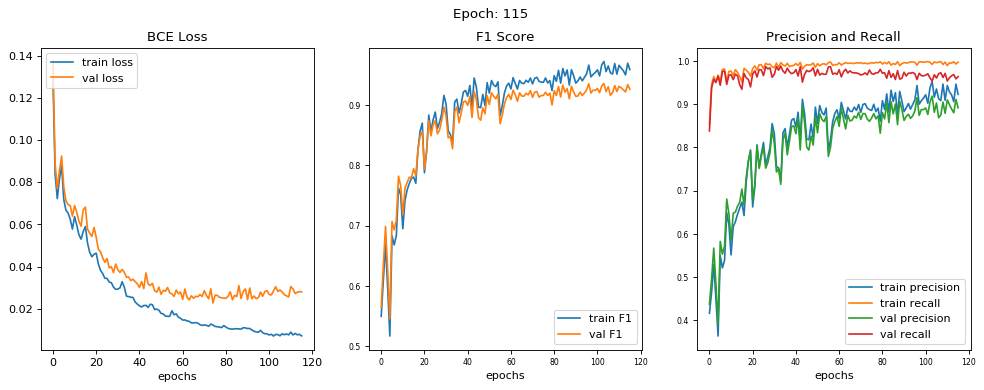

epoch [115/200] 
train loss = 0.0073, train f1 score = 0.9589 
train precision = 0.9232, train recall = 0.9977 

val loss = 0.0281, val f1 score = 0.9262 
val precision = 0.8919, val recall = 0.9642 




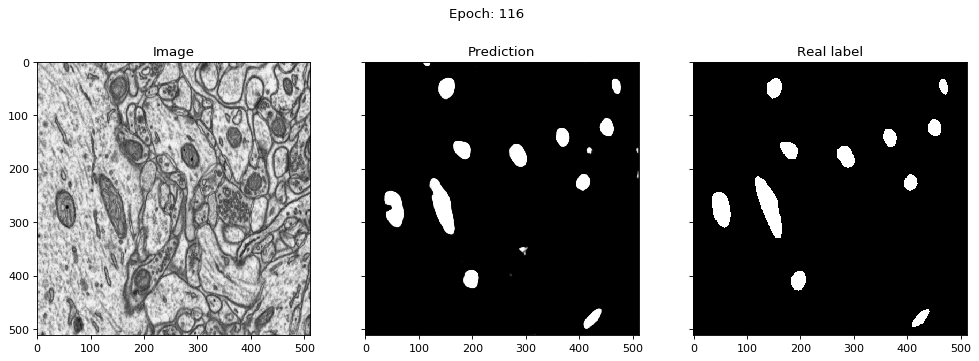

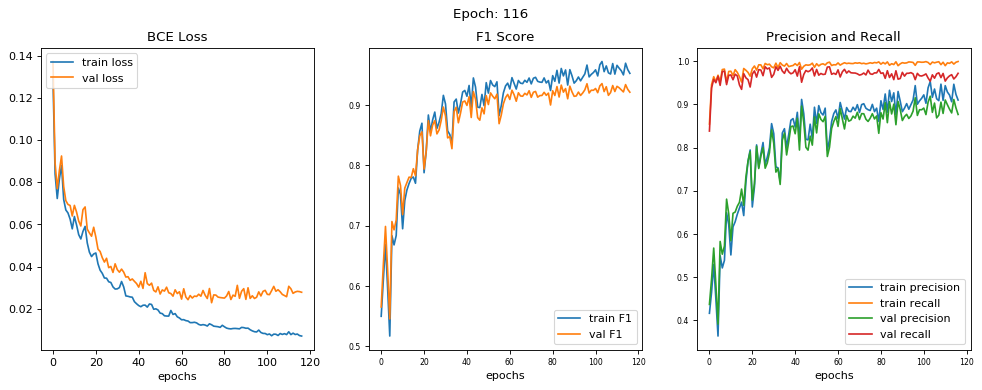

epoch [116/200] 
train loss = 0.0070, train f1 score = 0.9526 
train precision = 0.9101, train recall = 0.9994 

val loss = 0.0278, val f1 score = 0.9214 
val precision = 0.8767, val recall = 0.9720 




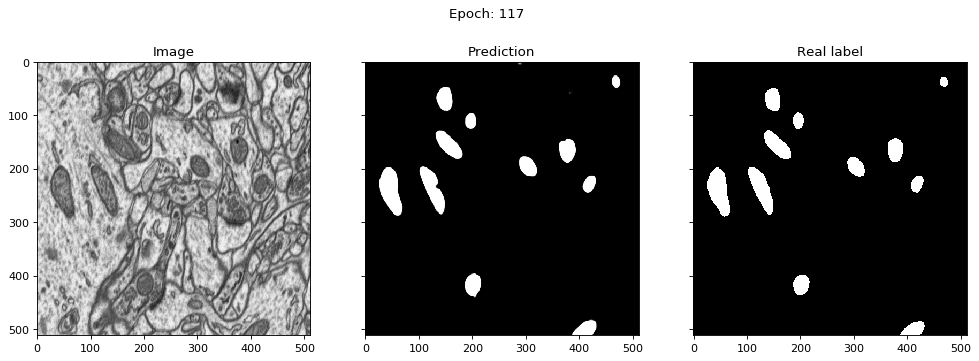

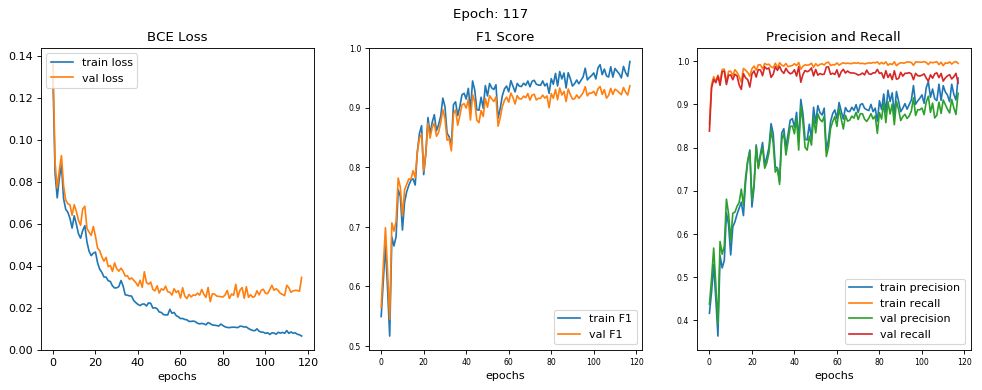

epoch [117/200] 
train loss = 0.0064, train f1 score = 0.9776 
train precision = 0.9608, train recall = 0.9951 

val loss = 0.0344, val f1 score = 0.9368 
val precision = 0.9258, val recall = 0.9494 




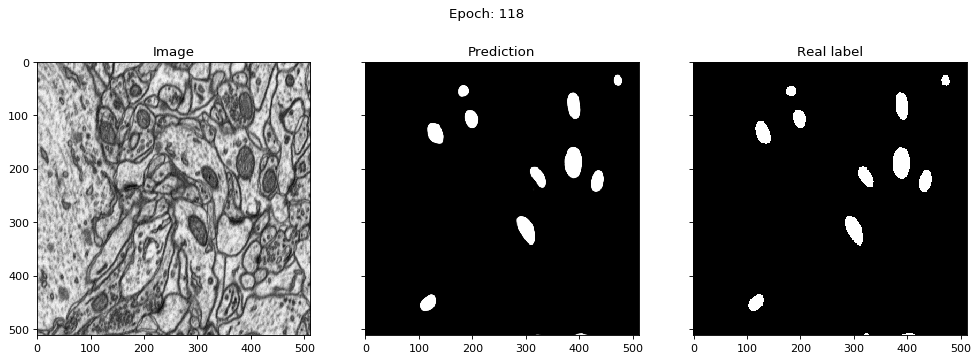

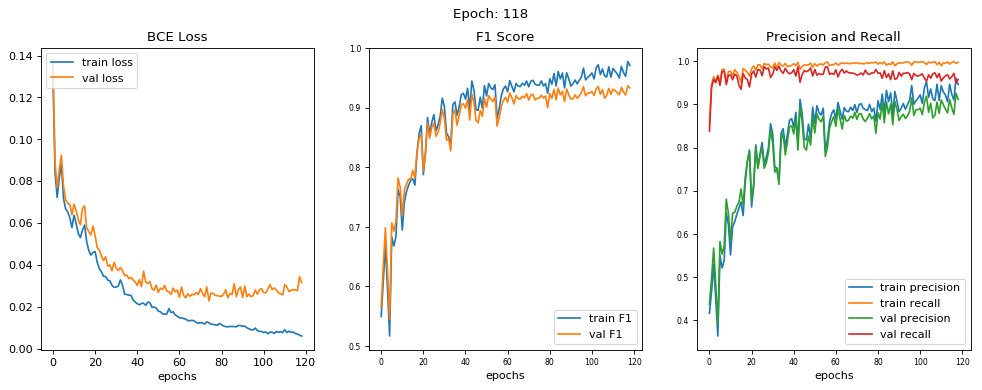

epoch [118/200] 
train loss = 0.0060, train f1 score = 0.9709 
train precision = 0.9460, train recall = 0.9973 

val loss = 0.0316, val f1 score = 0.9334 
val precision = 0.9115, val recall = 0.9578 




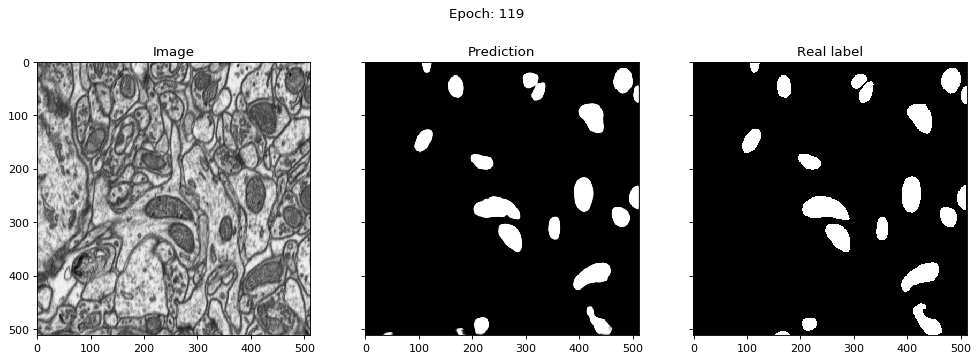

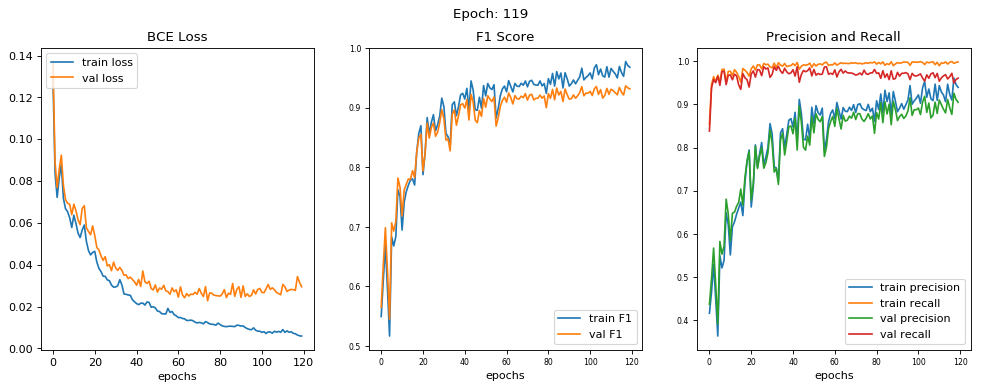

epoch [119/200] 
train loss = 0.0059, train f1 score = 0.9680 
train precision = 0.9395, train recall = 0.9984 

val loss = 0.0295, val f1 score = 0.9316 
val precision = 0.9049, val recall = 0.9609 




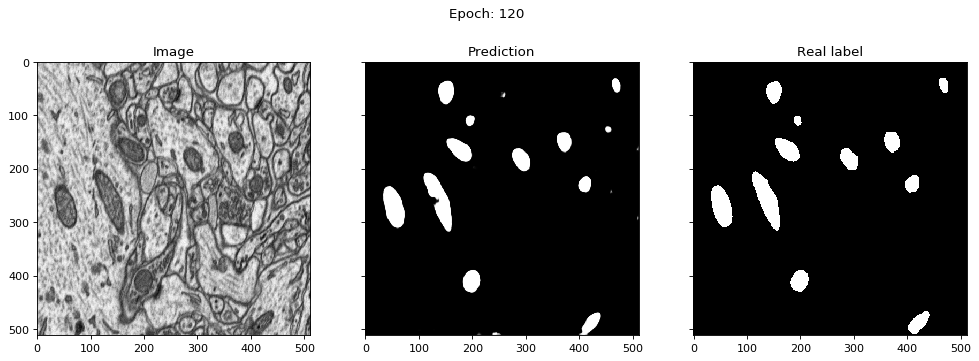

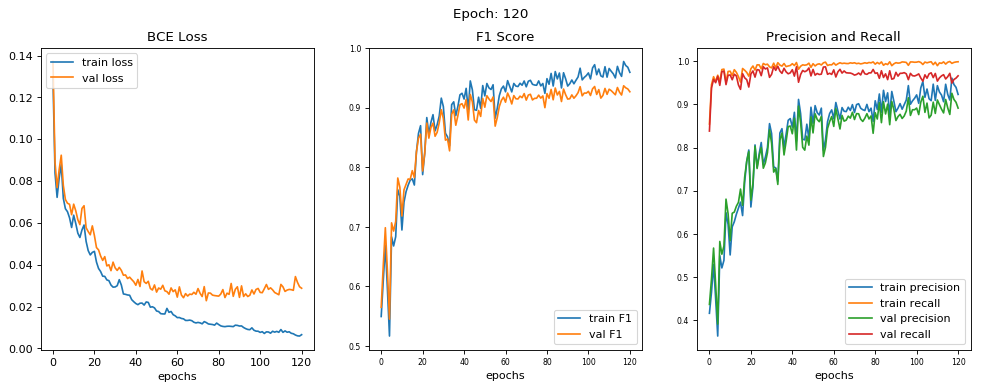

epoch [120/200] 
train loss = 0.0066, train f1 score = 0.9594 
train precision = 0.9231, train recall = 0.9988 

val loss = 0.0288, val f1 score = 0.9268 
val precision = 0.8914, val recall = 0.9662 




In [ ]:
# Prep GPU
GPU = torch.cuda.is_available()
print("GPU is {}enabled ".format(['not ', ''][GPU]))

batch_size = 1
n_epochs = 200


#unet(n_channels, n_classes, n_filters_start=64 )
un = unet(1,1)
if GPU: 
    un = un.cuda()

optimizer = torch.optim.Adam(un.parameters(), lr=0.01)
criterion = nn.BCELoss()




# split into training and validation set 
total_train_size = train_imgs.shape[0]
p = np.random.permutation(total_train_size)
train_imgs = train_imgs[p]
train_labels = train_labels[p]

val_size = int(0.9*total_train_size)

val_imgs = train_imgs[:val_size]
val_labels = train_labels[:val_size]

train_imgs = train_imgs[val_size:]
train_labels = train_labels[val_size:]

print("80/20 training/validation split")
print("total number of images = ",total_train_size)
print("training set size = ",len(train_labels))
print("val_size = ", len(val_labels))


# traning set

img_resize = 512
TrainDataset = Array_Dataset(train_imgs, train_labels, img_resize)
TrainDataLoader = DataLoader(TrainDataset,
                             batch_size=batch_size,
                             shuffle=True,
                             num_workers=4)

# validation set 
ValDataset = Array_Dataset(val_imgs, val_labels, img_resize, do_transform=False)
ValDataLoader = DataLoader(ValDataset,
                             batch_size=1,
                             shuffle=True,
                             num_workers=4)

for i, data in enumerate(TrainDataLoader):

        print("training image from batch %d" % i)
        
    

        imgs = np.array(data[0])
        labels = data[1]
       
        mask, nlabels = ndimage.label(labels[0])

        
        rand_cmap = ListedColormap(np.random.rand(256,3))

        labels_for_display = np.where(mask > 0, mask, np.nan)

        f, (ax1,ax2,ax3) = plt.subplots(1,3, sharey=True,figsize=(15,5), dpi=80)

        #original = (np.squeeze(imgs[0])+1)*127.0
        original = np.squeeze(imgs[0])
        

        ax1.imshow(original, cmap="gray")
        ax1.set_title("Original Image")
        ax1.axis('off')
        
        ax2.imshow(np.squeeze(labels[0]), cmap="gray")
        ax2.set_title("Ground Truth Mask")
        ax2.axis('off')
        
        ax3.imshow(original, cmap="gray")
        ax3.imshow(np.squeeze(labels_for_display), cmap=rand_cmap)
        ax3.set_title("Instance Segmentation (%d structures)"% nlabels)
        ax3.axis('off')
        

        plt.show()
        
        if i > 1: 
            break



output_dir = "./epfl_output/"
# run training 
#training(GPU, un,train_imgs, train_labels, val_imgs, val_labels, optimizer, criterion, n_epochs, batch_size)
training(GPU, TrainDataLoader, ValDataLoader, ValDataset, un, optimizer, criterion, n_epochs, batch_size, output_dir, warm_start=False)
